In [110]:
import os
import json
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from quickstats.plots import CorrelationPlot

basedir = "/pscratch/sd/c/chlcheng/projects/paws/outputs/train_results/param_supervised/high_level/qq/SR_var_3_5_6_noise_0_v1/split_0"
filenames = {
    'truth': {
        "inferred": os.path.join(basedir, "prior_ratio_dataset_inferred.json"),
        "sampled": os.path.join(basedir, "prior_ratio_dataset_sampled.json")
    },
    'model': {
        'sampled': os.path.join(basedir, "full_train_prior_ratio_sampled.keras"),
        'inferred': os.path.join(basedir, "full_train_prior_ratio_inferred.keras")
    }
}
title_map = {
    'truth': {
        'inferred': r"Prior ratio from event number (sig = $W' \rightarrow qq$)",
        'sampled': r"Prior ratio from $E[F(x|y=0,\theta) / (1 -F(x|y=0,\theta))]$ (sig = $W' \rightarrow qq$) [train only]"
    },
    'model': {
        'inferred': r"Prior ratio learned from event number (sig = $W' \rightarrow qq$)",
        'sampled': r"Prior ratio learned from $E[F(x|y=0,\theta) / (1 -F(x|y=0,\theta))]$ (sig = $W' \rightarrow qq$) [train only]"
    },
    'relative': {
        'inferred': r"Relative prior ratio between expected and learned from event number (sig = $W' \rightarrow qq$)",
        'sampled': r"Relative rrior ratio between expected and learned from $E[F(x|y=0,\theta) / (1 -F(x|y=0,\theta))]$ (sig = $W' \rightarrow qq$) [train only]"
    }
}

In [111]:
def get_ratio_matrix_from_truth(filename: str):
    with open(filename, 'r') as file:
        data = json.load(file)
    data['x'] = np.array(data['x'])
    df = pd.DataFrame({
        'm1': data['x'][:, 0].astype(int),
        'm2': data['x'][:, 1].astype(int),
        'prior_ratio': data['y']
    })
    df_matrix = df.pivot(index='m2', columns='m1', values='prior_ratio')
    df_matrix = df_matrix.sort_index(axis=0, ascending=False)
    return df_matrix

def get_ratio_matrix_from_model(filename: str, mass_points: np.ndarray = None):
    model = ModelLoader.load_model(filename)
    if mass_points is None:
        masses = np.arange(50, 600 + 10, 10)
        m1, m2 = np.meshgrid(masses, masses)
        m1, m2 = m1.ravel(), m2.ravel()
        mass_points = np.column_stack((m1.ravel(), m2.ravel()))
    prior_ratios = model.predict(mass_points).flatten()
    df = pd.DataFrame({
        'm1': mass_points[:, 0],
        'm2': mass_points[:, 1],
        'prior_ratio': prior_ratios
    })
    df_matrix = df.pivot(index='m2', columns='m1', values='prior_ratio')
    df_matrix = df_matrix.sort_index(axis=0, ascending=False)
    return df_matrix

def get_relative_ratio_matrix(filename_json, filename_model):
    df_matrix_json = get_ratio_matrix_from_truth(filename_json)
    df_matrix_json = df_matrix_json.reset_index().melt(id_vars='m2', var_name='m1', value_name='prior_ratio')
    m1, m2 = df_matrix_json['m1'].values, df_matrix_json['m2'].values
    mass_points = np.column_stack((m1, m2)).astype('float')
    df_matrix_model = get_ratio_matrix_from_model(filename_model, mass_points)
    df_matrix_model = df_matrix_model.reset_index().melt(id_vars='m2', var_name='m1', value_name='prior_ratio')
    df = pd.DataFrame({
        'm1': m1,
        'm2': m2,
        'ratio': df_matrix_model['prior_ratio'] / df_matrix_json['prior_ratio']
    })
    df_matrix = df.pivot(index='m2', columns='m1', values='ratio')
    df_matrix = df_matrix.sort_index(axis=0, ascending=False)
    return df_matrix

def plot_ratio_matrix(df_matrix, vmin:float=-2, vmax:float=35, title=None):
    plotter = CorrelationPlot(df_matrix)
    ax = plotter.draw(vmin=vmin, vmax=vmax, xlabelpos='bottom', 
                      xlabel='$m_X$ [GeV]', ylabel='$m_Y$ [GeV]',
                      title=title)
    return ax

<Figure size 640x480 with 0 Axes>

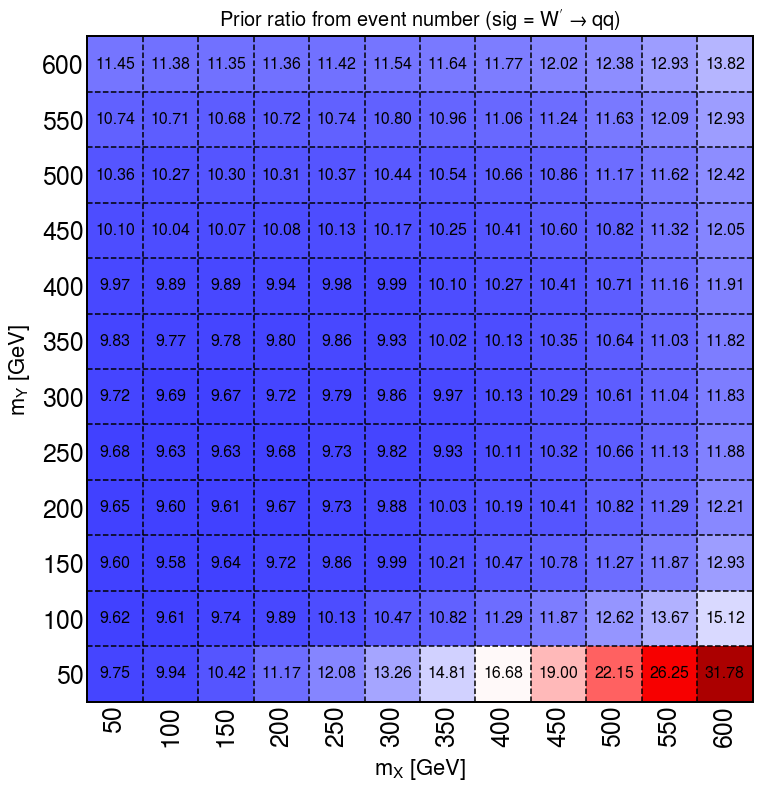

<Figure size 640x480 with 0 Axes>

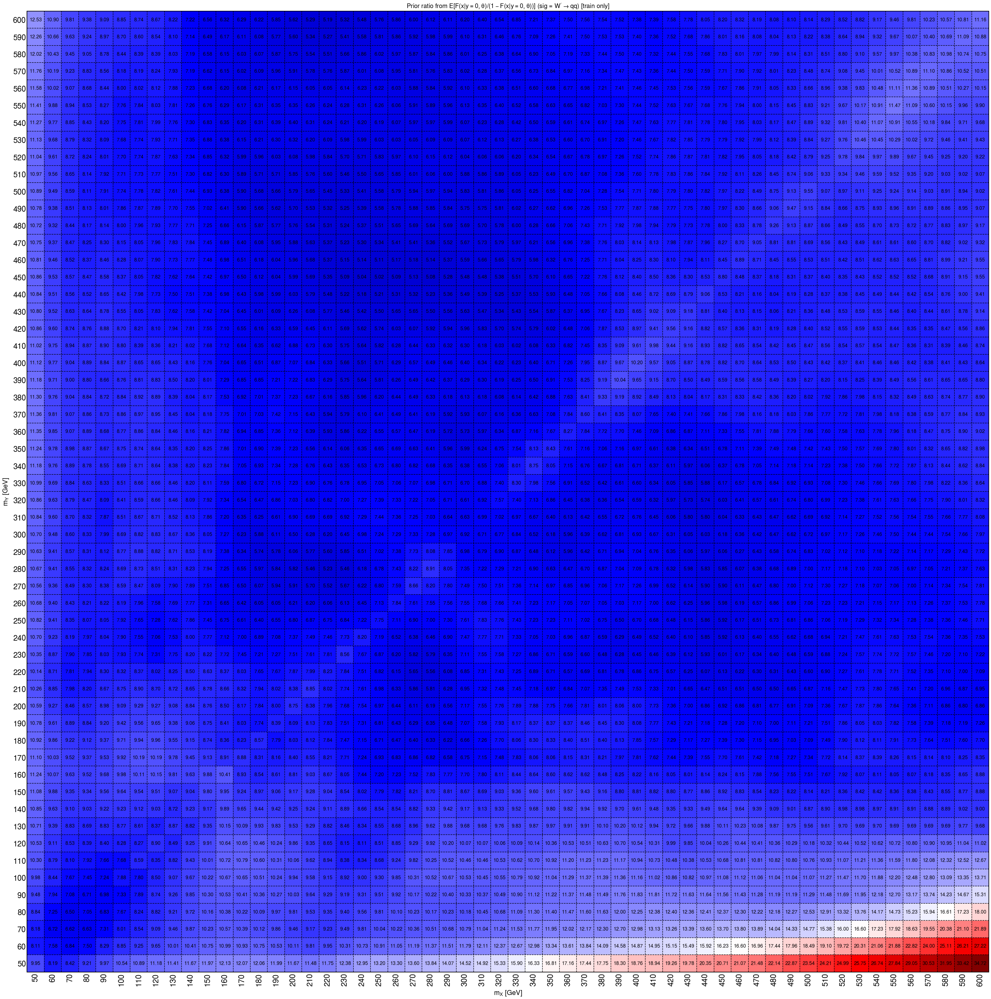

98/98 [==============================] - 0s 844us/step


<Figure size 640x480 with 0 Axes>

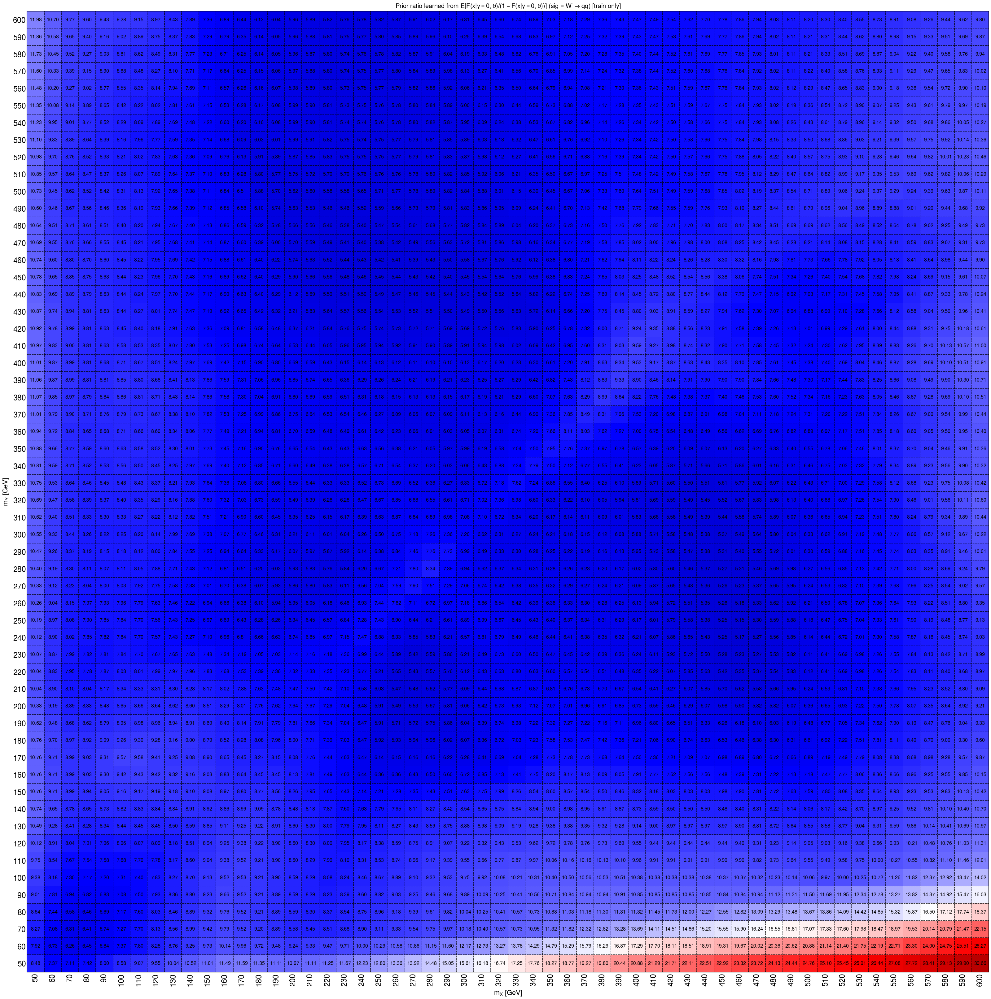

98/98 [==============================] - 0s 610us/step


<Figure size 640x480 with 0 Axes>

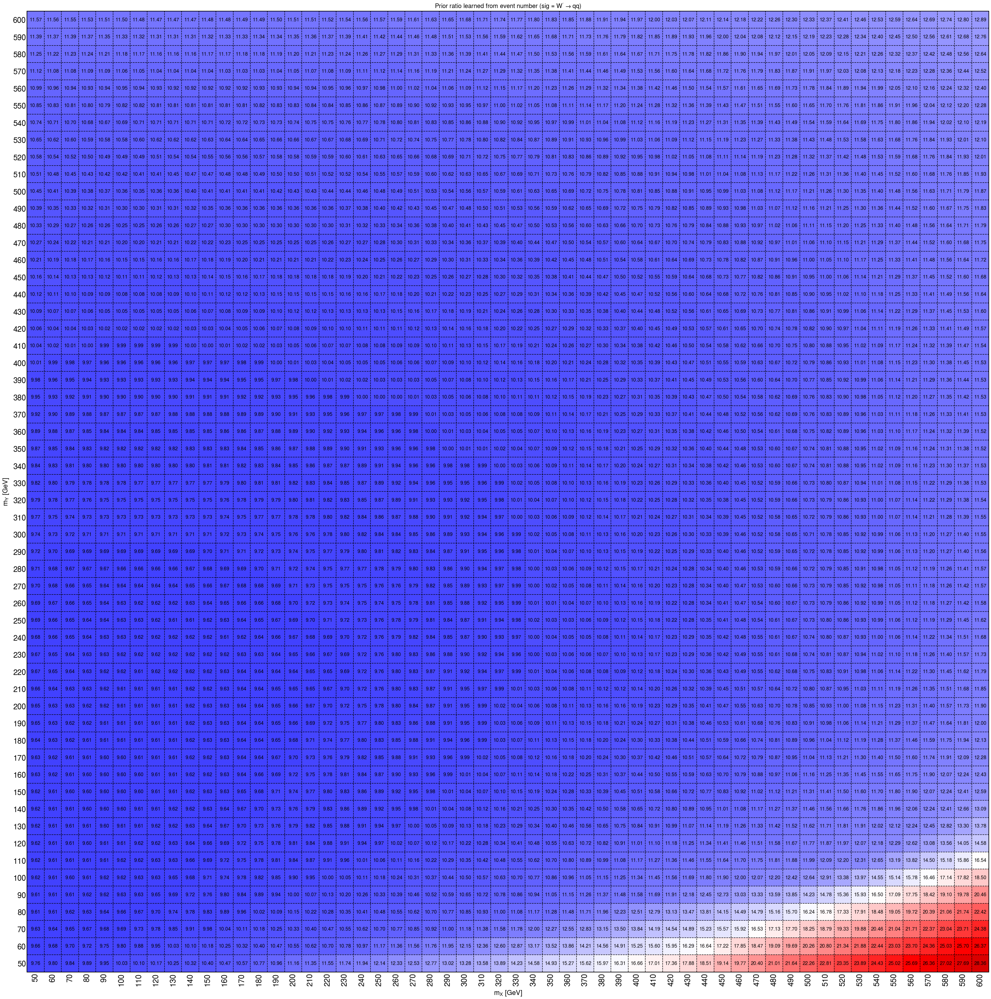

In [114]:
for category in filenames:
    if category == 'truth':
        fn = get_ratio_matrix_from_truth
    else:
        fn = get_ratio_matrix_from_model
    for scenario, filename in filenames[category].items():
        df_matrix = fn(filename)
        ax = plot_ratio_matrix(df_matrix, title=title_map[category][scenario])
        outname = f"plots/prior_ratio_qq_{category}_{scenario}.pdf"
        ax.figure.savefig(outname, bbox_inches='tight')
        plt.show()

5/5 [==============================] - 0s 963us/step


<Figure size 640x480 with 0 Axes>

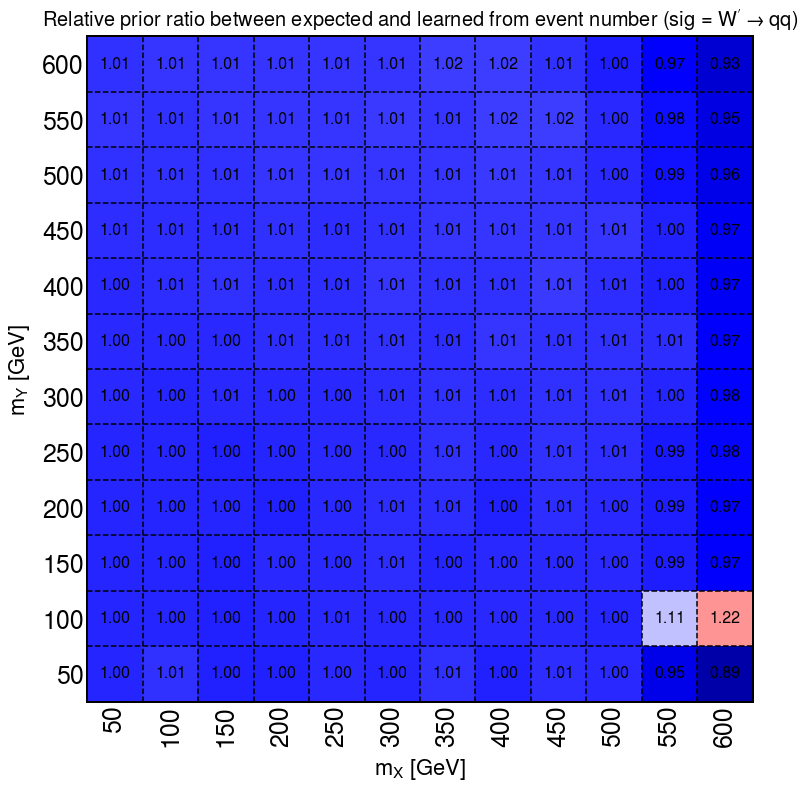

98/98 [==============================] - 0s 565us/step


<Figure size 640x480 with 0 Axes>

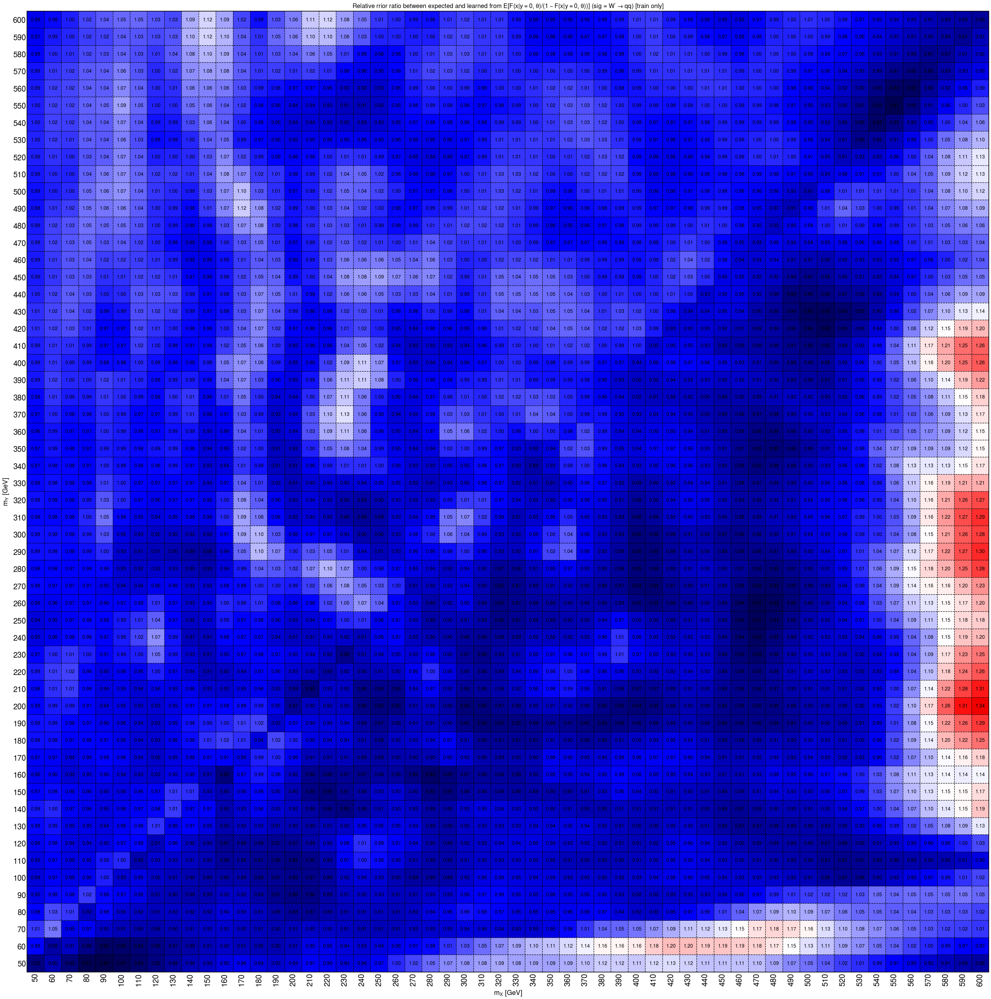

In [115]:
for scenario in ['inferred', 'sampled']:
    filename_json = filenames['truth'][scenario]
    filename_model = filenames['model'][scenario]
    df_matrix = get_relative_ratio_matrix(filename_json, filename_model)
    ax = plot_ratio_matrix(df_matrix, vmin=0.8, vmax=1.5, title=title_map['relative'][scenario])
    outname = f"plots/relative_prior_ratio_qq_{scenario}.pdf"
    ax.figure.savefig(outname, bbox_inches='tight')
    plt.show()

## Impact on Loss Landscapes

In [3]:
import numpy as np
import pandas as pd

from quickstats.maths.numerics import get_nbatch
from paws.components import ModelTrainer, ModelLoader, MetricLandscape

datadir = "/pscratch/sd/c/chlcheng/projects/paws/datasets"
outdir = "/pscratch/sd/c/chlcheng/projects/paws/outputs"

def get_components(m1: float, m2: float, mu: float, alpha: float):
    model_options = {
        "mass_point": [m1, m2],
        "mu": mu,
        "alpha": alpha
    }
    model_trainer = ModelTrainer("semi_weakly", model_options=model_options, decay_modes="qq,qqq",
                                 index_path="/pscratch/sd/c/chlcheng/projects/paws/semiweakly_dataset_indices.json",
                                 cache_test=True, variables="3,5,6", datadir=datadir, outdir=outdir)
    datasets = model_trainer.get_datasets()
    ws_model = model_trainer.get_model()
    fs_2_model = model_trainer.model_loader.fs_2_model
    fs_3_model = model_trainer.model_loader.fs_3_model

    # set to correct weight first
    weights = {
        'm1': m1 / 100,
        'm2': m2 / 100,
        'mu': np.log(mu),
        'alpha': alpha
    }
    
    ModelLoader.set_model_weights(ws_model, weights)
    
    x = np.concatenate([d[0][0] for d in datasets['train']])
    y_true = np.concatenate([d[1] for d in datasets['train']]).flatten()
    y_pred_2 = fs_2_model.predict(x, batch_size=1024).flatten()
    y_pred_3 = fs_3_model.predict(x, batch_size=1024).flatten()


    models = {
        'ws': ws_model,
        'fs2': fs_2_model,
        'fs3': fs_3_model,
        'prior_ratio': {
            'qq' : {},
            'qqq': {}
        }
    }
    
    outputs = {
        'x': x,
        'y_true': y_true,
        'y_pred_2': y_pred_2,
        'y_pred_3': y_pred_3
    }

    model_options = {
        'sampling_method': 'sampled'
    }
    
    qq_prior_trainer = ModelTrainer("prior_ratio", model_options=model_options, decay_modes="qq",
                                    cache_test=True, variables="3,5,6", datadir=datadir, outdir=outdir)
    
    qqq_prior_trainer = ModelTrainer("prior_ratio", model_options=model_options, decay_modes="qqq",
                                     cache_test=True, variables="3,5,6", datadir=datadir, outdir=outdir)
    models['prior_ratio']['qq']['sampled'] = qq_prior_trainer.load_trained_model()
    models['prior_ratio']['qqq']['sampled'] = qqq_prior_trainer.load_trained_model()
    
    model_options = {
        'sampling_method': 'inferred'
    }
    qq_prior_trainer = ModelTrainer("prior_ratio", model_options=model_options, decay_modes="qq",
                                    cache_test=True, variables="3,5,6", datadir=datadir, outdir=outdir)
    qqq_prior_trainer = ModelTrainer("prior_ratio", model_options=model_options, decay_modes="qqq",
                                     cache_test=True, variables="3,5,6", datadir=datadir, outdir=outdir)
    models['prior_ratio']['qq']['inferred'] = qq_prior_trainer.load_trained_model()
    models['prior_ratio']['qqq']['inferred'] = qqq_prior_trainer.load_trained_model()

    return models, outputs

def get_bce(y_true, y_pred_2, y_pred_3, mu, alpha, kappa_2=1.0, kappa_3=1.0, vectorize: bool = False):
    L2 = kappa_2 * y_pred_2 / (1 - y_pred_2)
    L3 = kappa_3 * y_pred_3 / (1 - y_pred_3)
    ws = (mu * (alpha * L3  + (1 - alpha) * L2 ) + 1 - mu) / (mu * (alpha * L3 + (1 - alpha) * L2) +2 - 2 *mu)
    axis = 1 if vectorize else None
    return (np.mean(-(y_true * np.log(ws) + (1 - y_true) * np.log(1 - ws)), axis=axis) - np.log(2)) * 1e5

def run_loss_scan(mu_arr, alpha_arr,
                  y_true, y_pred_2, y_pred_3,
                  kappa_2, kappa_3,
                  batchsize: int = 500):
    alpha_grid, mu_grid = np.meshgrid(alpha_arr, mu_arr)
    mu_grid = mu_grid.reshape(-1, 1)
    alpha_grid = alpha_grid.reshape(-1, 1)

    results = {
        'mu': np.array([]),
        'alpha': np.array([]),
        'loss': np.array([])
    }
    
    y_pred_2_all = None
    y_pred_3_all = None
    y_true_all = None
    nbatch = get_nbatch(mu_grid.shape[0], batchsize)
    for i in range(nbatch):
        print(f'Batch {i+1} / {nbatch}')
        mu_sub = mu_grid[i * batchsize : (i + 1) * batchsize]
        alpha_sub = alpha_grid[i * batchsize : (i + 1) * batchsize]
        if (y_pred_2_all is None) or (y_pred_2_all.shape[0] != mu_sub.shape[0]):
            y_pred_2_all = np.tile(y_pred_2, (mu_sub.shape[0], 1))
            y_pred_3_all = np.tile(y_pred_3, (mu_sub.shape[0], 1))
            y_true_all = np.tile(y_true, (mu_sub.shape[0], 1))
        losses = get_bce(y_true_all, y_pred_2_all, y_pred_3_all,
                         mu_sub, alpha_sub, kappa_2=kappa_2, kappa_3=kappa_3,
                         vectorize=True)
        results['mu'] = np.concatenate([results['mu'], mu_sub.flatten()])
        results['alpha'] = np.concatenate([results['alpha'], alpha_sub.flatten()])
        results['loss'] = np.concatenate([results['loss'], losses.flatten()])
    return results

def run_scenario(m1: float, m2: float, mu: float, alpha: float,
                 batchsize:int = 500):
    models, outputs = get_components(m1=m1, m2=m2, mu=mu, alpha=alpha)
    y_true = outputs['y_true']
    y_pred_2 = outputs['y_pred_2']
    y_pred_3 = outputs['y_pred_3']
    all_results = {
    }
    alpha_arr = np.arange(0, 1, 0.01)
    mu_arr = np.exp(np.arange(-8, -2, 0.1))
    
    kappa_2, kappa_3 = 1.0, 1.0
    print(f'Running with kappa_2 = {kappa_2}, kappa_3 = {kappa_3}')
    results = run_loss_scan(mu_arr=mu_arr, alpha_arr=alpha_arr,
                            y_true=y_true, y_pred_2=y_pred_2,
                            y_pred_3=y_pred_3, kappa_2=kappa_2,
                            kappa_3=kappa_3, batchsize=batchsize)
    all_results['no_kappa'] = results
    
    kappa_2, kappa_3 = 10., 10.
    print(f'Running with kappa_2 = {kappa_2}, kappa_3 = {kappa_3}')
    results = run_loss_scan(mu_arr=mu_arr, alpha_arr=alpha_arr,
                            y_true=y_true, y_pred_2=y_pred_2,
                            y_pred_3=y_pred_3, kappa_2=kappa_2,
                            kappa_3=kappa_3, batchsize=batchsize)
    all_results['uniform_kappa'] = results

    model_2, model_3 = models['prior_ratio']['qq']['inferred'], models['prior_ratio']['qqq']['inferred']
    kappa_2, kappa_3 = float(model_2.predict([[m1, m2]])[0]), float(model_3.predict([[m1, m2]])[0])
    print(f'Running with kappa_2 = {kappa_2}, kappa_3 = {kappa_3}')
    results = run_loss_scan(mu_arr=mu_arr, alpha_arr=alpha_arr,
                            y_true=y_true, y_pred_2=y_pred_2,
                            y_pred_3=y_pred_3, kappa_2=kappa_2,
                            kappa_3=kappa_3, batchsize=batchsize)
    all_results['inferred_kappa'] = results

    model_2, model_3 = models['prior_ratio']['qq']['sampled'], models['prior_ratio']['qqq']['sampled']
    kappa_2, kappa_3 = float(model_2.predict([[m1, m2]])[0]), float(model_3.predict([[m1, m2]])[0])
    print(f'Running with kappa_2 = {kappa_2}, kappa_3 = {kappa_3}')
    results = run_loss_scan(mu_arr=mu_arr, alpha_arr=alpha_arr,
                            y_true=y_true, y_pred_2=y_pred_2,
                            y_pred_3=y_pred_3, kappa_2=kappa_2,
                            kappa_3=kappa_3, batchsize=batchsize)
    all_results['sampled_kappa'] = results
    return all_results

In [4]:
results = run_scenario(m1=300, m2=300, mu=0.003, alpha=0.5)

> /tmp/ipykernel_110288/3315930735.py(18)get_components()
     16     from pdb import set_trace
     17     set_trace()
---> 18     model_trainer = ModelTrainer("semi_weakly", model_options=model_options, decay_modes="qq,qqq",
     19                                  index_path="/pscratch/sd/c/chlcheng/projects/paws/semiweakly_dataset_indices.json",
     20                                  cache_test=True, variables="3,5,6", datadir=datadir, outdir=outdir)



ipdb>  c


2024-10-06 15:34:30.153565: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-10-06 15:34:30.153599: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-10-06 15:34:30.155127: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-10-06 15:34:30.163415: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-10-06 15:34:31.580587: W tensorflow/compiler/tf2

INFO:tensorflow:Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:CPU:0',)


2024-10-06 15:34:32.821664: W tensorflow/core/common_runtime/gpu/gpu_device.cc:2256] Cannot dlopen some GPU libraries. Please make sure the missing libraries mentioned above are installed properly if you would like to use GPU. Follow the guide at https://www.tensorflow.org/install/gpu for how to download and setup the required libraries for your platform.
Skipping registering GPU devices...


[INFO] Created MirroredStrategy for distributed training
[INFO] Number of devices : 1
[INFO]      aliad version : 0.1.0
[INFO] tensorflow version : 2.15.0
Sun Oct  6 15:34:32 2024       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 525.105.17   Driver Version: 525.105.17   CUDA Version: 12.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  NVIDIA A100-PCI...  On   | 00000000:C3:00.0 Off |                    0 |
| N/A   73C    P0   249W / 250W |  29795MiB / 40960MiB |    100%      Default |
|                               |                      |             Disabled |
+------------

2024-10-06 15:34:45.277309: W tensorflow/core/framework/dataset.cc:959] Input of GeneratorDatasetOp::Dataset will not be optimized because the dataset does not implement the AsGraphDefInternal() method needed to apply optimizations.


360/360 [==============================] - 1s 2ms/step
INFO:tensorflow:Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:CPU:0',)
[INFO] Created MirroredStrategy for distributed training
[INFO] Number of devices : 1
[INFO]      aliad version : 0.1.0
[INFO] tensorflow version : 2.15.0
Sun Oct  6 15:34:47 2024       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 525.105.17   Driver Version: 525.105.17   CUDA Version: 12.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  NVIDIA A100-PCI...  On   | 00000000:C3:00.0 Off |                    0 |
| N/A   73C    P

/tmp/ipykernel_110288/3315930735.py:163: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  kappa_2, kappa_3 = float(model_2.predict([[m1, m2]])[0]), float(model_3.predict([[m1, m2]])[0])


Running with kappa_2 = 7.196715831756592, kappa_3 = 7.905728816986084
> /tmp/ipykernel_110288/3315930735.py(109)run_loss_scan()
    107     from pdb import set_trace
    108     set_trace()
--> 109     nbatch = get_nbatch(mu_grid.shape[0], batchsize)
    110     for i in range(nbatch):
    111         print(f'Batch {i+1} / {nbatch}')



ipdb>  mu_arr


array([0.00033546, 0.00037074, 0.00040973, 0.00045283, 0.00050045,
       0.00055308, 0.00061125, 0.00067554, 0.00074659, 0.0008251 ,
       0.00091188, 0.00100779, 0.00111378, 0.00123091, 0.00136037,
       0.00150344, 0.00166156, 0.0018363 , 0.00202943, 0.00224287,
       0.00247875, 0.00273944, 0.00302755, 0.00334597, 0.00369786,
       0.00408677, 0.00451658, 0.00499159, 0.00551656, 0.00609675,
       0.00673795, 0.00744658, 0.00822975, 0.00909528, 0.01005184,
       0.011109  , 0.01227734, 0.01356856, 0.01499558, 0.01657268,
       0.01831564, 0.02024191, 0.02237077, 0.02472353, 0.02732372,
       0.03019738, 0.03337327, 0.03688317, 0.0407622 , 0.0450492 ,
       0.04978707, 0.05502322, 0.06081006, 0.06720551, 0.07427358,
       0.082085  , 0.09071795, 0.10025884, 0.11080316, 0.12245643])


ipdb>  kappa_2]


*** SyntaxError: unmatched ']'


ipdb>  kappa_2, kappa_3


(7.196715831756592, 7.905728816986084)


ipdb>  np.exp(-5)


0.006737946999085467


ipdb>  get_bce(y_true, y_pred_2, y_pred_3, np.exp(-5), 0.5, kappa_2=kappa_2, kappa_3=kappa_3, vectorize=False)


-27.426138719632842


ipdb>  (get_bce(y_true, y_pred_2, y_pred_3, np.exp(-5), 0.5, kappa_2=kappa_2, kappa_3=kappa_3, vectorize=False) / 1e5) + np.log(2)


0.692872919172749


ipdb>  exit


In [ ]:
get_bce(y_true, y_pred_2, y_pred_3, np.exp(-5), 0.5, kappa_2=kappa_2, kappa_3=kappa_3, vectorize=False)

In [ ]:
(get_bce(y_true, y_pred_2, y_pred_3, np.exp(-5), 0.5, kappa_2=kappa_2, kappa_3=kappa_3, vectorize=False) / 1e5) + np.log(2)

### Loss Landscapes

In [4]:
import os
import glob
import json
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from quickstats.plots import General2DPlot
from quickstats.maths.numerics import str_encode_value

basedir = "/pscratch/sd/c/chlcheng/projects/paws/outputs/prior_ratio_test"
filenames = glob.glob(os.path.join(basedir, "*.json"))

def plot_loss_landscape(filename:str):
    with open(filename, 'r') as file:
        data = json.load(file)
    dfs = {}
    for key, data_i in data.items():
        if key == 'truth':
            continue
        dfs[key] = pd.DataFrame(data_i)
        dfs[key] = dfs[key].sort_values('loss').reset_index(drop=True)

    styles = {
        'legend': {
            'loc': (0.7, 0.8)
        }
    }
    config = {
        'num_grid_points': 1000
    }
    
    scenario_map = {
        'no_kappa': '$\kappa = 1$',
        'uniform_kappa': '$\kappa = 10$',
        'inferred_kappa': '$\kappa$ learned from event number',
        'sampled_kappa': '$\kappa$ learned from likelihood expectation'
    }
    
    for key, df in dfs.items():
        df['mu_log'] = np.log(df['mu'])
        plotter = General2DPlot(df, styles=styles, config=config)
        
        zmin = round(df['loss'].min())
        zmax = df['loss'].quantile(0.24)

        marker_styles = {
            'predicted': {
                'linewidth': 0,
                'marker' : 'h',
                'markersize' : 10,
                'color' : 'None',
                'markeredgewidth': 2,
                'markeredgecolor' : 'r',
                'alpha': 0.7
            },
            'truth': {
                'linewidth': 0,
                'marker' : '^',
                'markersize' : 10,  'color' : 'None',
                'markeredgewidth': 2,
                'markeredgecolor' : 'r',
                'alpha': 0.7
            }
        }

        m1 = int(data['truth']['m1'])
        m2 = int(data['truth']['m2'])
        mu_truth = data['truth']['mu']
        log_mu_truth = np.log(mu_truth)
        alpha_truth = data['truth']['alpha']

        y_attrib = 'alpha'
        if mu_truth > 0.4:
            x_attrib = 'mu'
            xmin, xmax = 0.1, 0.8
            mu_truth_ = mu_truth
            xlabel = r'$\mathit{\mu}$'
        elif mu_truth > 0.1:
            x_attrib = 'mu'
            xmin, xmax = 0.1, 0.65
            mu_truth_ = mu_truth
            xlabel = r'$\mathit{\mu}$'
        else:
            x_attrib = 'mu_log'
            xmin, xmax = -8, -2
            mu_truth_ = log_mu_truth
            xlabel = r'$log(\mathit{\mu})$'

        best_mu = df[x_attrib].loc[0]
        best_alpha = df[y_attrib].loc[0]
        
        plotter.add_point(mu_truth_,
                          alpha_truth,
                          label='Truth',
                          styles=marker_styles['truth'])
        
        plotter.add_point(best_mu,
                          best_alpha,
                          label='Predicted',
                          styles=marker_styles['predicted'])

        title = (r'$\mathit{m_X}$ = ' + str(m1) 
                 + r' GeV, $\mathit{m_Y}$ = ' 
                 + str(m2) + r' GeV, $\mathit{\mu}_{inj}$ = '
                 + f'{data["truth"]["mu"] * 100 :.3g}%\n'
                 + scenario_map[key])
        ax = plotter.draw(x_attrib, y_attrib, 'loss', cmap='magma',
                          xlabel=xlabel, ylabel=r'$\mathit{\alpha}$',
                          zmin=zmin, zmax=zmax, logz=False,
                          xmin=xmin, xmax=xmax,
                          draw_colormesh=True,
                          title=title)
        outname = (f'plots/loss_landscapes/logloss_mu_{str_encode_value(mu_truth)}_alpha_'
                   f'{str_encode_value(alpha_truth)}_m1_{m1}_'
                   f'm2_{m2}_{key}_mu_alpha_scan.pdf')
        ax.figure.savefig(outname, bbox_inches='tight')
        plt.show()

<Figure size 640x480 with 0 Axes>

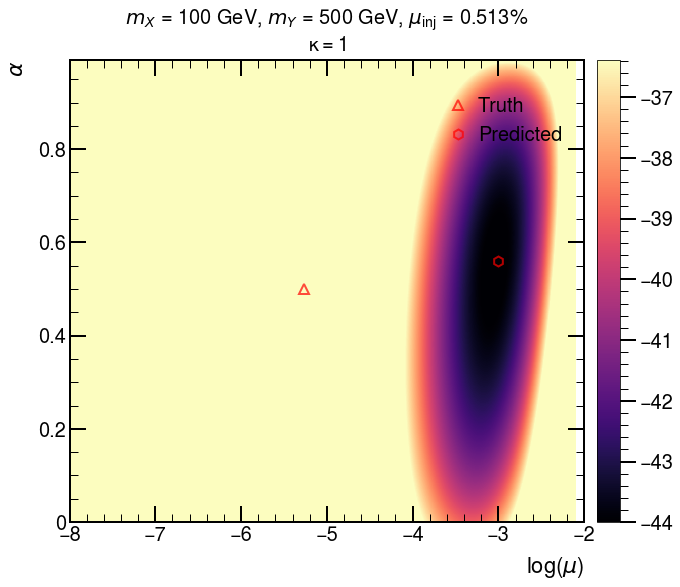

<Figure size 640x480 with 0 Axes>

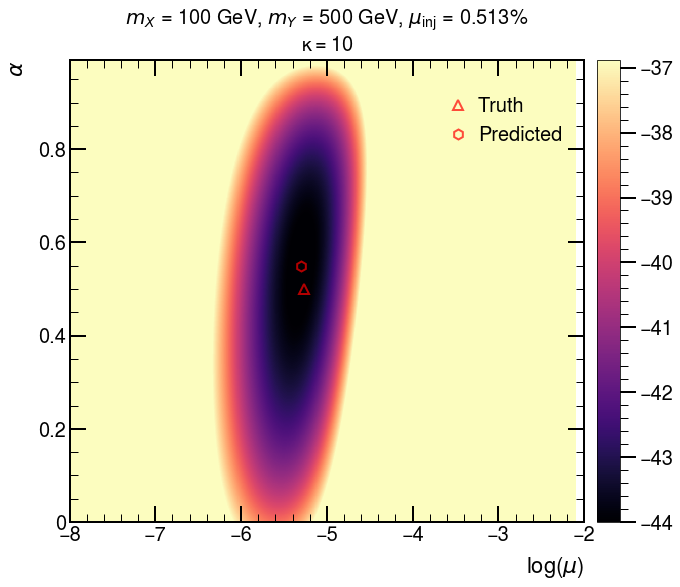

<Figure size 640x480 with 0 Axes>

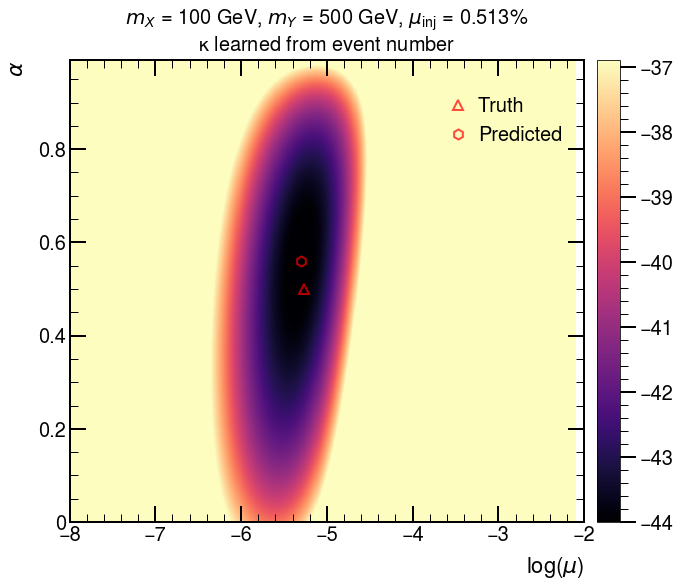

<Figure size 640x480 with 0 Axes>

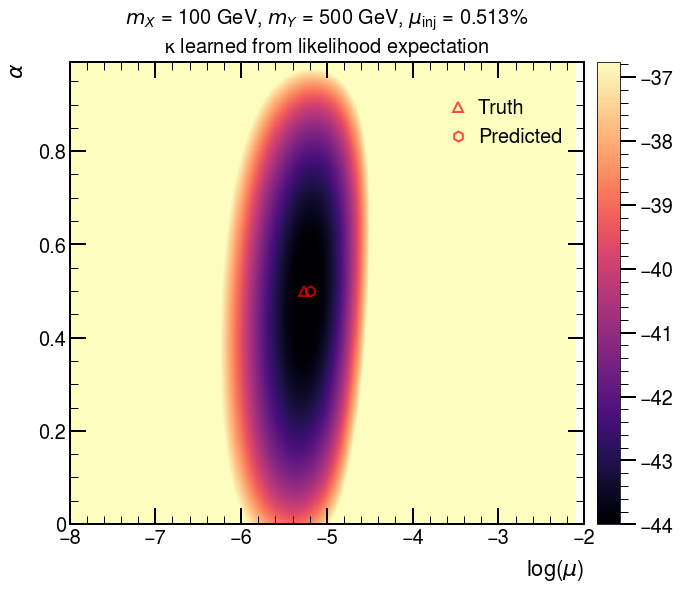

<Figure size 640x480 with 0 Axes>

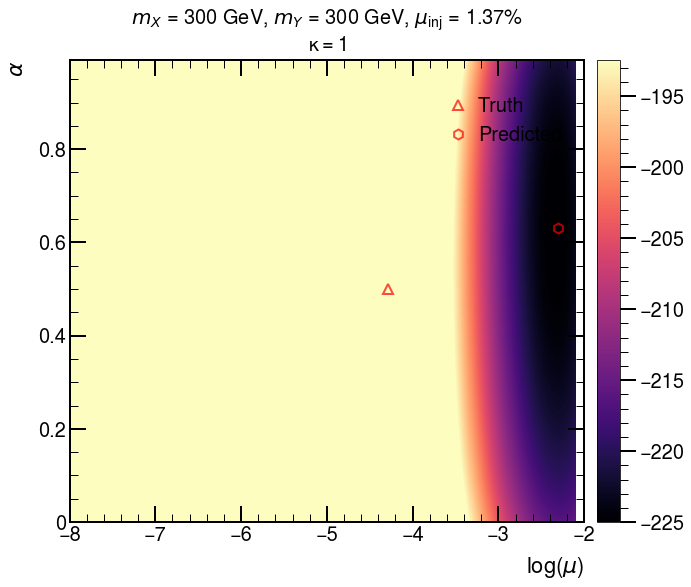

<Figure size 640x480 with 0 Axes>

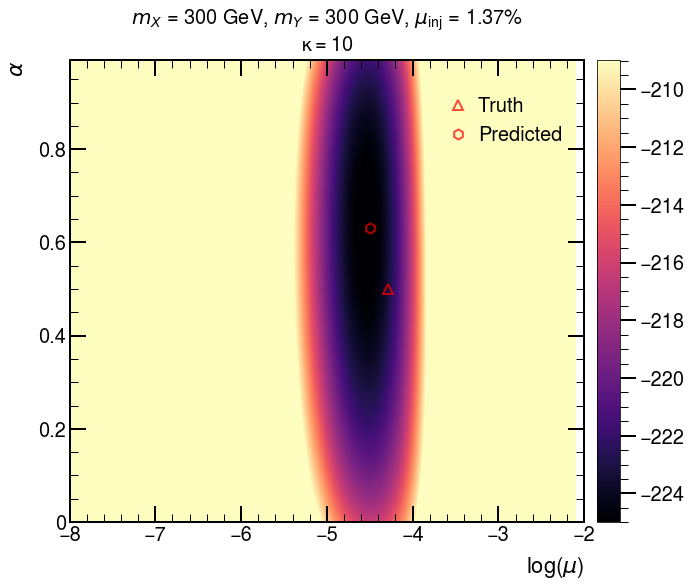

<Figure size 640x480 with 0 Axes>

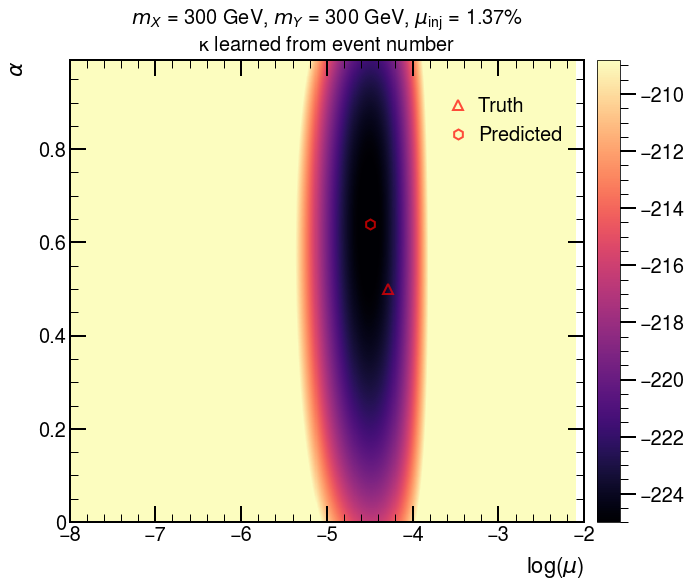

<Figure size 640x480 with 0 Axes>

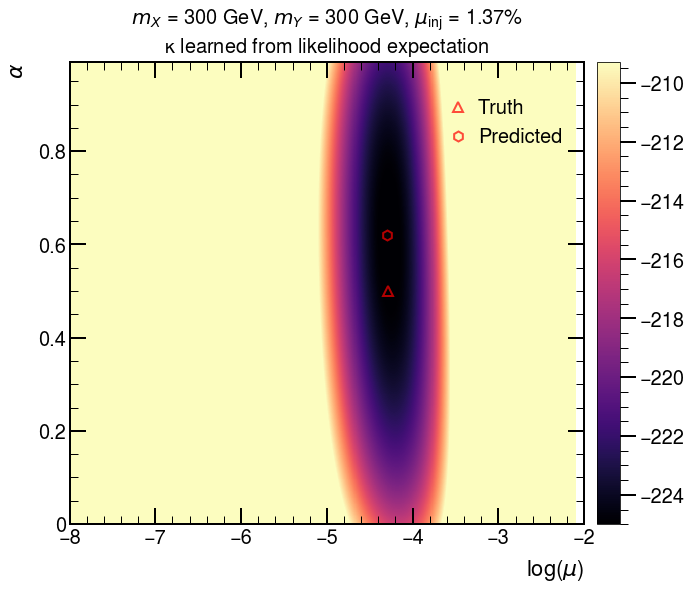

<Figure size 640x480 with 0 Axes>

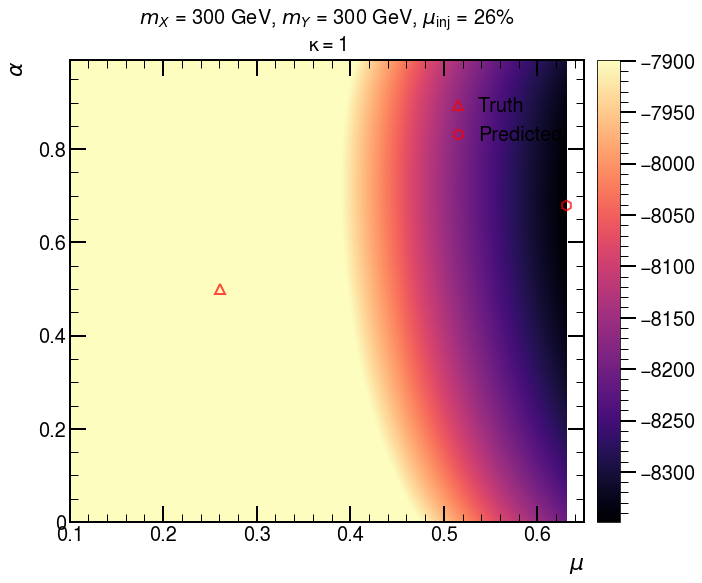

<Figure size 640x480 with 0 Axes>

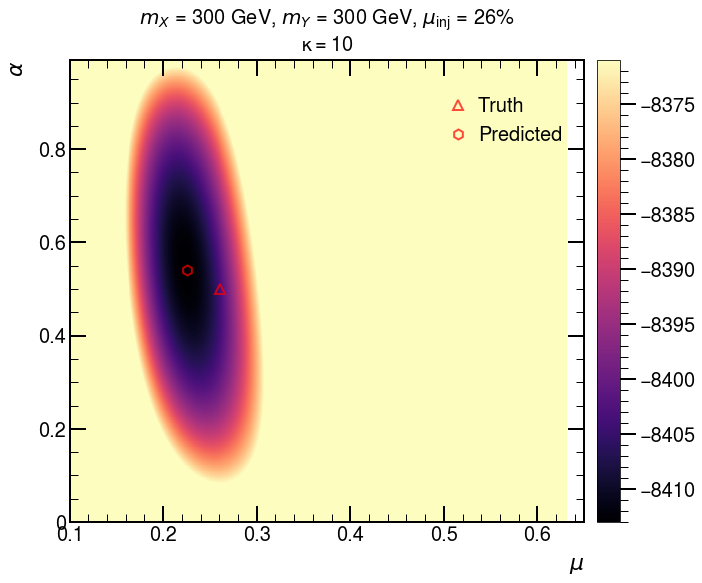

<Figure size 640x480 with 0 Axes>

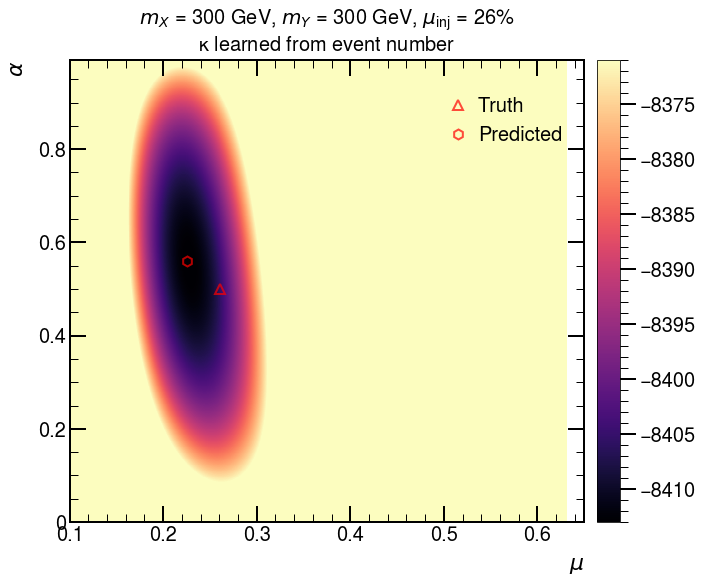

<Figure size 640x480 with 0 Axes>

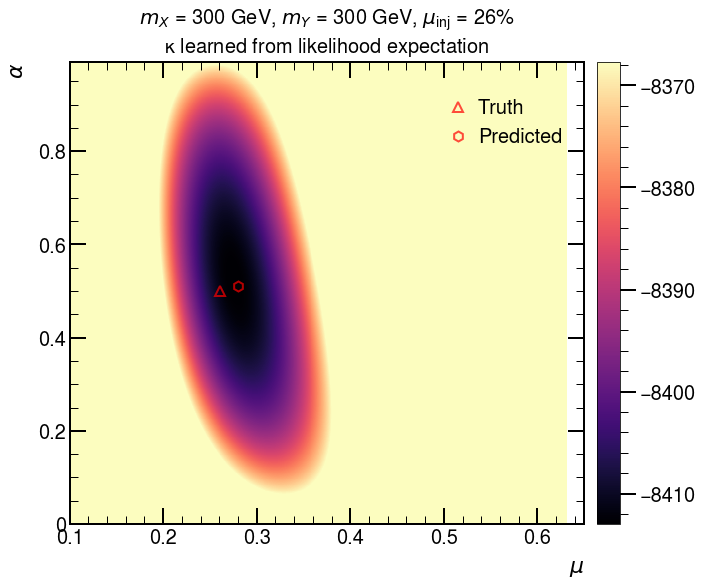

<Figure size 640x480 with 0 Axes>

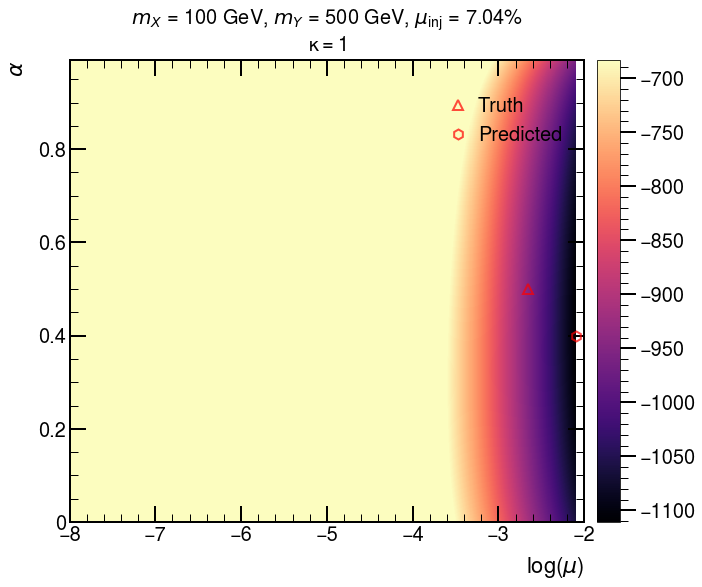

<Figure size 640x480 with 0 Axes>

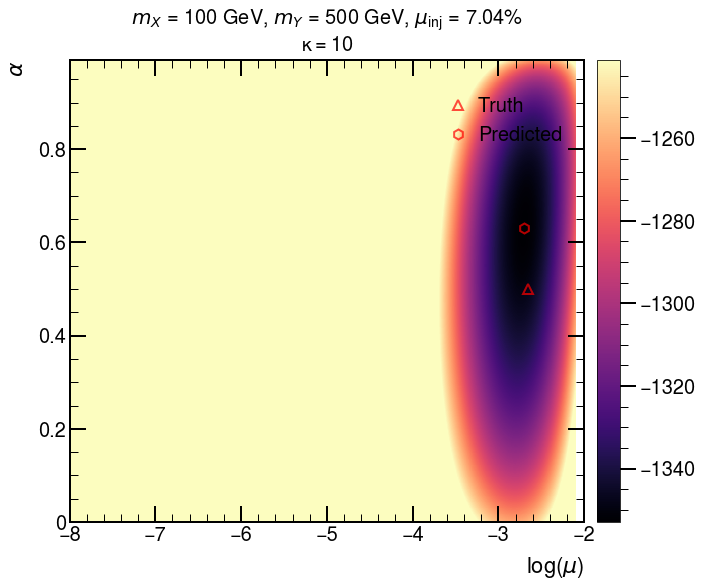

<Figure size 640x480 with 0 Axes>

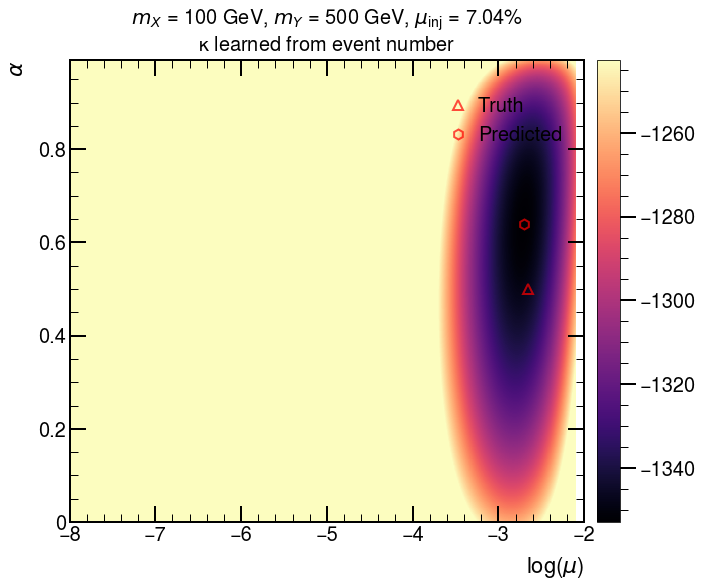

<Figure size 640x480 with 0 Axes>

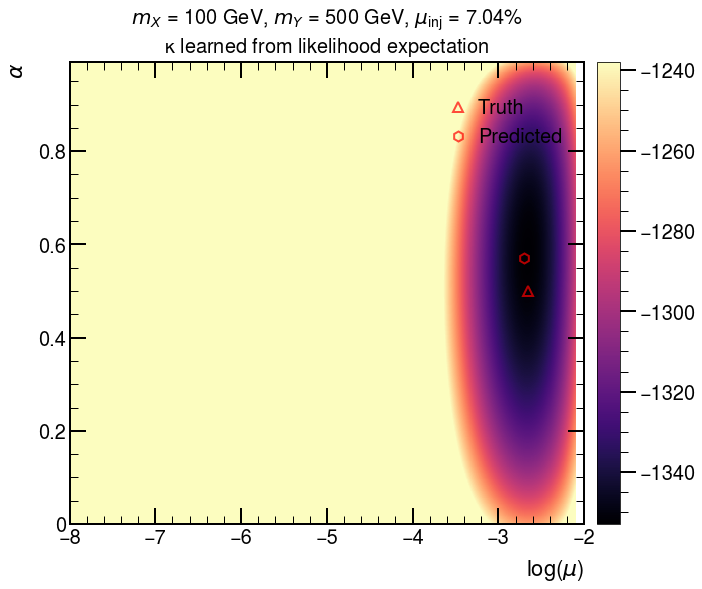

<Figure size 640x480 with 0 Axes>

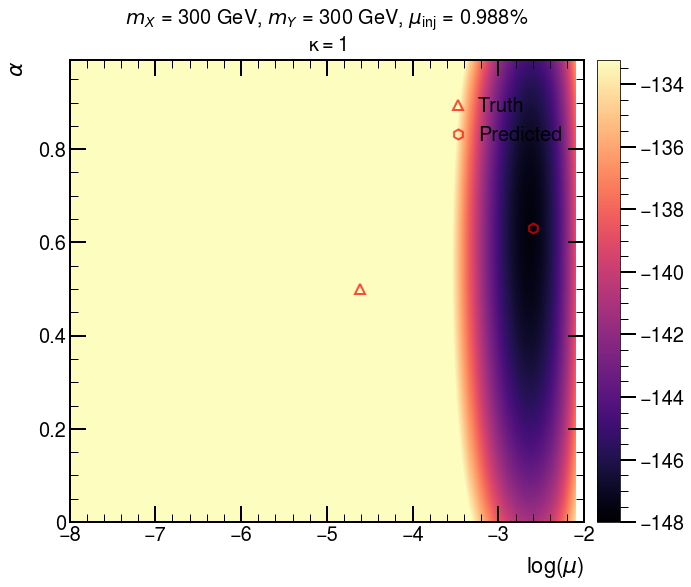

<Figure size 640x480 with 0 Axes>

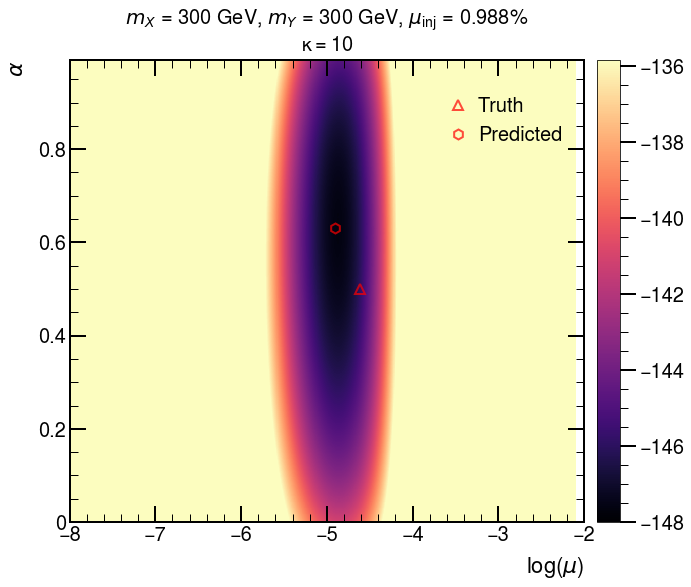

<Figure size 640x480 with 0 Axes>

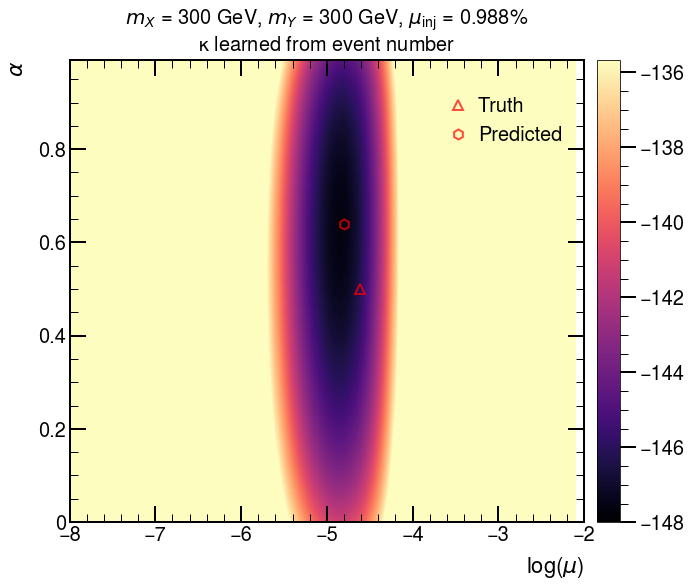

<Figure size 640x480 with 0 Axes>

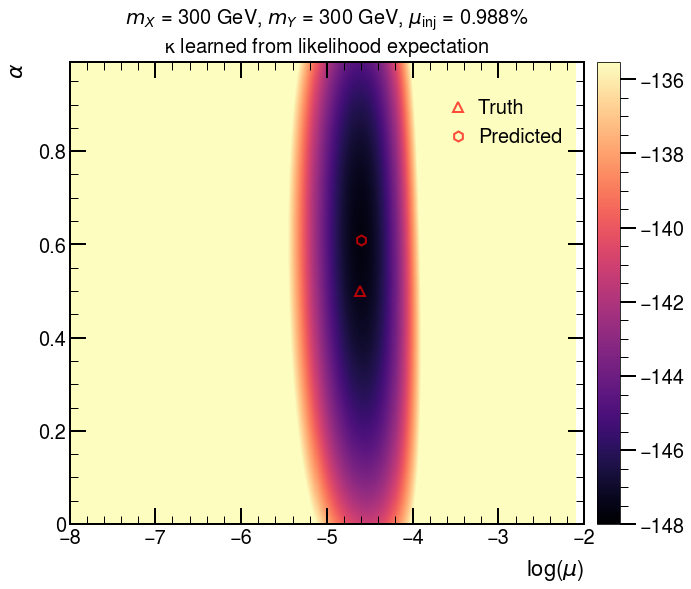

<Figure size 640x480 with 0 Axes>

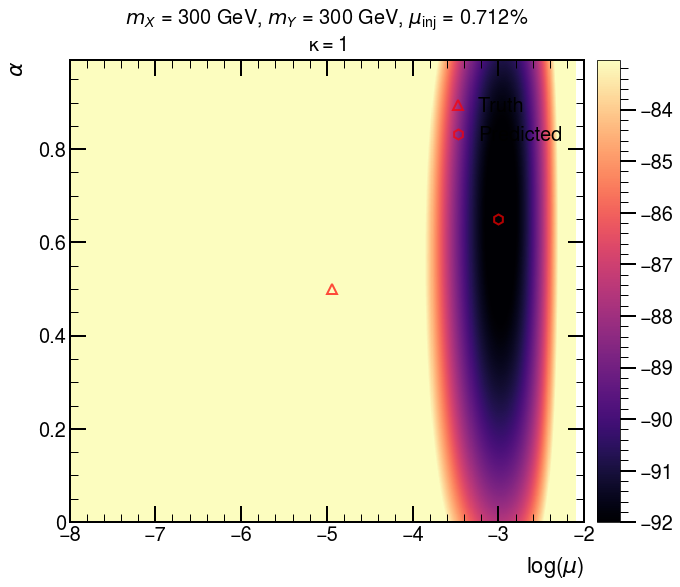

<Figure size 640x480 with 0 Axes>

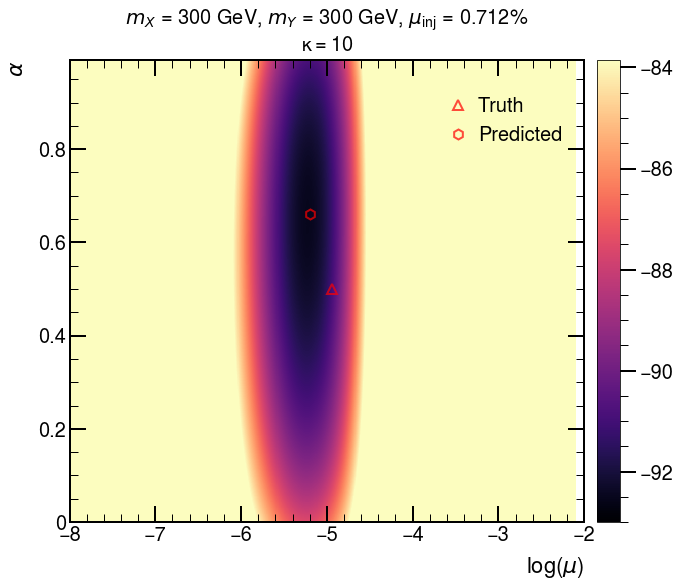

<Figure size 640x480 with 0 Axes>

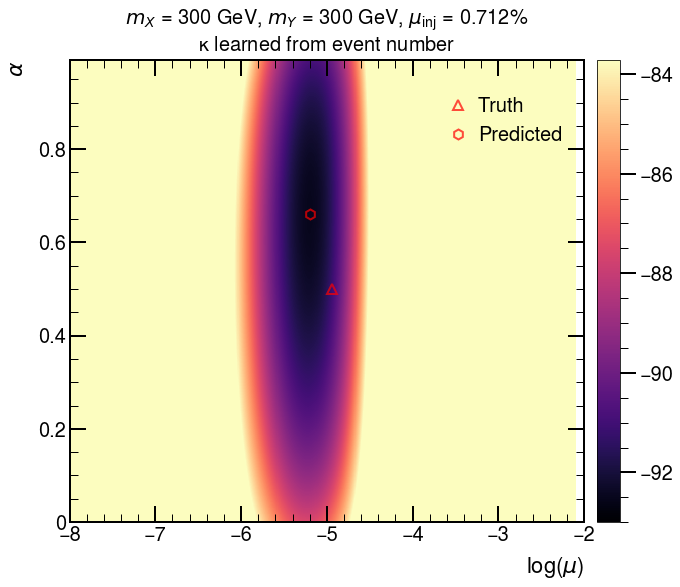

<Figure size 640x480 with 0 Axes>

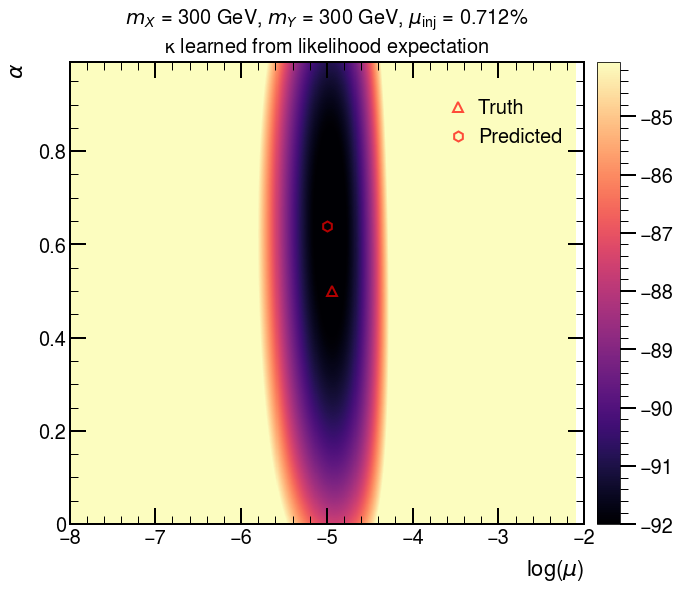

<Figure size 640x480 with 0 Axes>

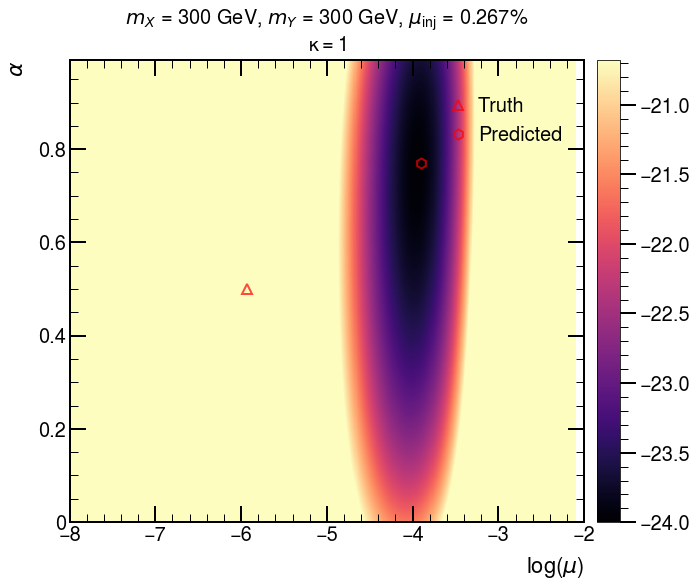

<Figure size 640x480 with 0 Axes>

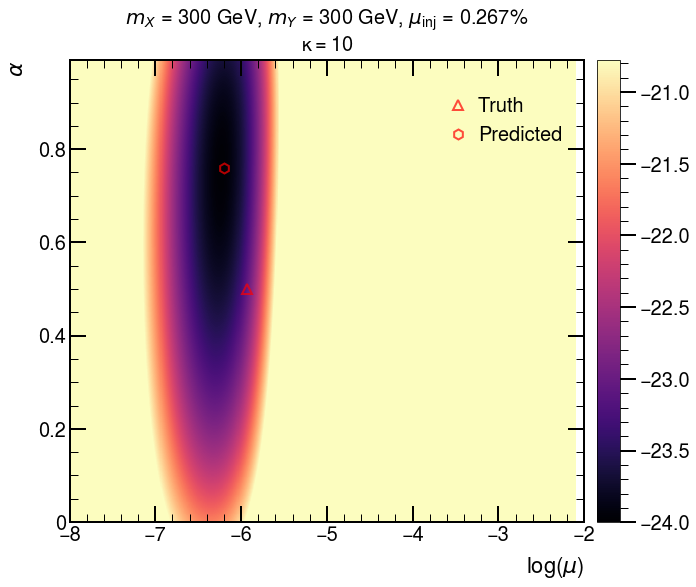

<Figure size 640x480 with 0 Axes>

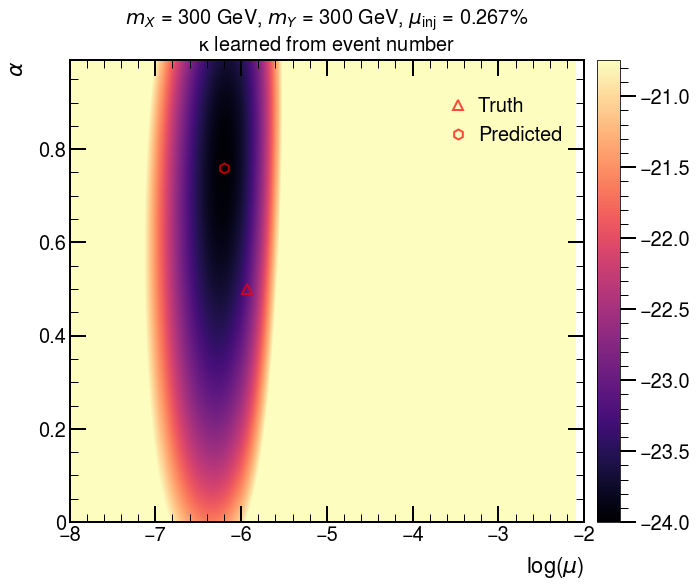

<Figure size 640x480 with 0 Axes>

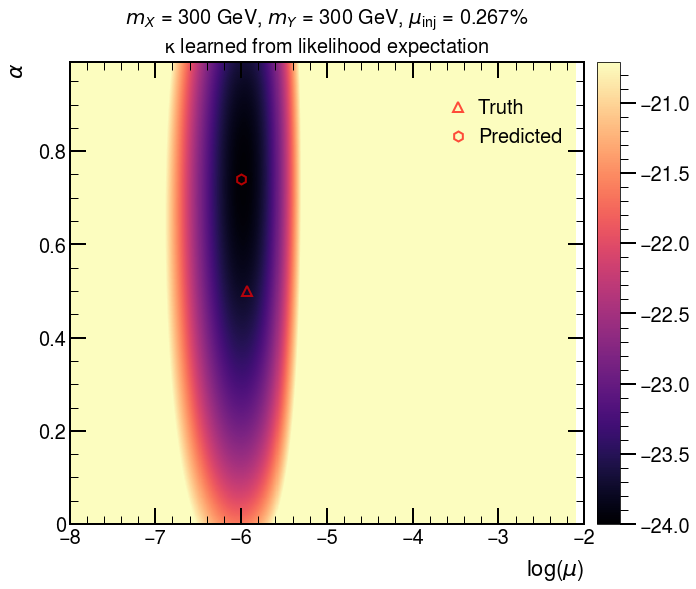

<Figure size 640x480 with 0 Axes>

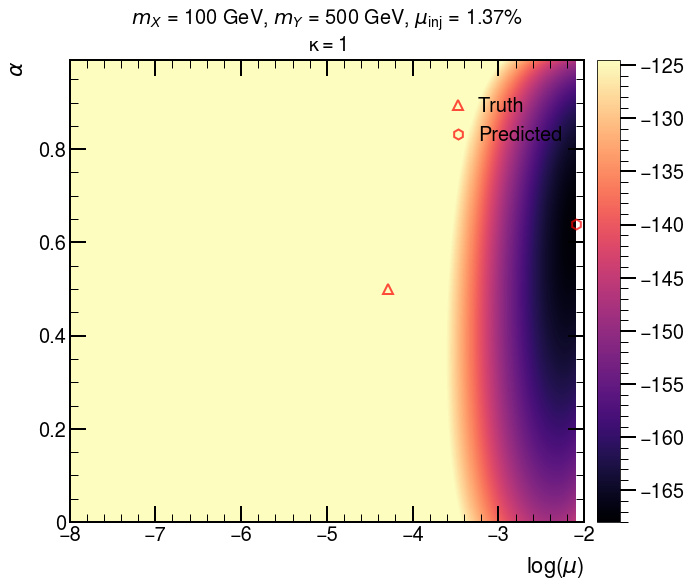

<Figure size 640x480 with 0 Axes>

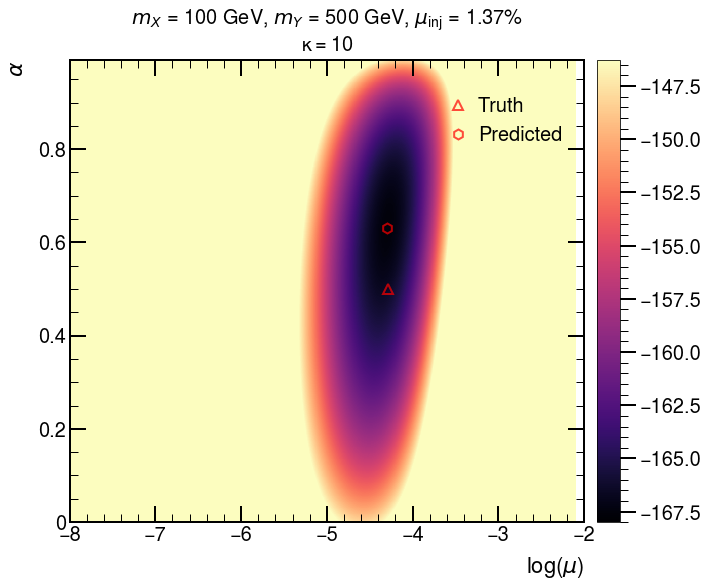

<Figure size 640x480 with 0 Axes>

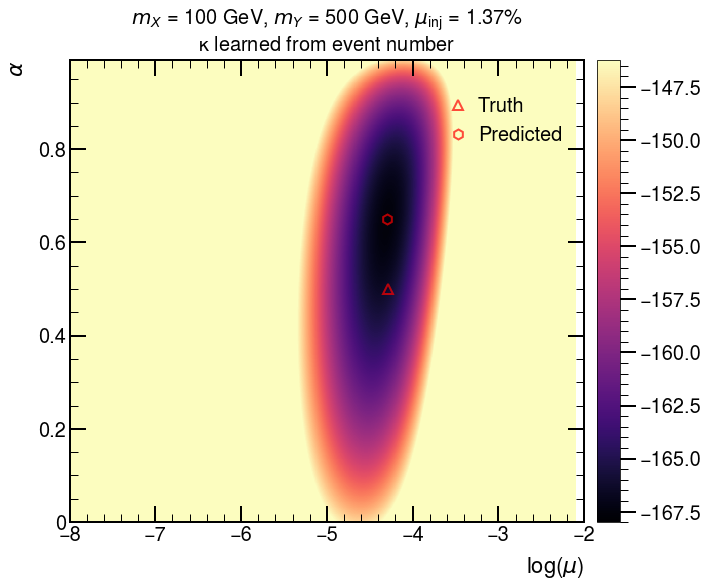

<Figure size 640x480 with 0 Axes>

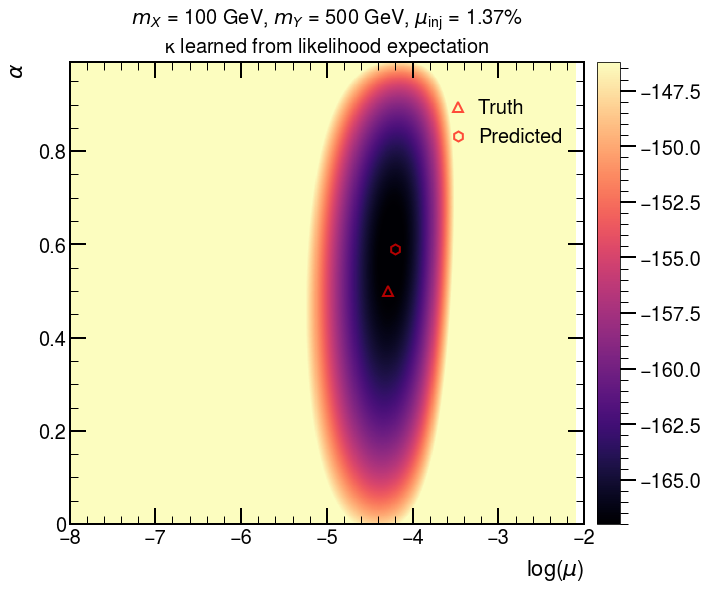

<Figure size 640x480 with 0 Axes>

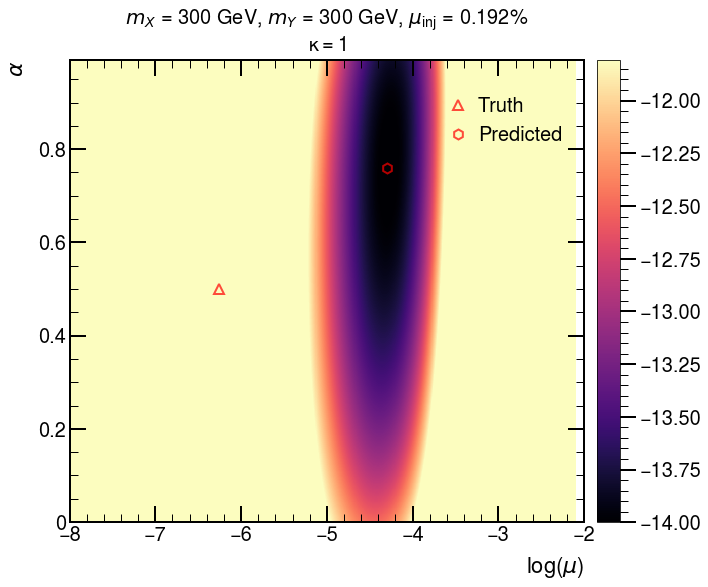

<Figure size 640x480 with 0 Axes>

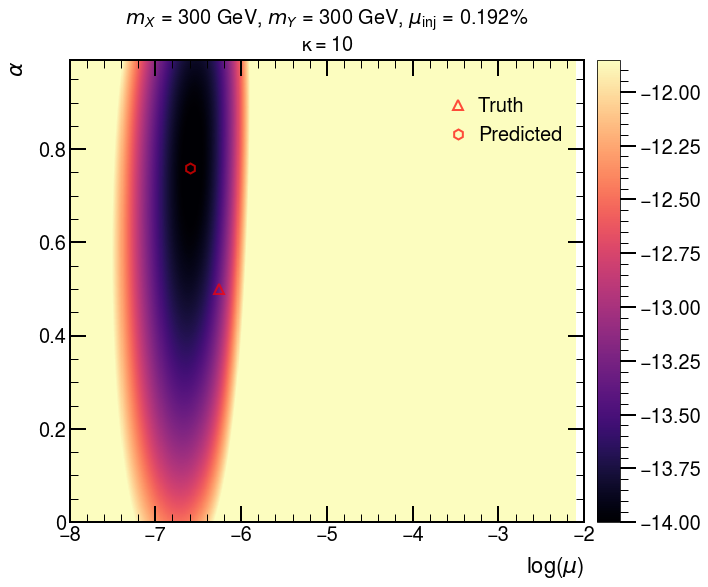

<Figure size 640x480 with 0 Axes>

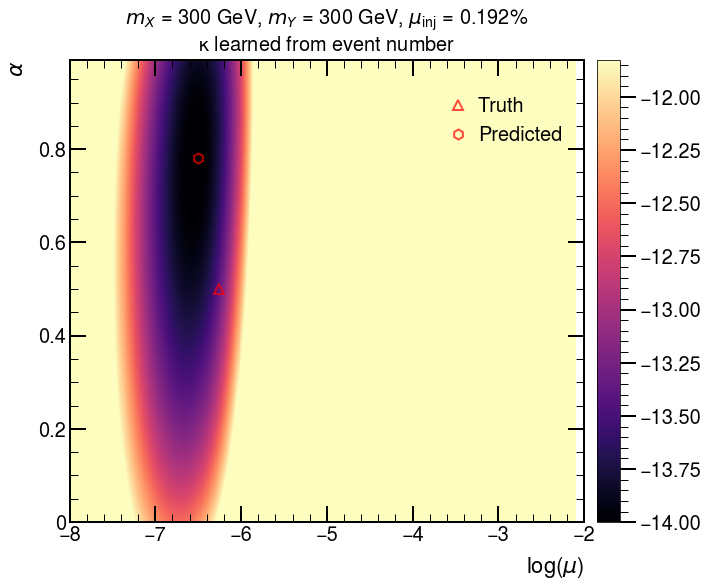

<Figure size 640x480 with 0 Axes>

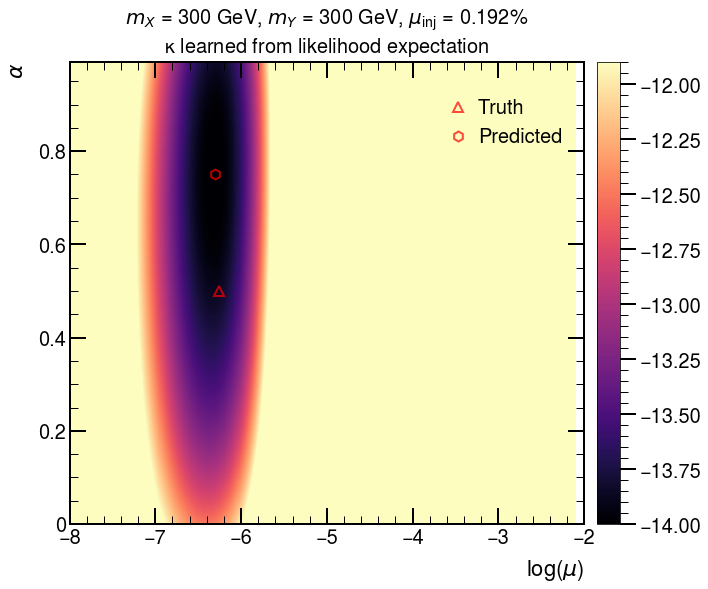

<Figure size 640x480 with 0 Axes>

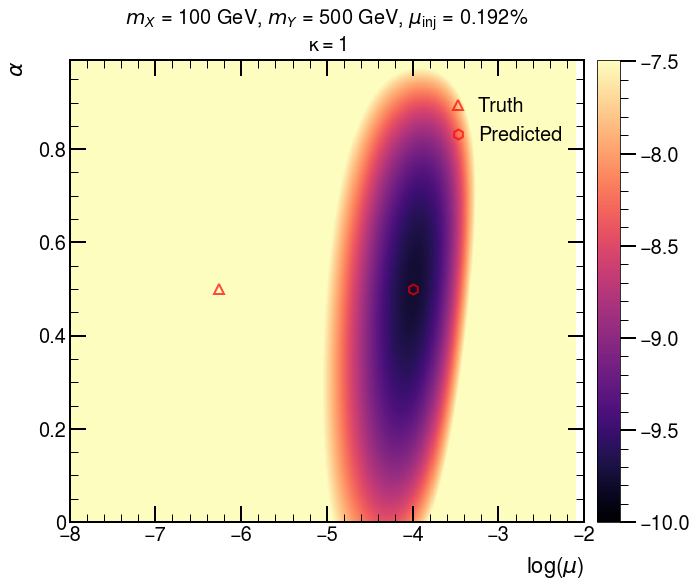

<Figure size 640x480 with 0 Axes>

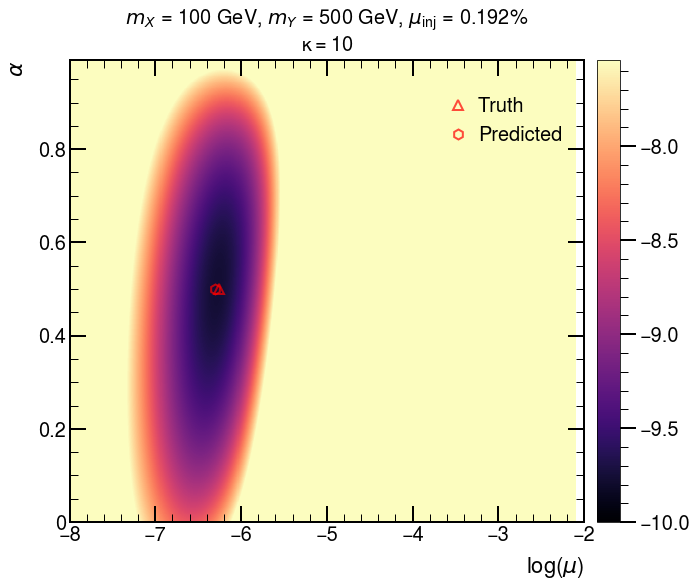

<Figure size 640x480 with 0 Axes>

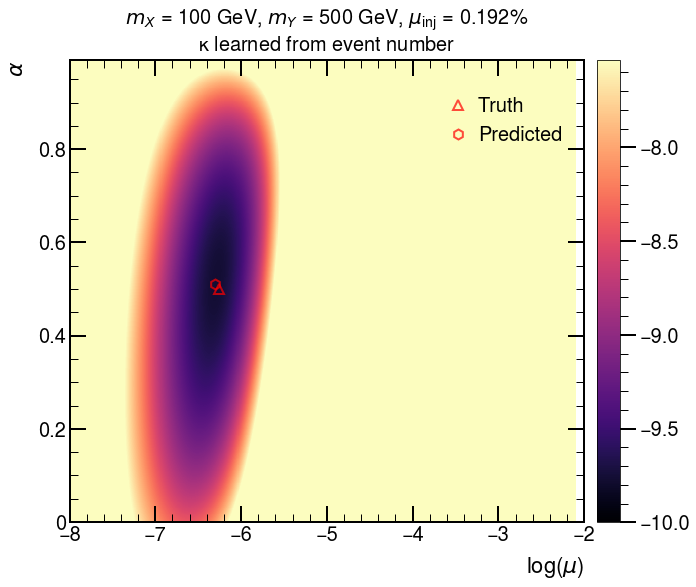

<Figure size 640x480 with 0 Axes>

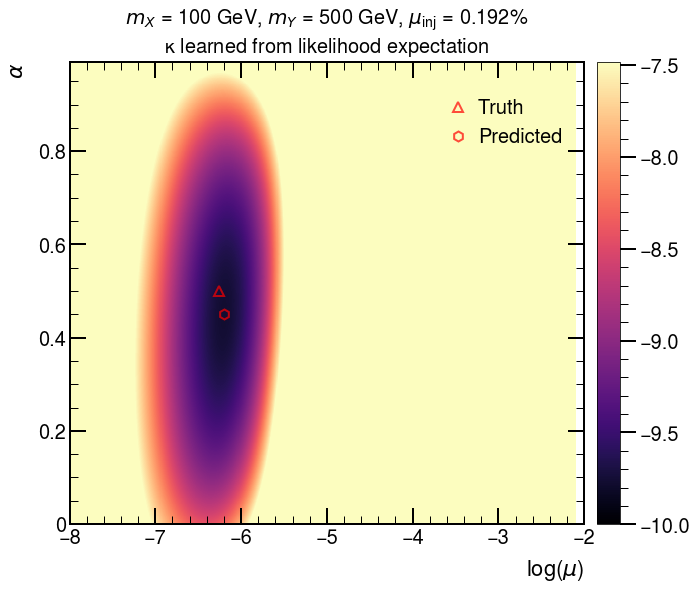

<Figure size 640x480 with 0 Axes>

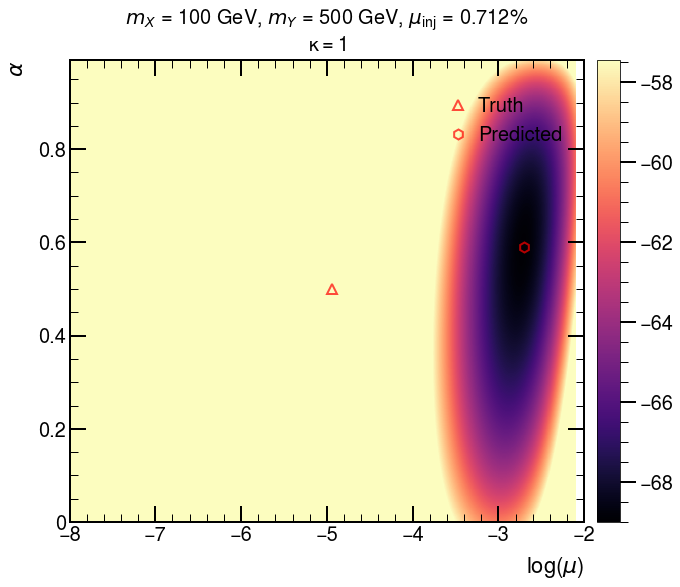

<Figure size 640x480 with 0 Axes>

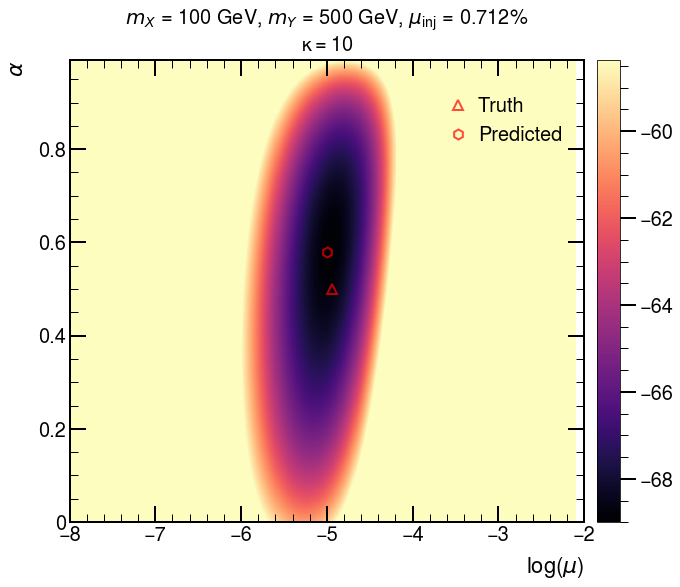

<Figure size 640x480 with 0 Axes>

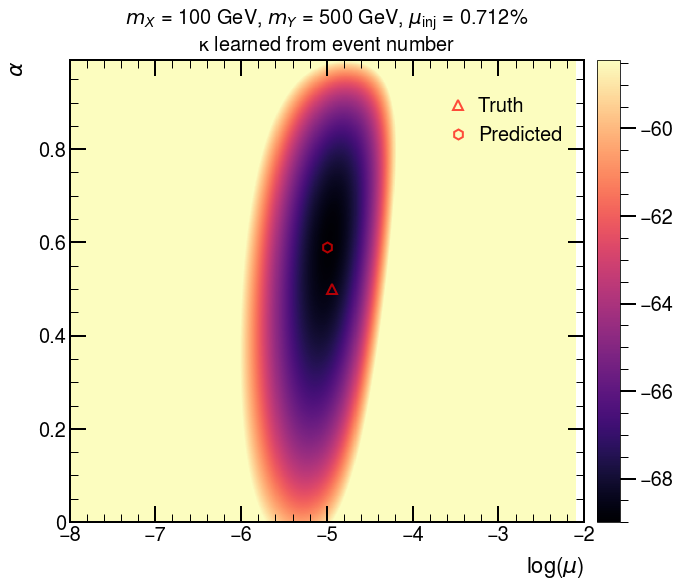

<Figure size 640x480 with 0 Axes>

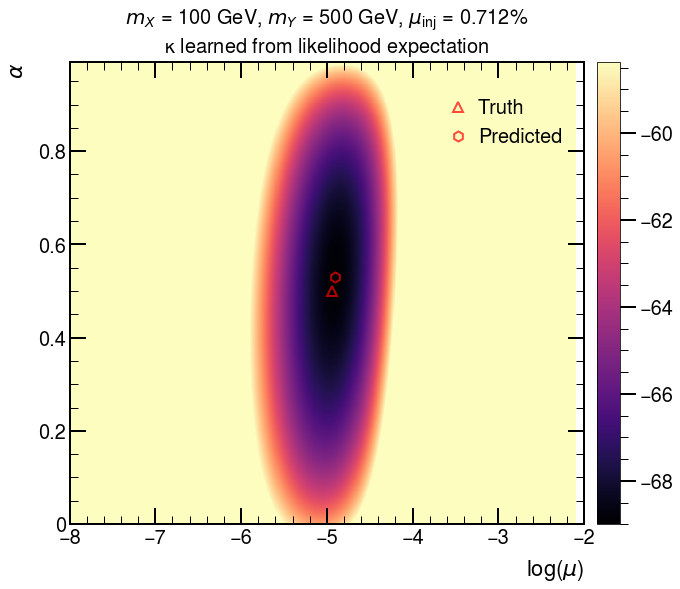

<Figure size 640x480 with 0 Axes>

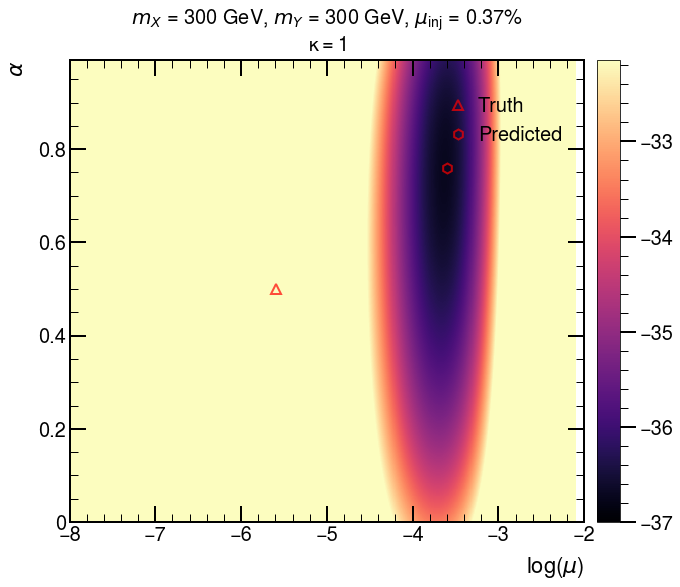

<Figure size 640x480 with 0 Axes>

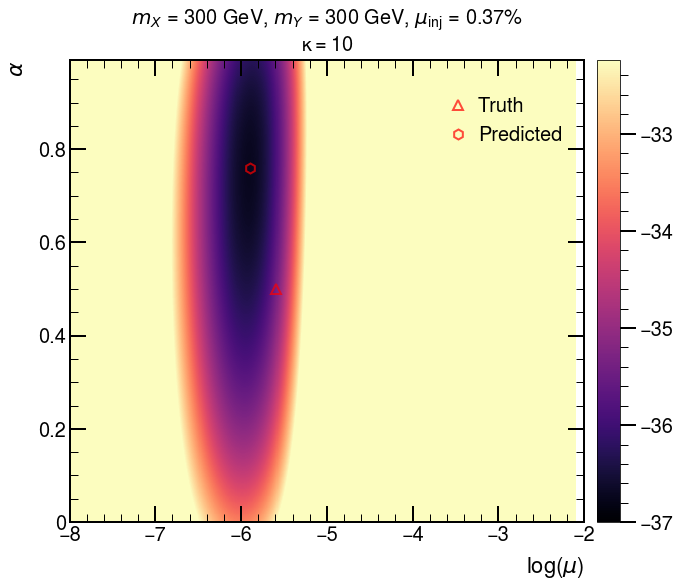

<Figure size 640x480 with 0 Axes>

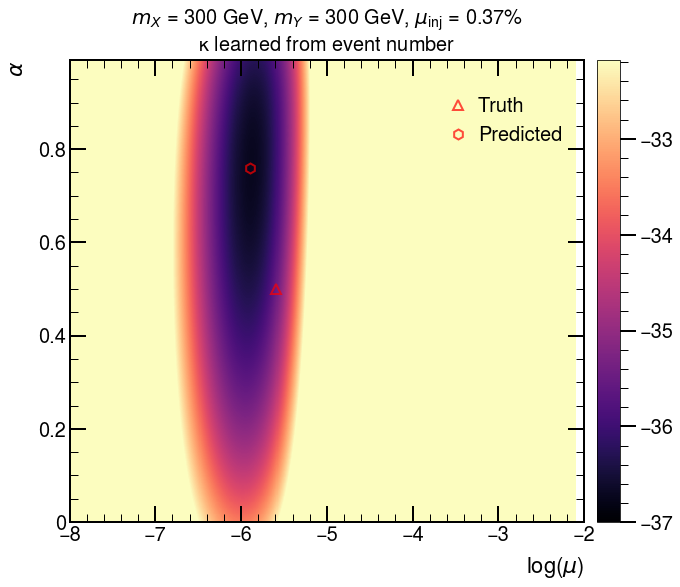

<Figure size 640x480 with 0 Axes>

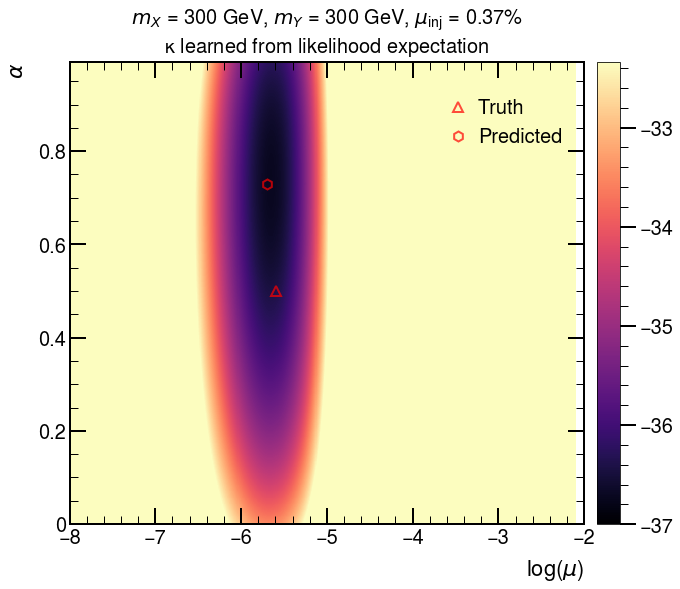

<Figure size 640x480 with 0 Axes>

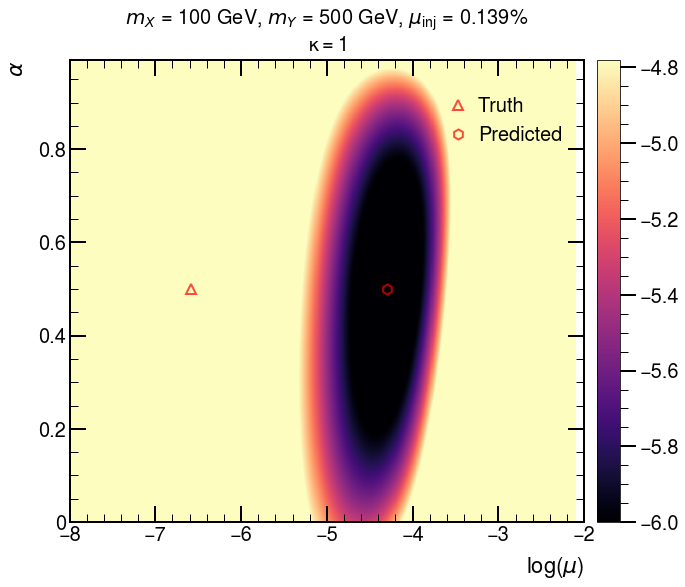

<Figure size 640x480 with 0 Axes>

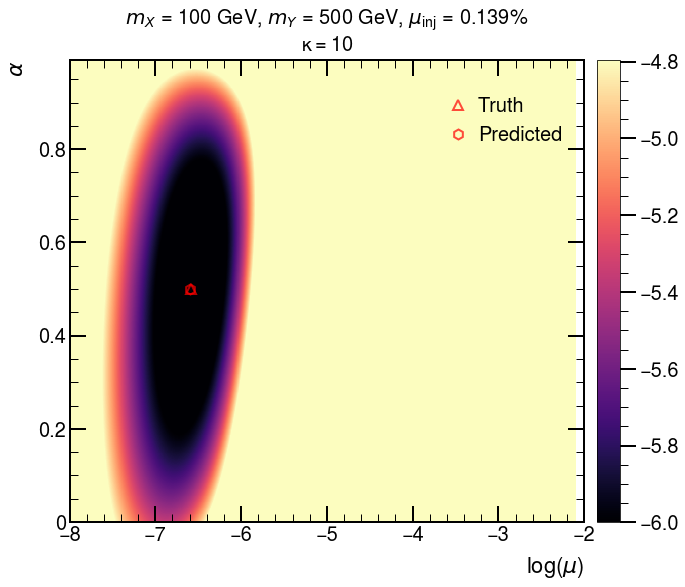

<Figure size 640x480 with 0 Axes>

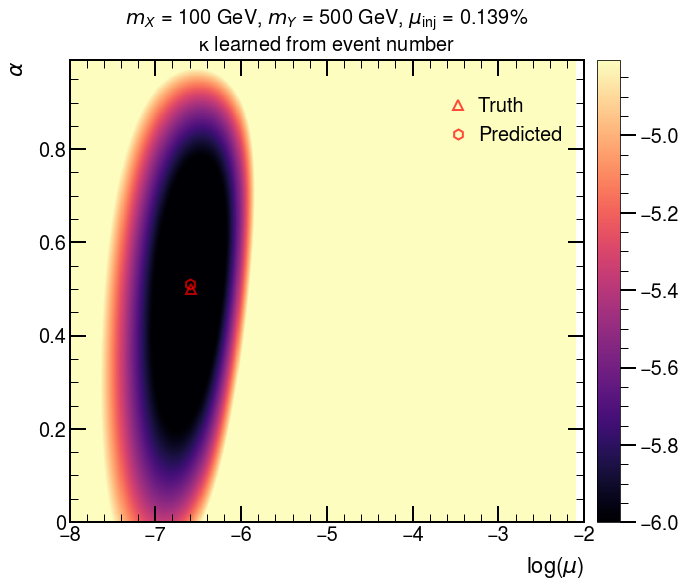

<Figure size 640x480 with 0 Axes>

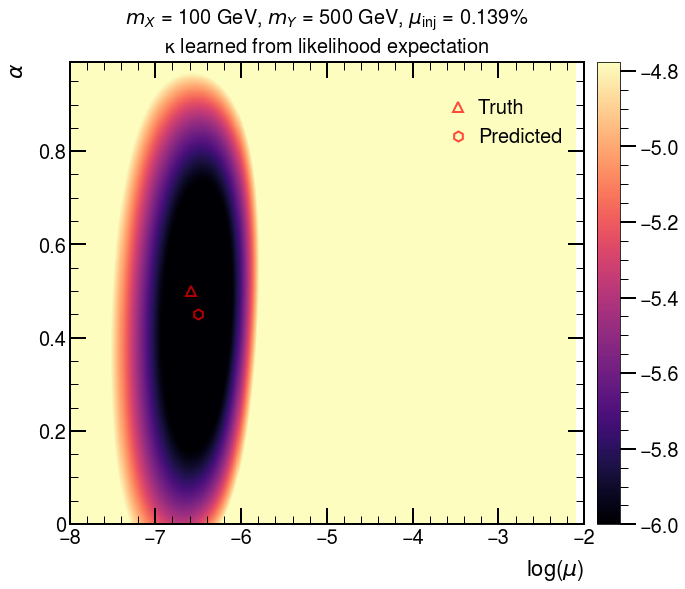

<Figure size 640x480 with 0 Axes>

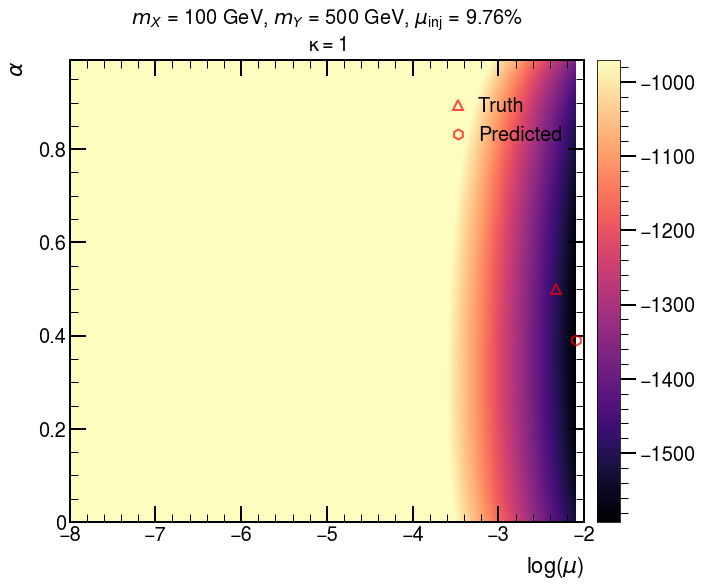

<Figure size 640x480 with 0 Axes>

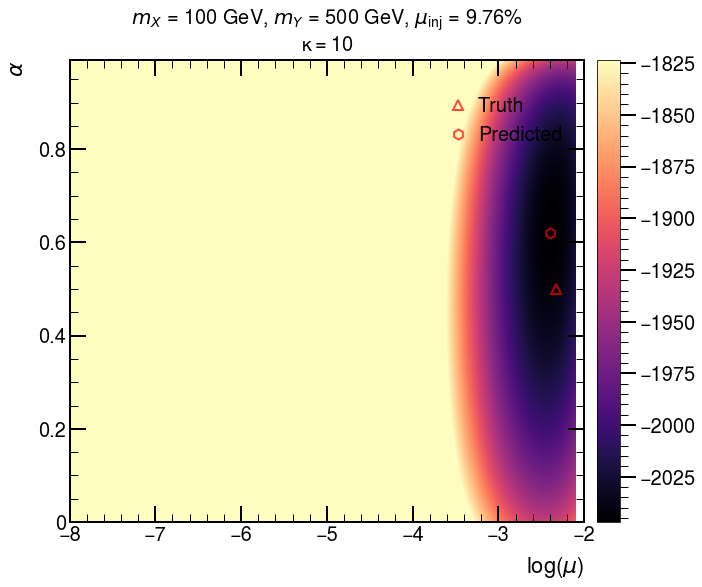

<Figure size 640x480 with 0 Axes>

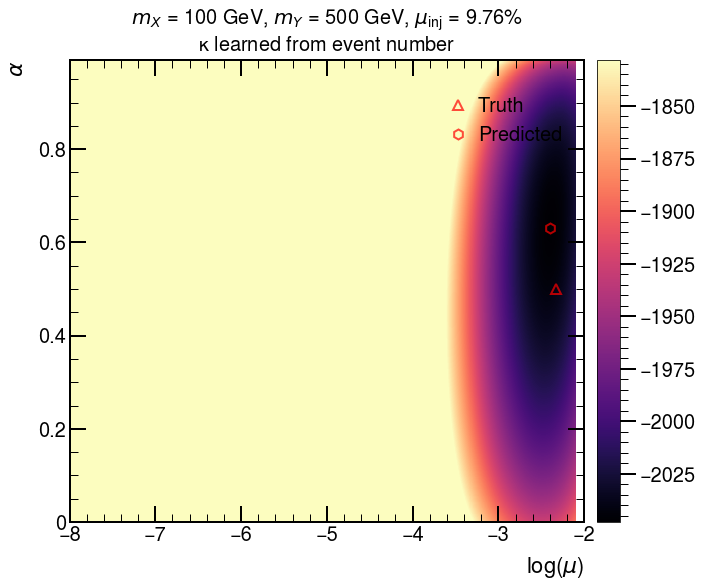

<Figure size 640x480 with 0 Axes>

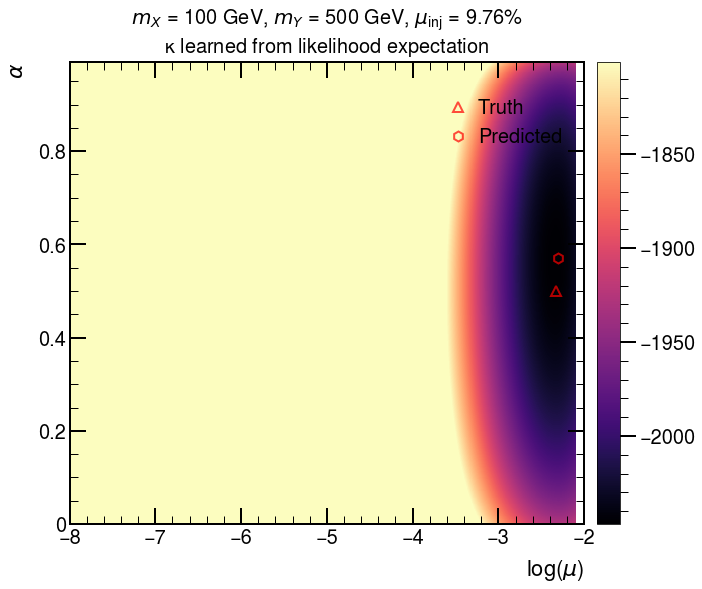

<Figure size 640x480 with 0 Axes>

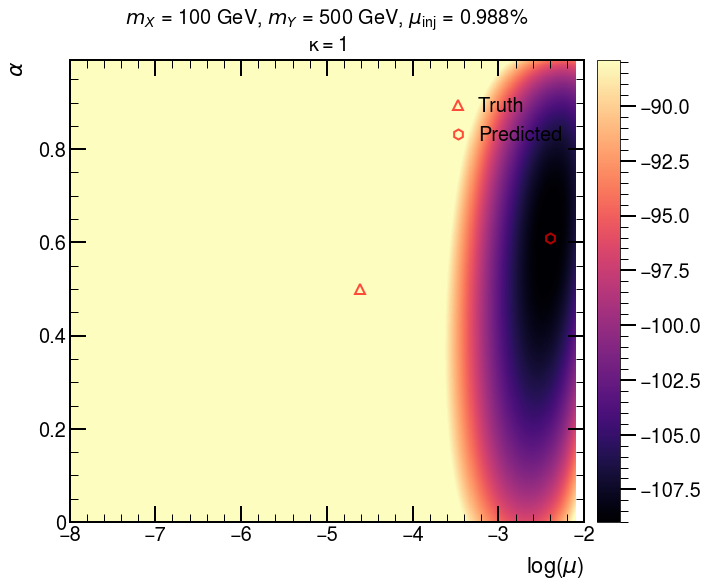

<Figure size 640x480 with 0 Axes>

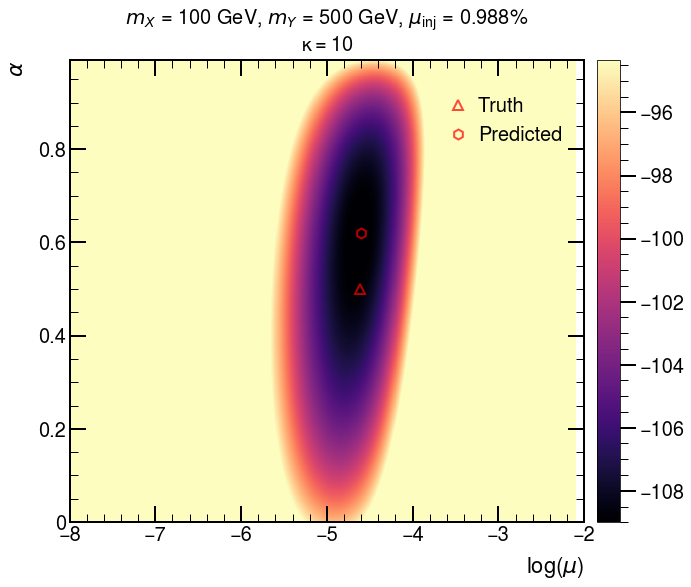

<Figure size 640x480 with 0 Axes>

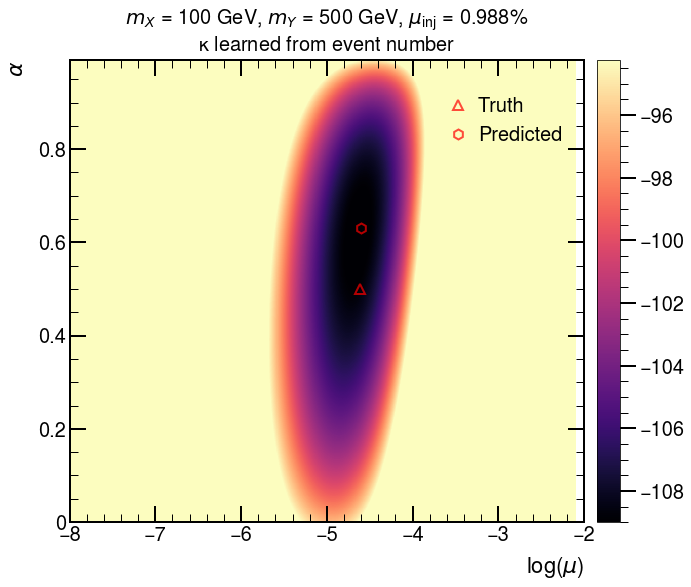

<Figure size 640x480 with 0 Axes>

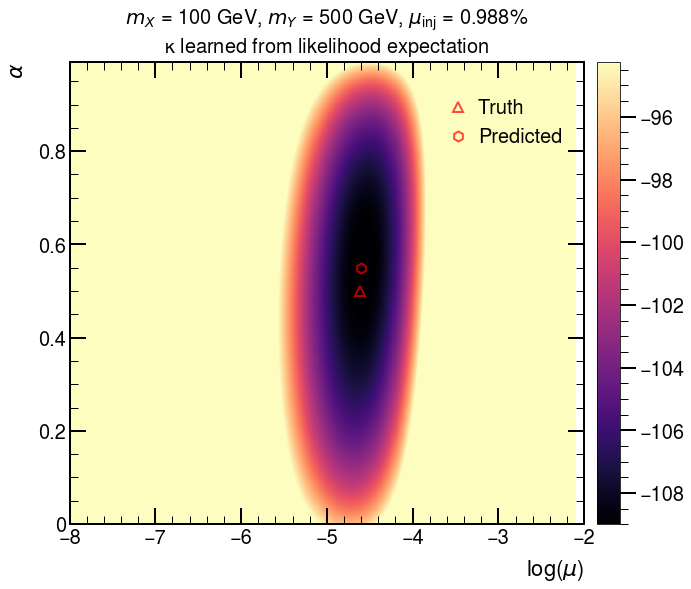

<Figure size 640x480 with 0 Axes>

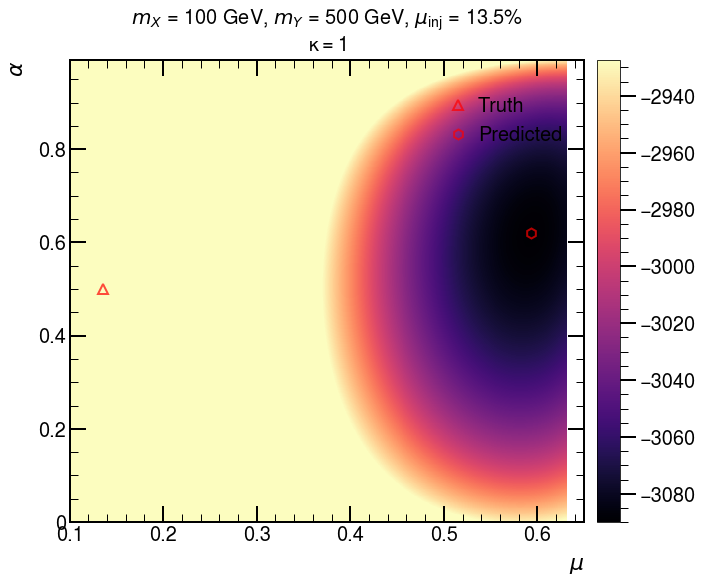

<Figure size 640x480 with 0 Axes>

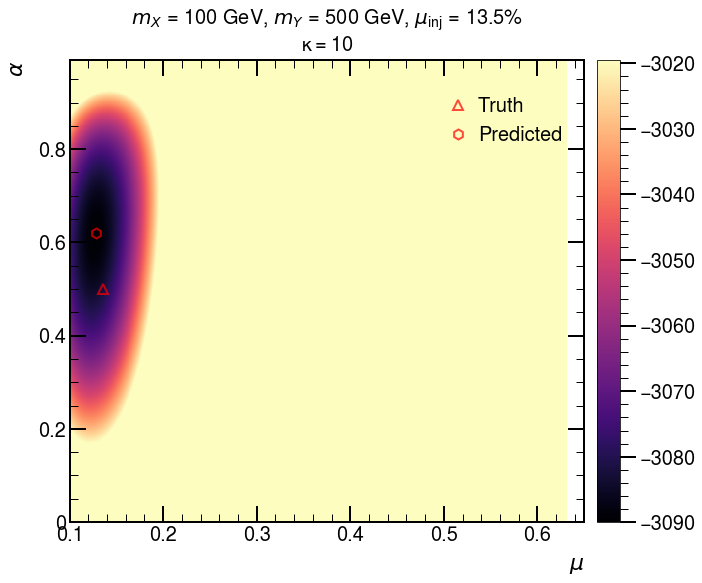

<Figure size 640x480 with 0 Axes>

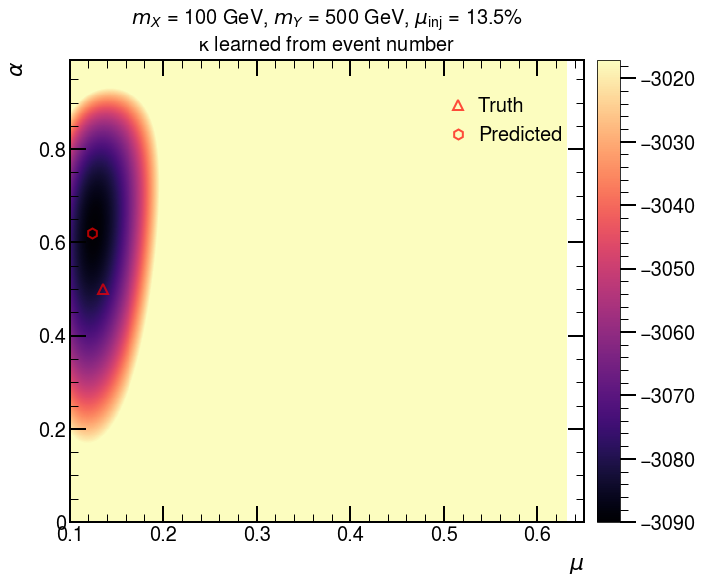

<Figure size 640x480 with 0 Axes>

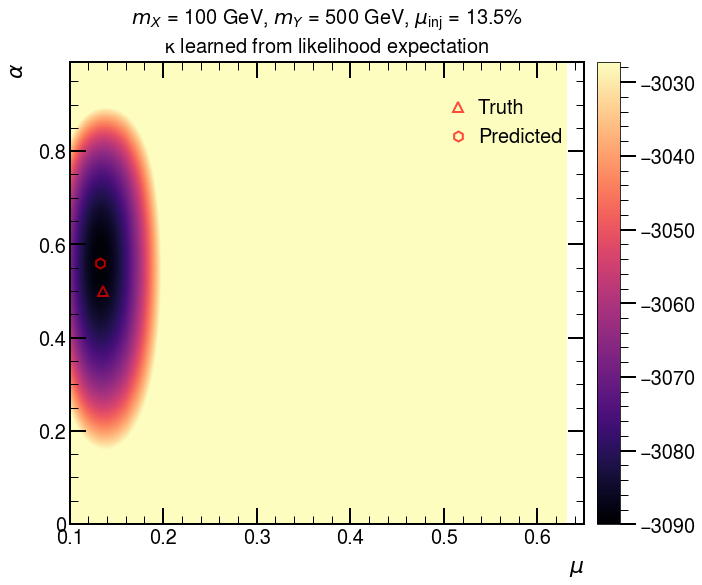

<Figure size 640x480 with 0 Axes>

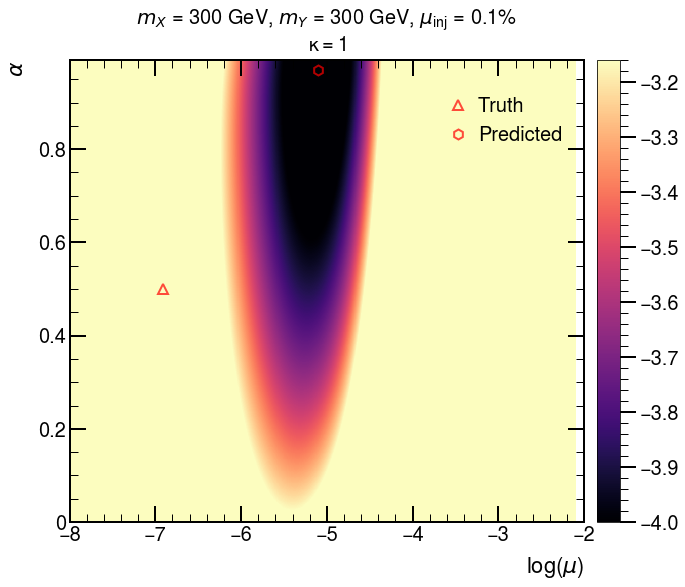

<Figure size 640x480 with 0 Axes>

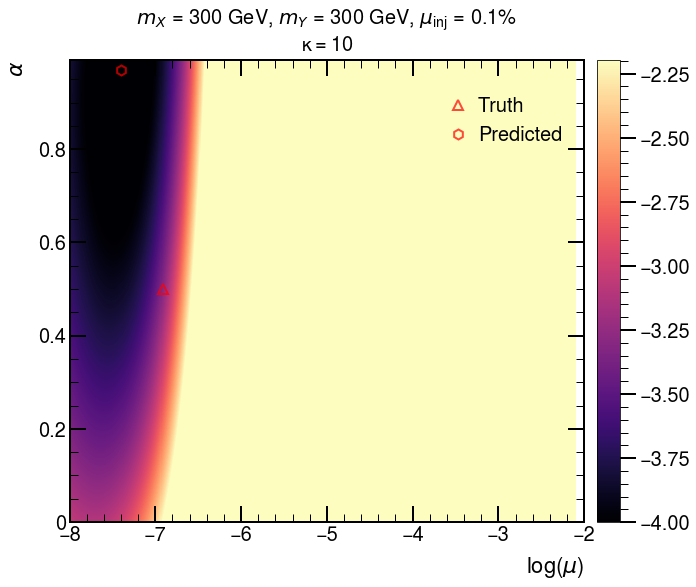

<Figure size 640x480 with 0 Axes>

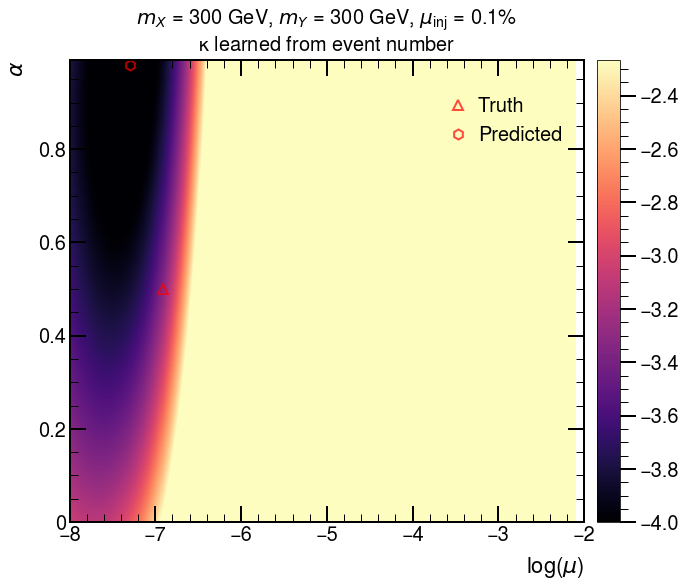

<Figure size 640x480 with 0 Axes>

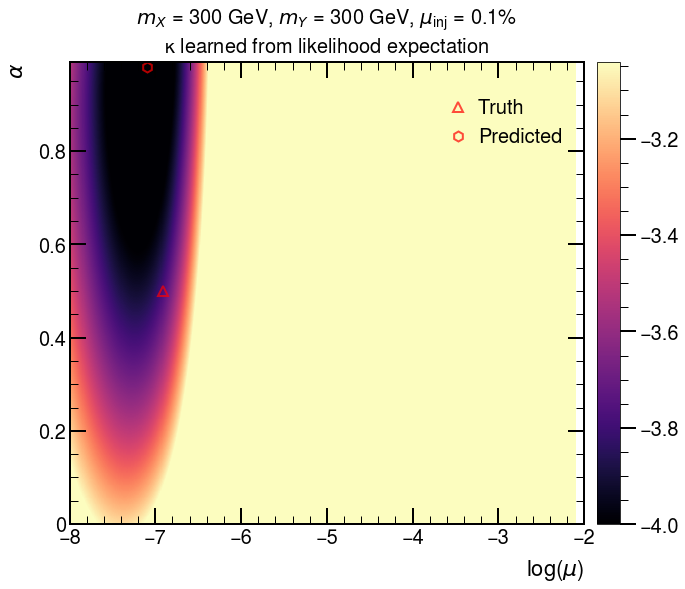

<Figure size 640x480 with 0 Axes>

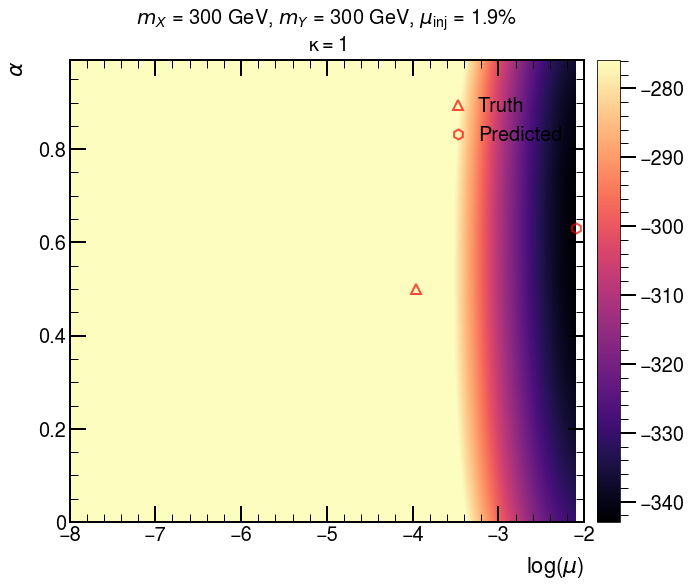

<Figure size 640x480 with 0 Axes>

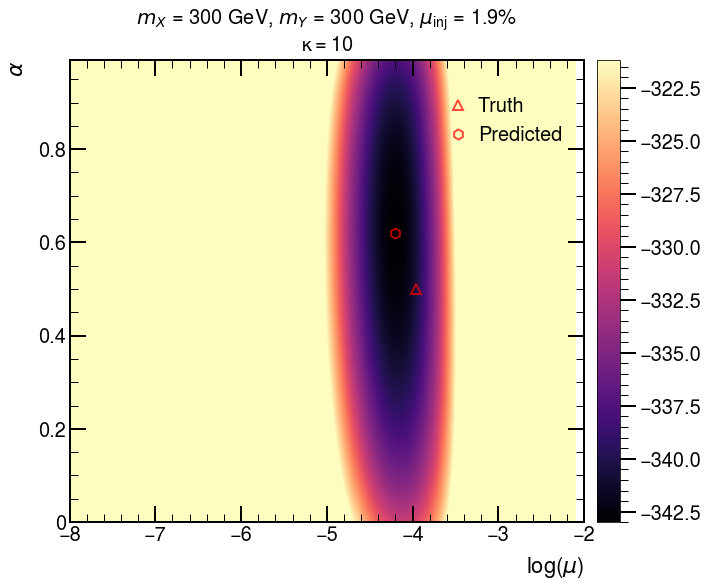

<Figure size 640x480 with 0 Axes>

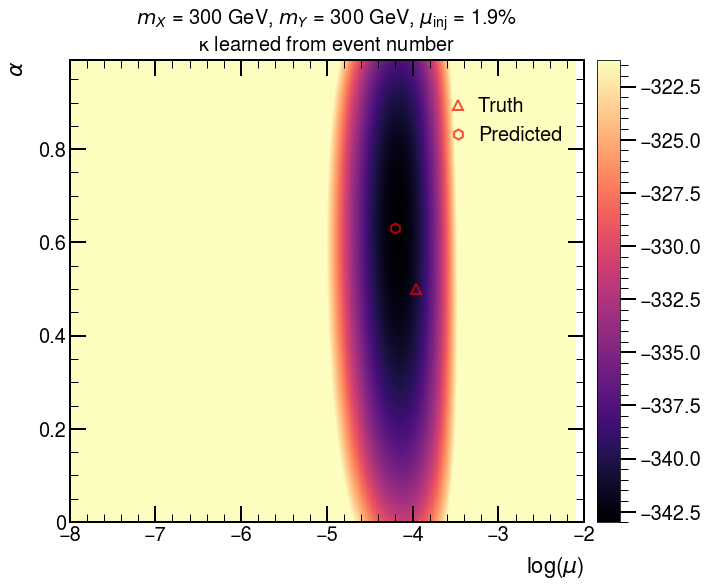

<Figure size 640x480 with 0 Axes>

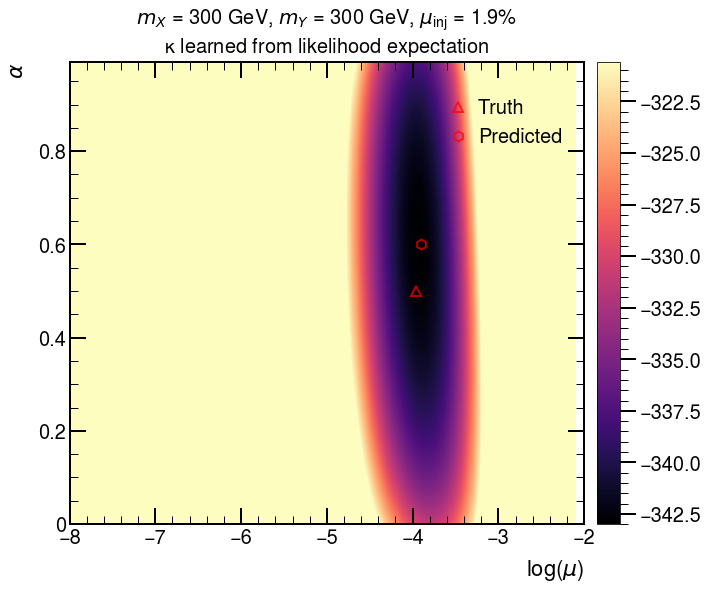

<Figure size 640x480 with 0 Axes>

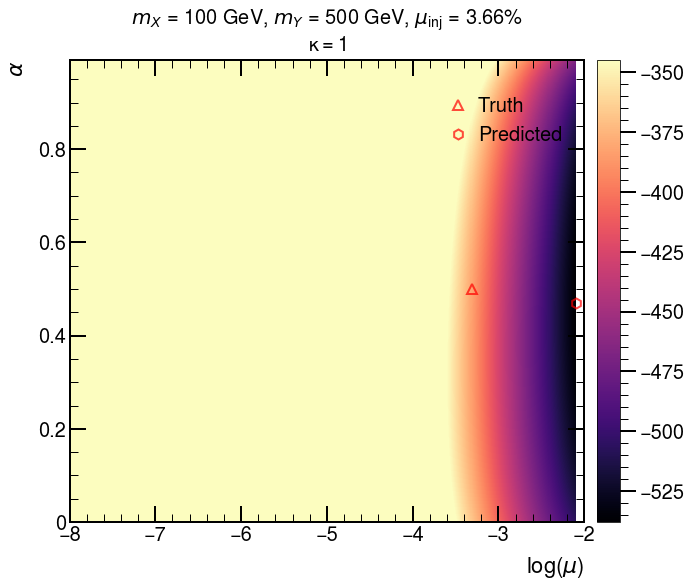

<Figure size 640x480 with 0 Axes>

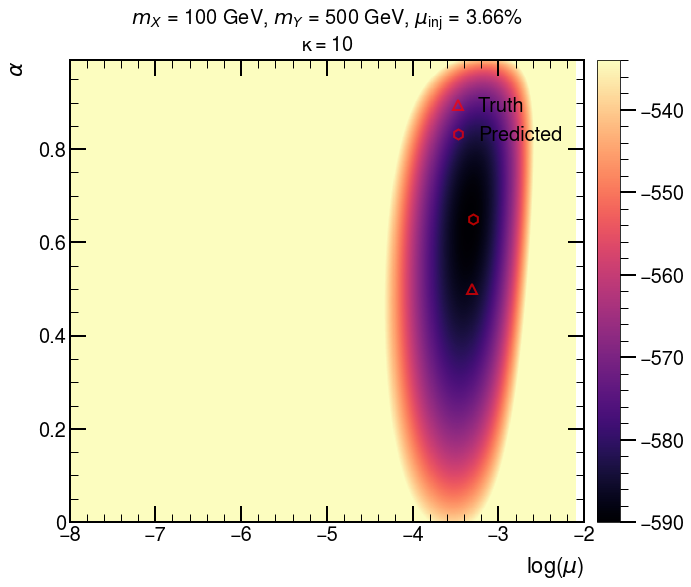

<Figure size 640x480 with 0 Axes>

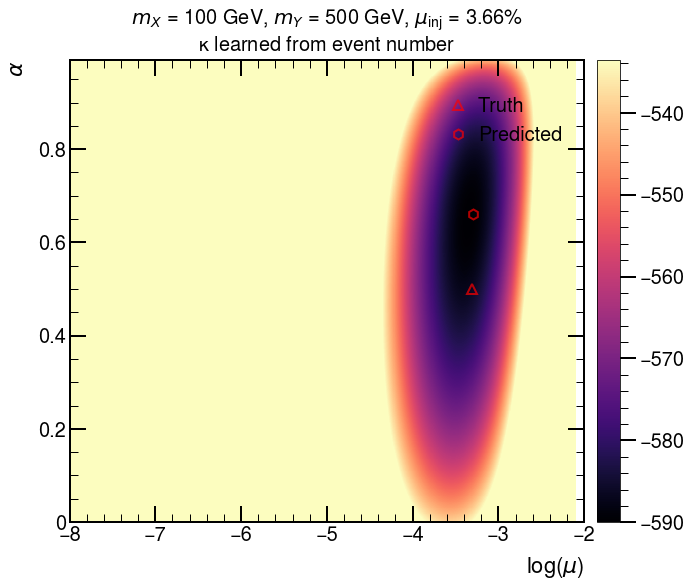

<Figure size 640x480 with 0 Axes>

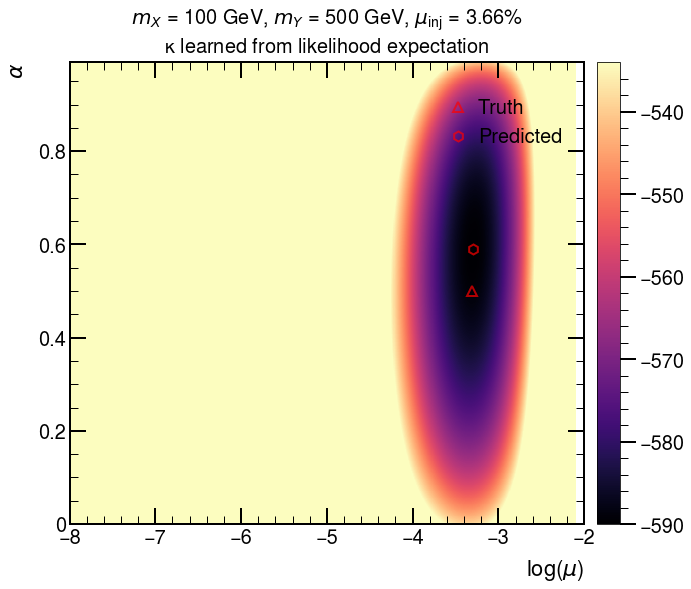

<Figure size 640x480 with 0 Axes>

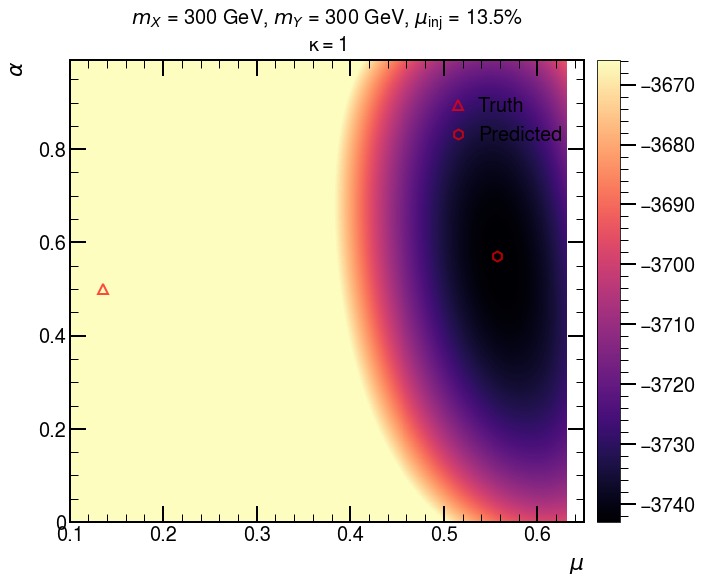

<Figure size 640x480 with 0 Axes>

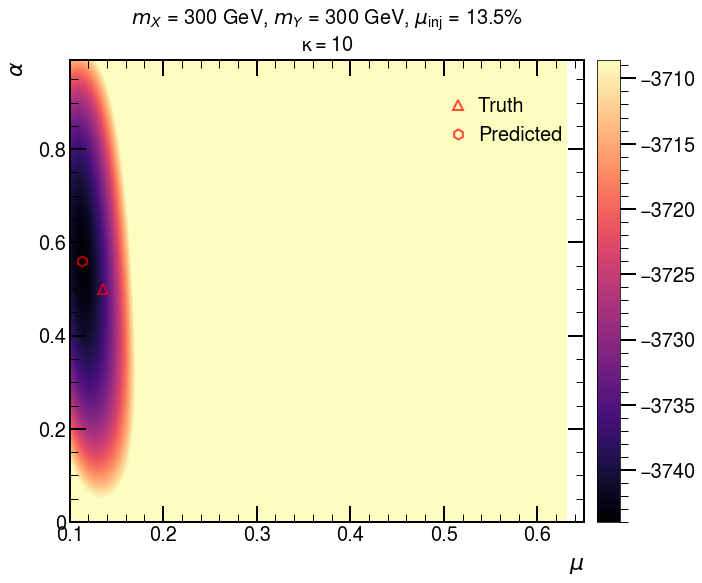

<Figure size 640x480 with 0 Axes>

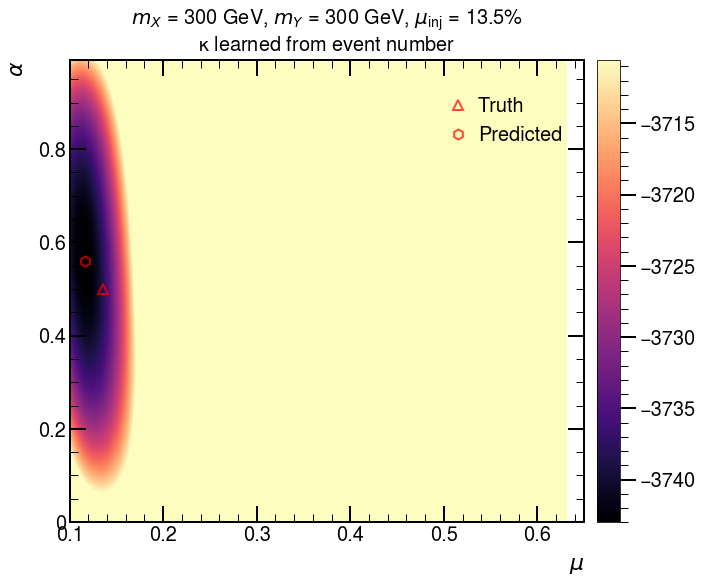

<Figure size 640x480 with 0 Axes>

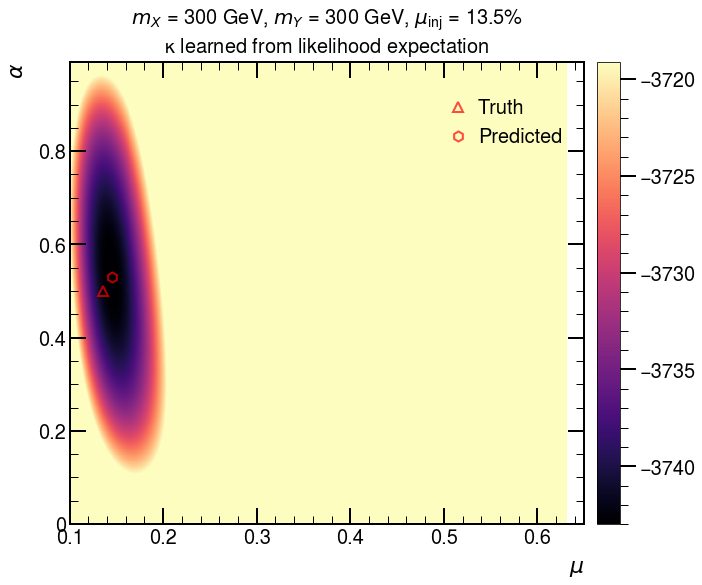

<Figure size 640x480 with 0 Axes>

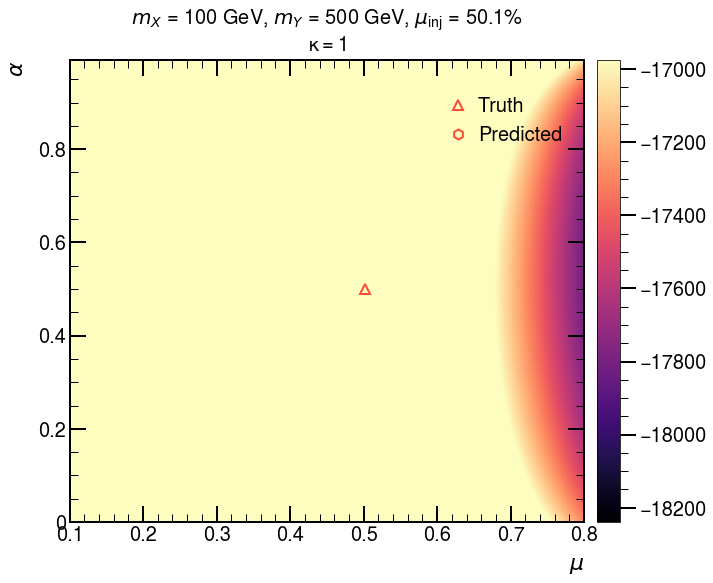

<Figure size 640x480 with 0 Axes>

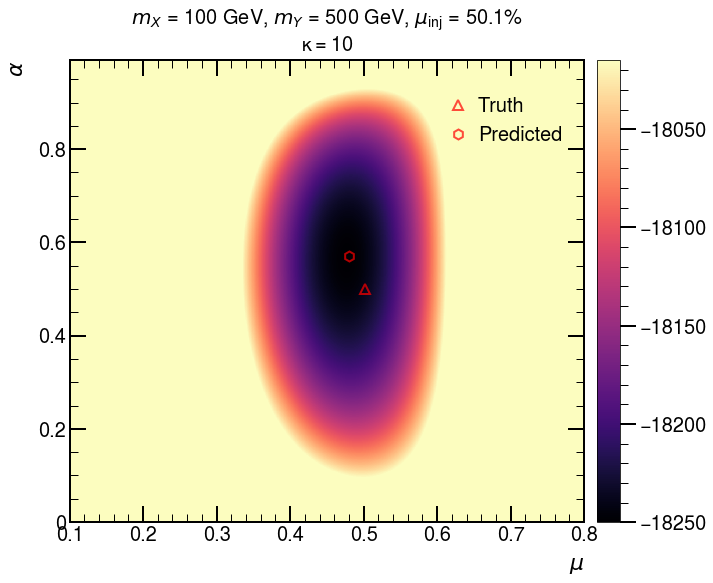

<Figure size 640x480 with 0 Axes>

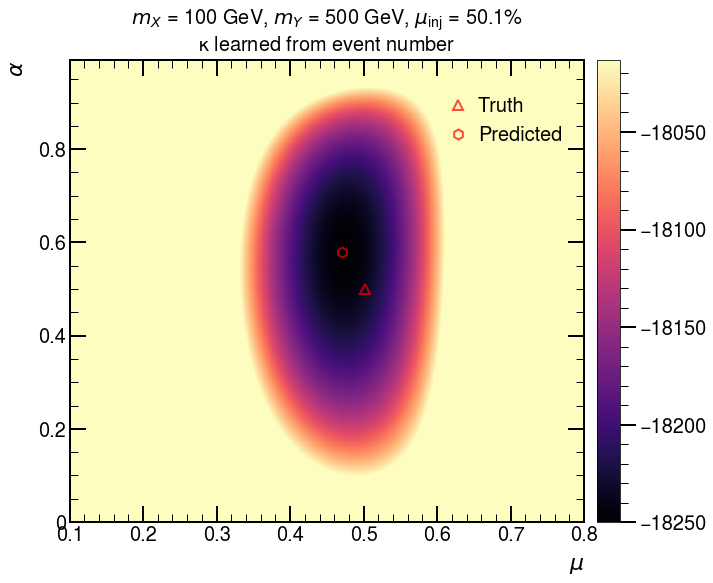

<Figure size 640x480 with 0 Axes>

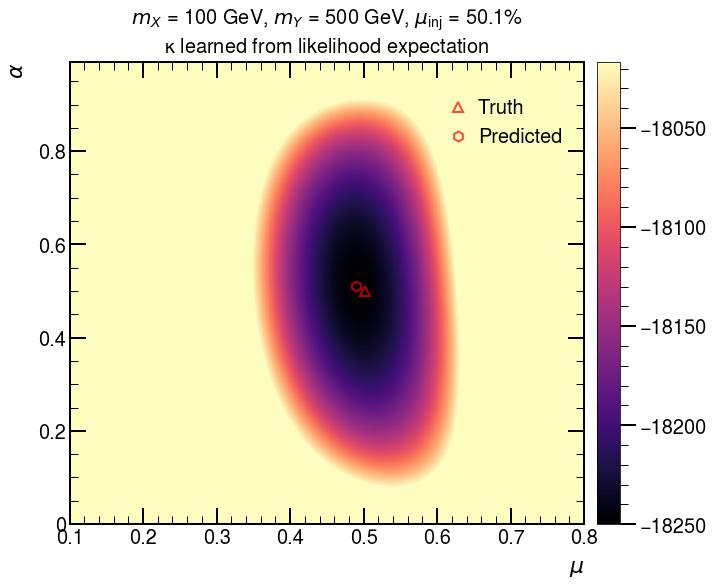

<Figure size 640x480 with 0 Axes>

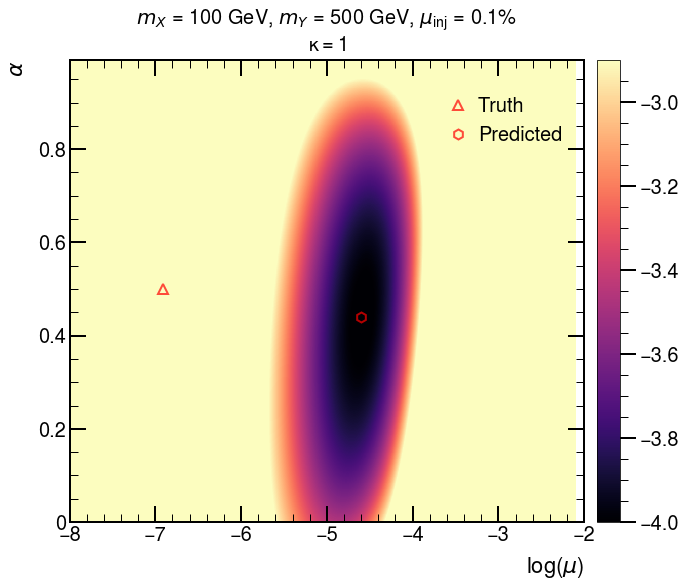

<Figure size 640x480 with 0 Axes>

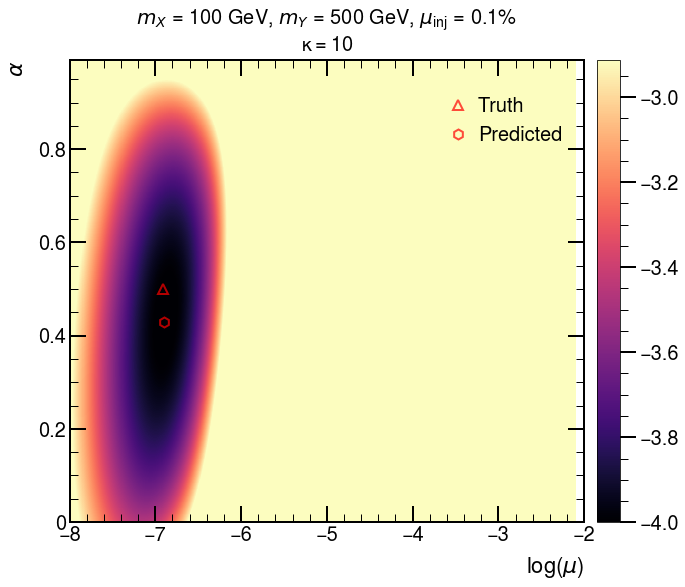

<Figure size 640x480 with 0 Axes>

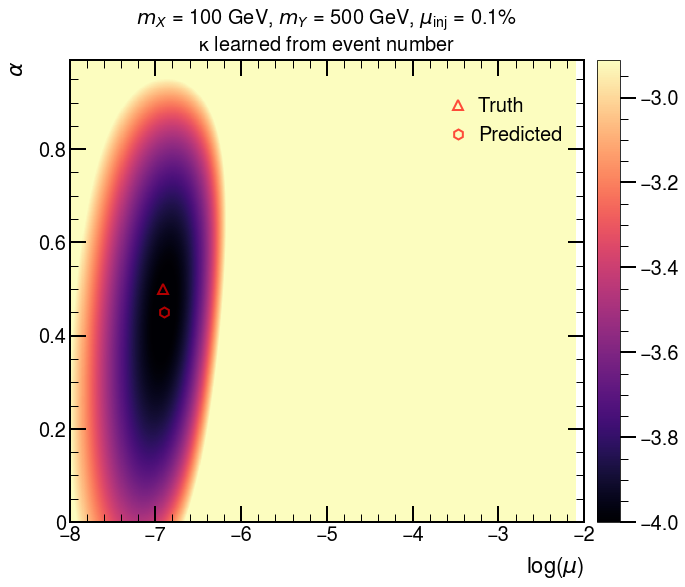

<Figure size 640x480 with 0 Axes>

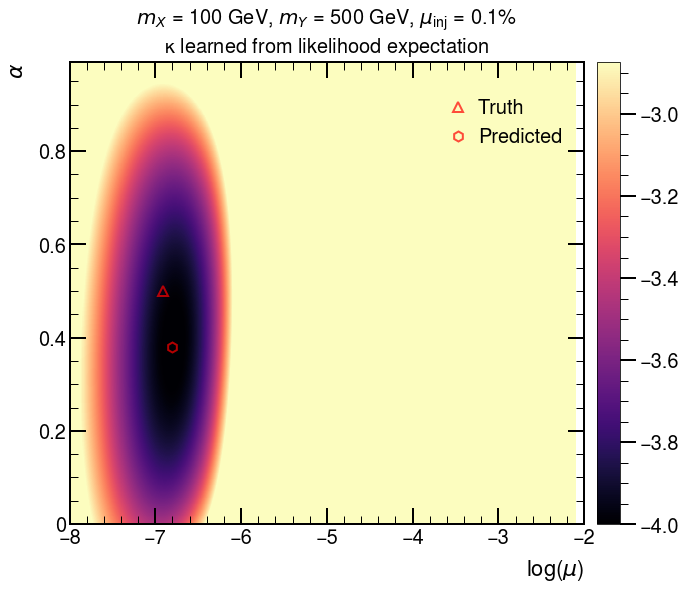

<Figure size 640x480 with 0 Axes>

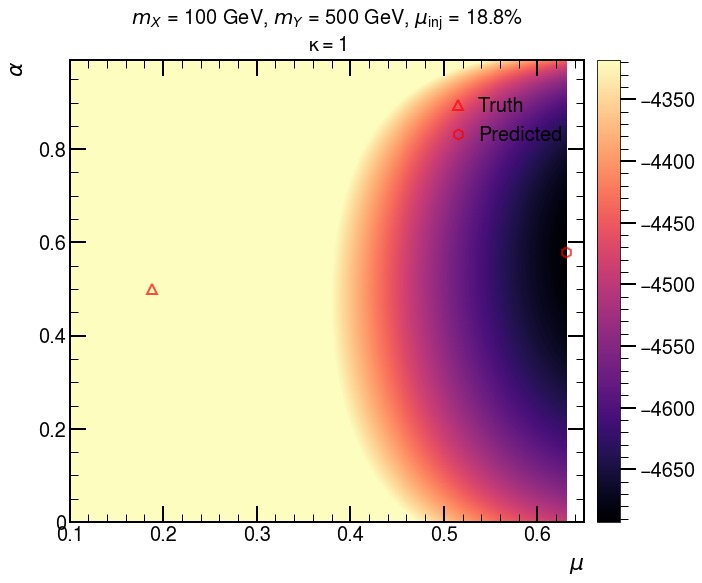

<Figure size 640x480 with 0 Axes>

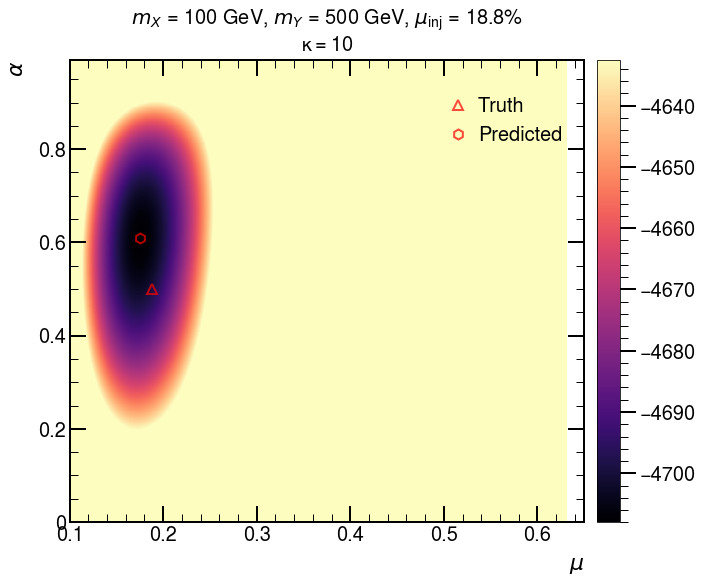

<Figure size 640x480 with 0 Axes>

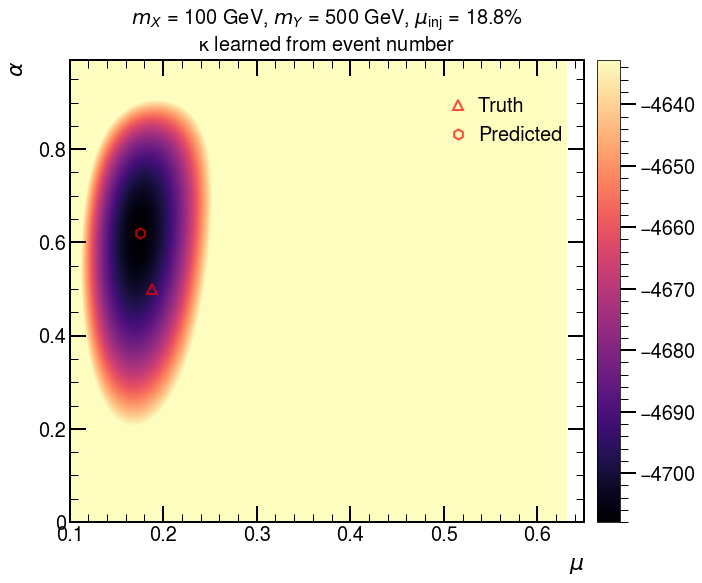

<Figure size 640x480 with 0 Axes>

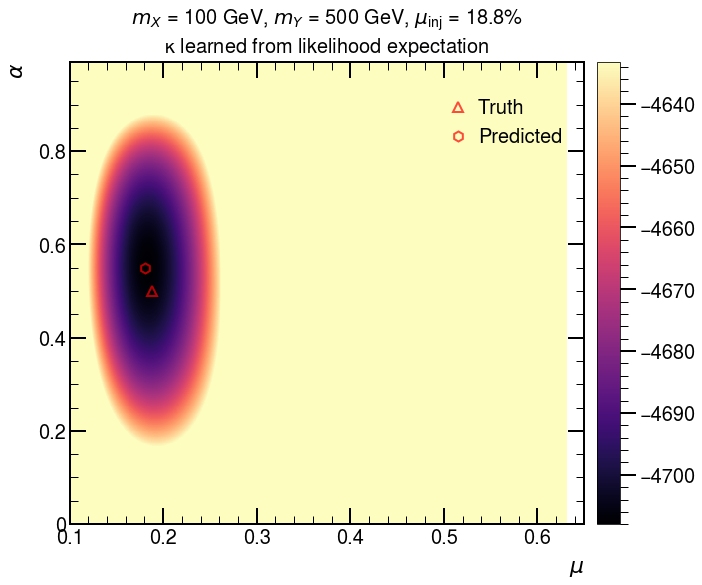

<Figure size 640x480 with 0 Axes>

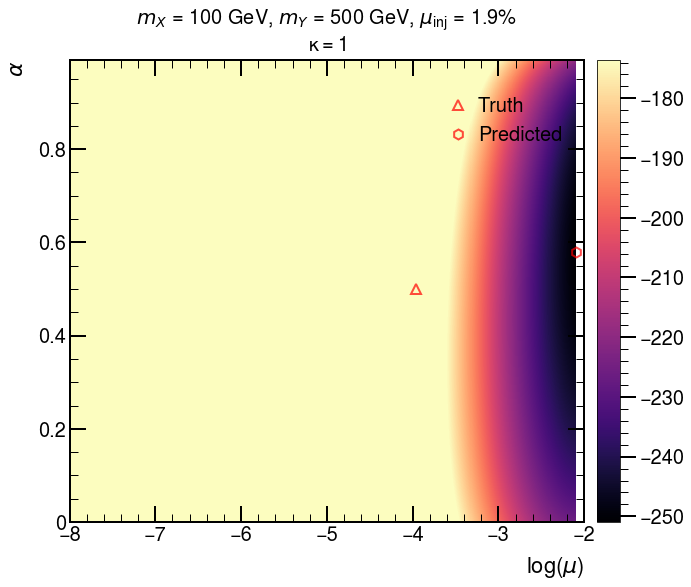

<Figure size 640x480 with 0 Axes>

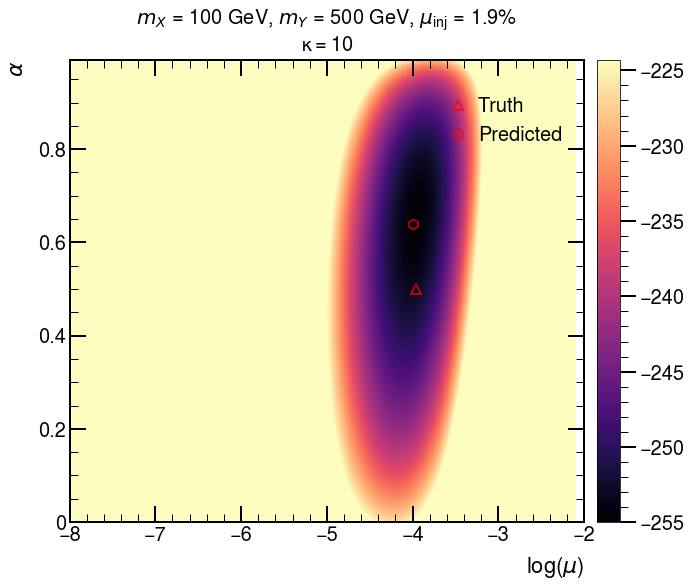

<Figure size 640x480 with 0 Axes>

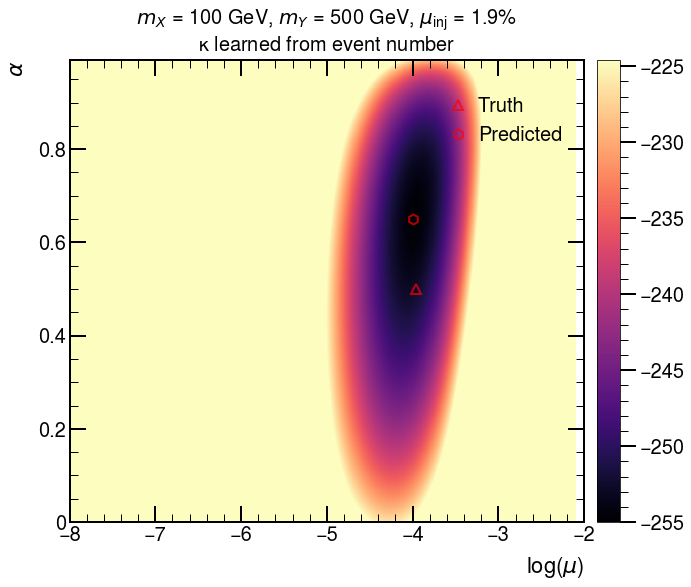

<Figure size 640x480 with 0 Axes>

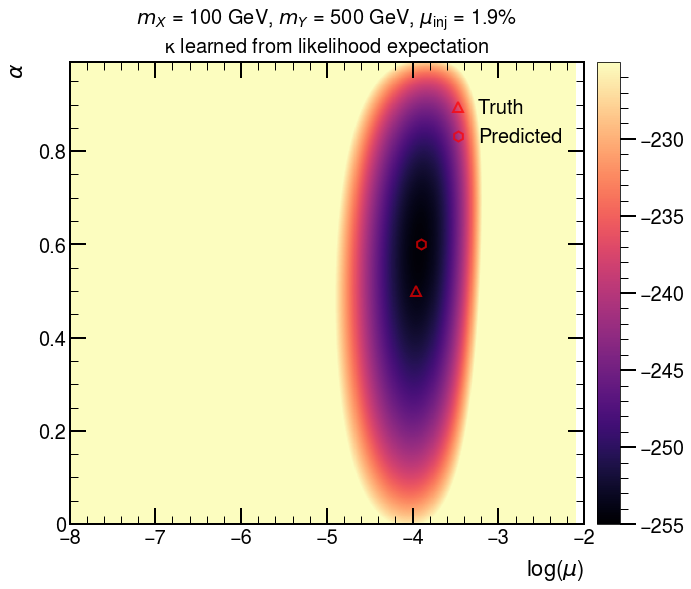

<Figure size 640x480 with 0 Axes>

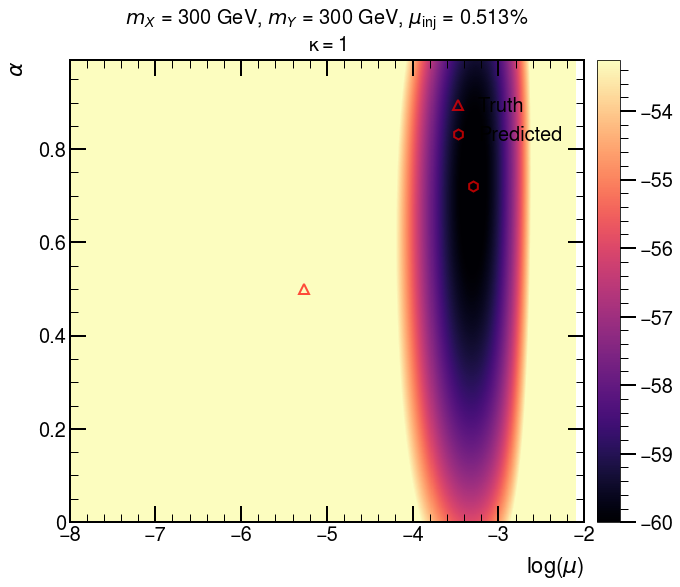

<Figure size 640x480 with 0 Axes>

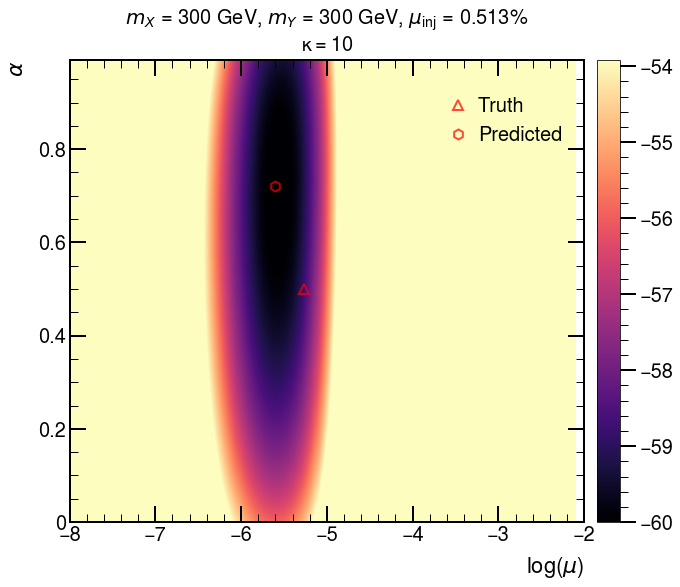

<Figure size 640x480 with 0 Axes>

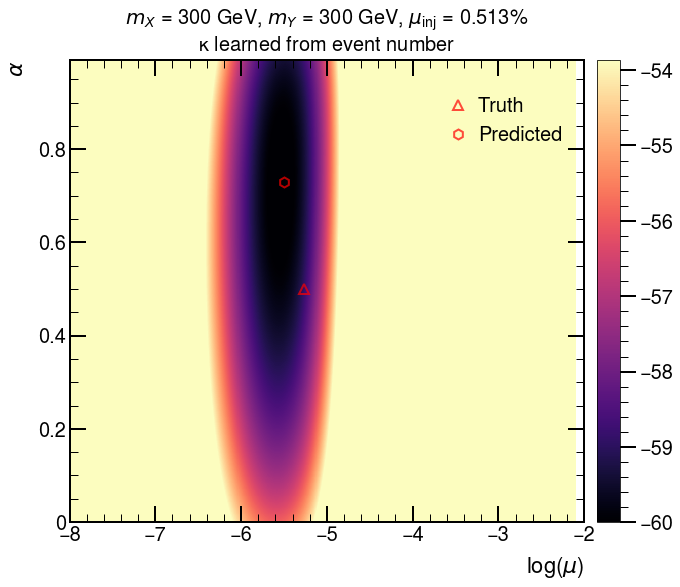

<Figure size 640x480 with 0 Axes>

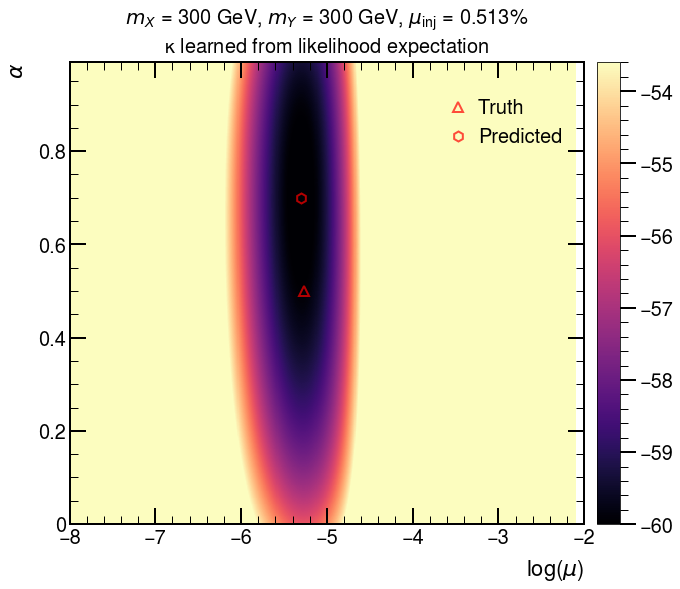

<Figure size 640x480 with 0 Axes>

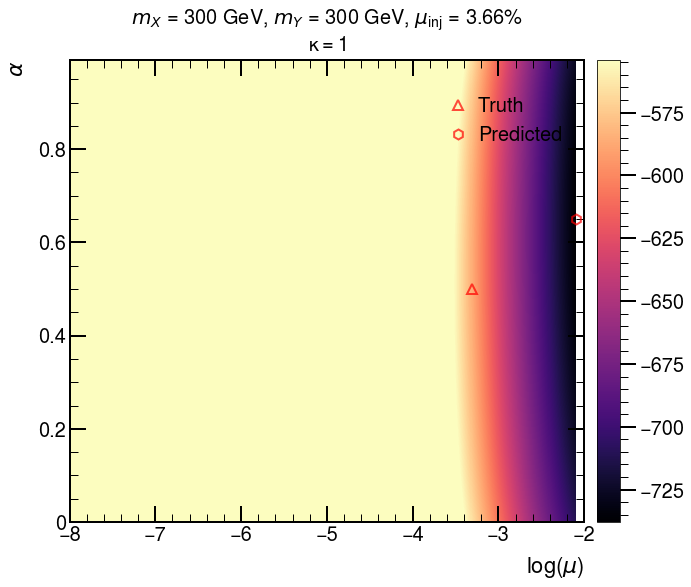

<Figure size 640x480 with 0 Axes>

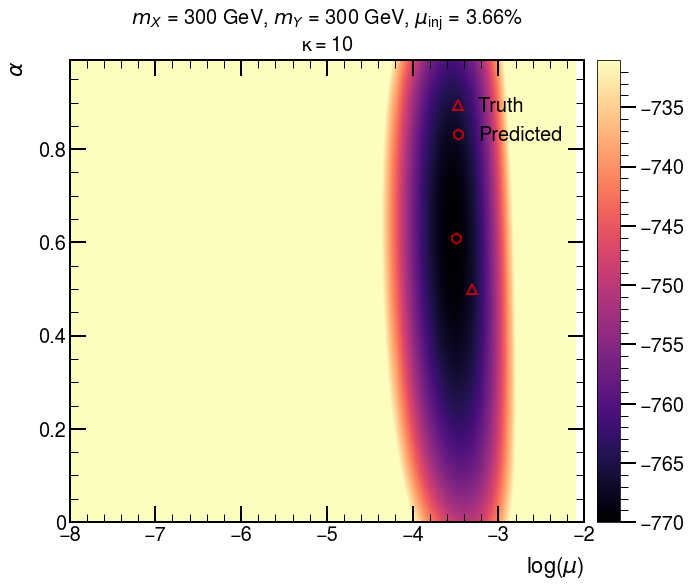

<Figure size 640x480 with 0 Axes>

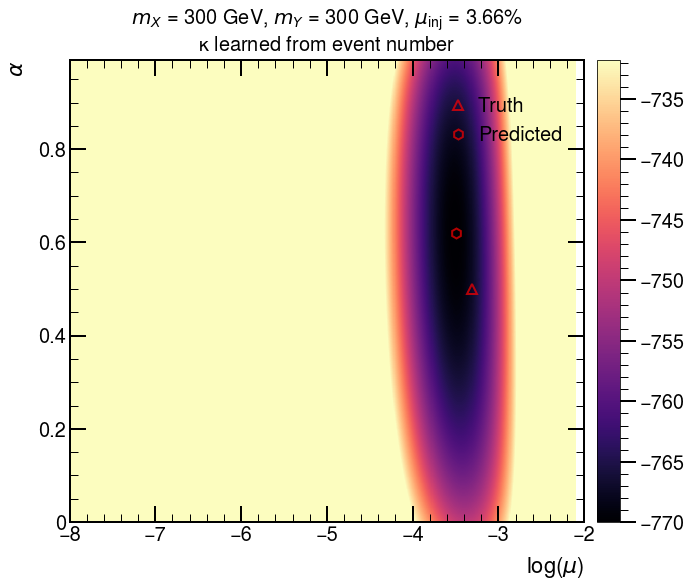

<Figure size 640x480 with 0 Axes>

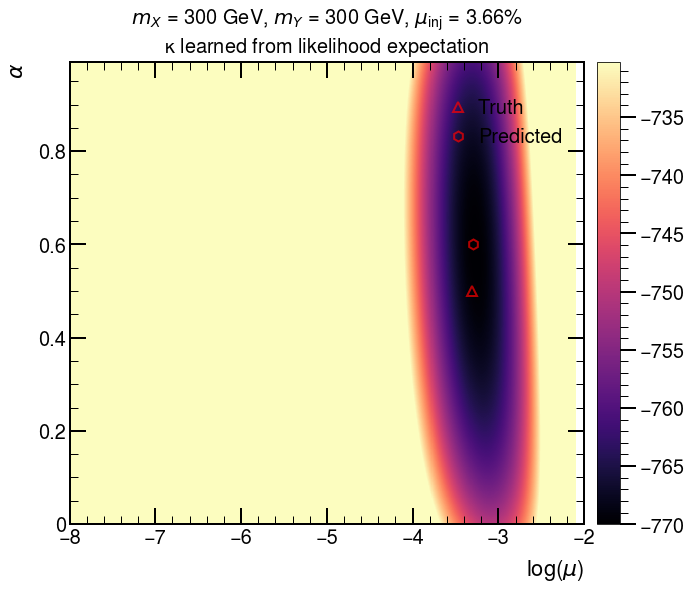

<Figure size 640x480 with 0 Axes>

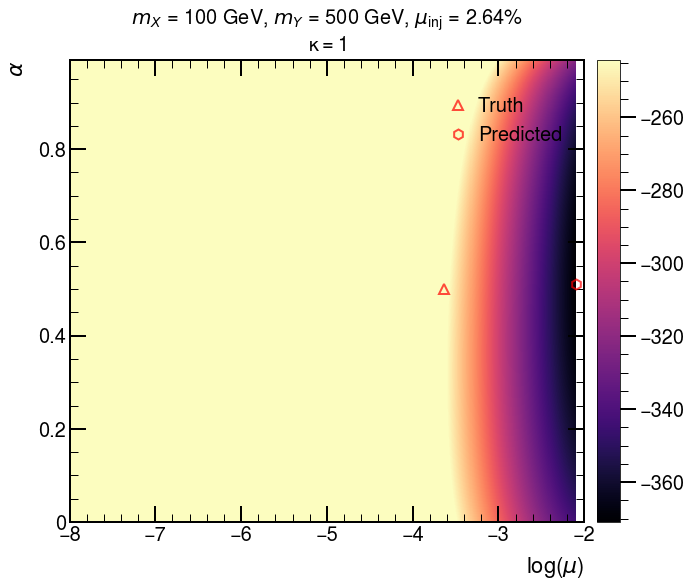

<Figure size 640x480 with 0 Axes>

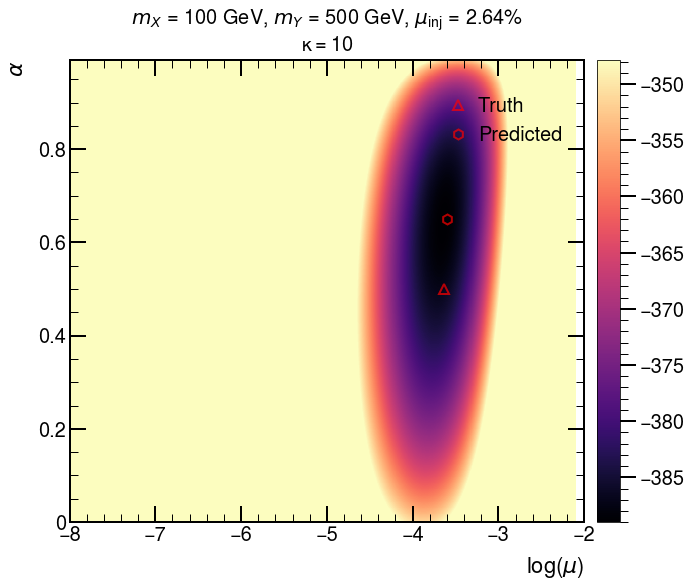

<Figure size 640x480 with 0 Axes>

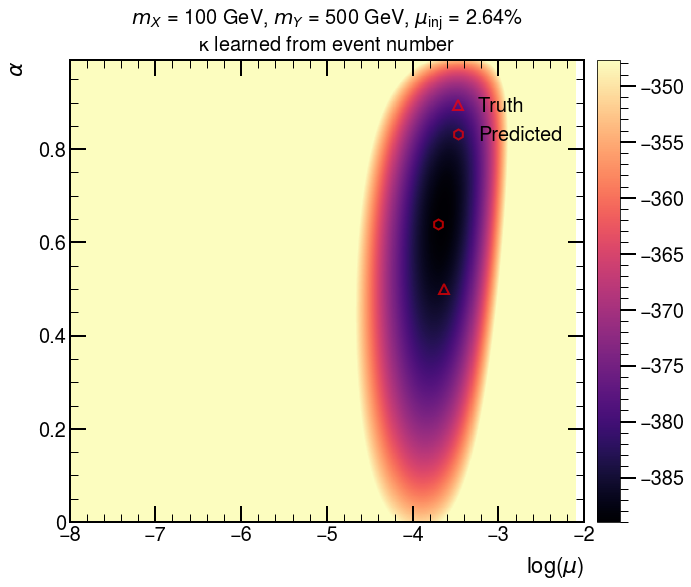

<Figure size 640x480 with 0 Axes>

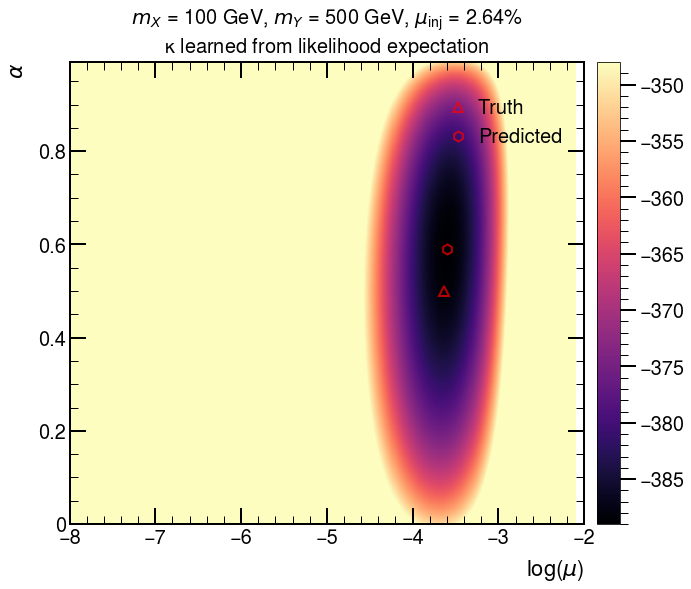

<Figure size 640x480 with 0 Axes>

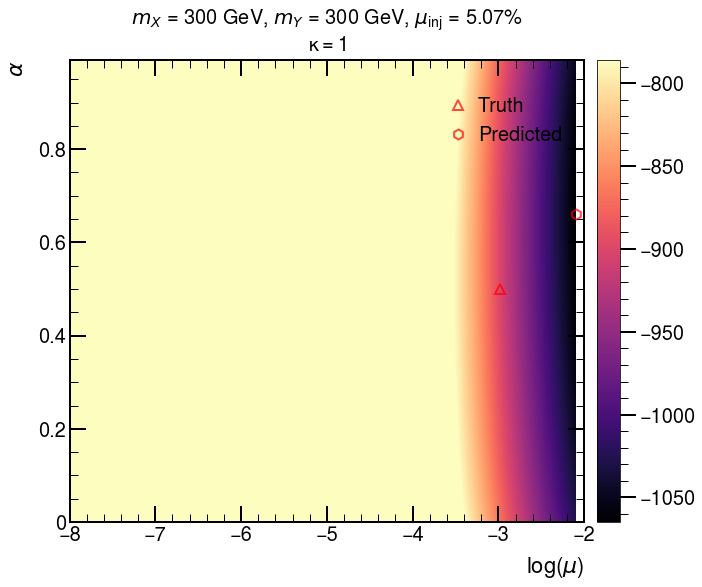

<Figure size 640x480 with 0 Axes>

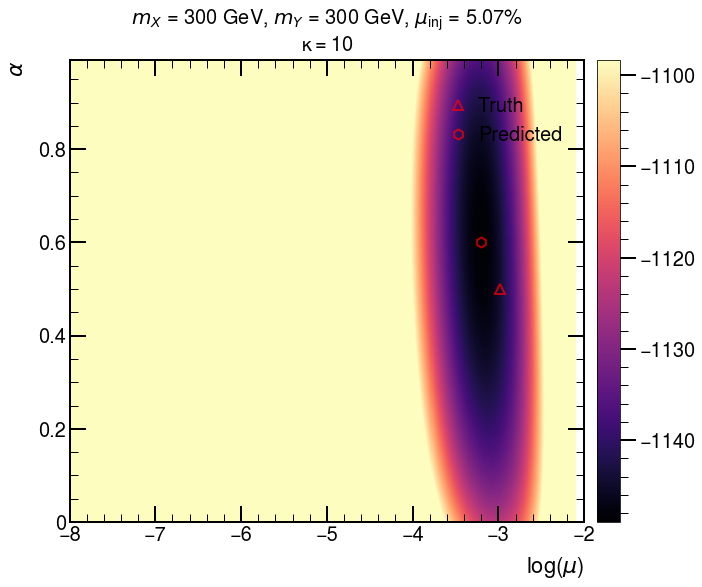

<Figure size 640x480 with 0 Axes>

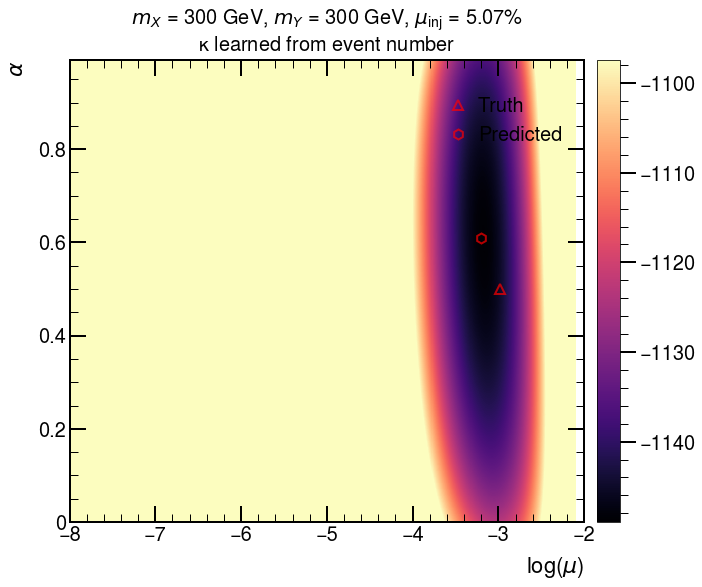

<Figure size 640x480 with 0 Axes>

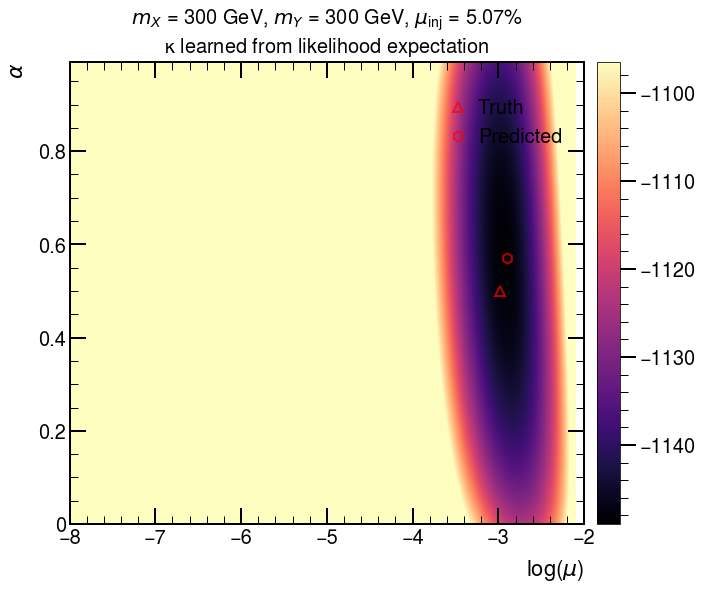

<Figure size 640x480 with 0 Axes>

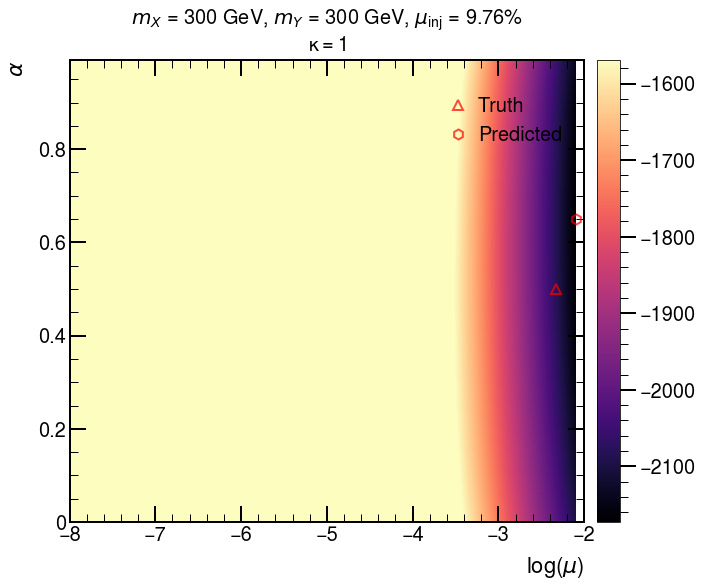

<Figure size 640x480 with 0 Axes>

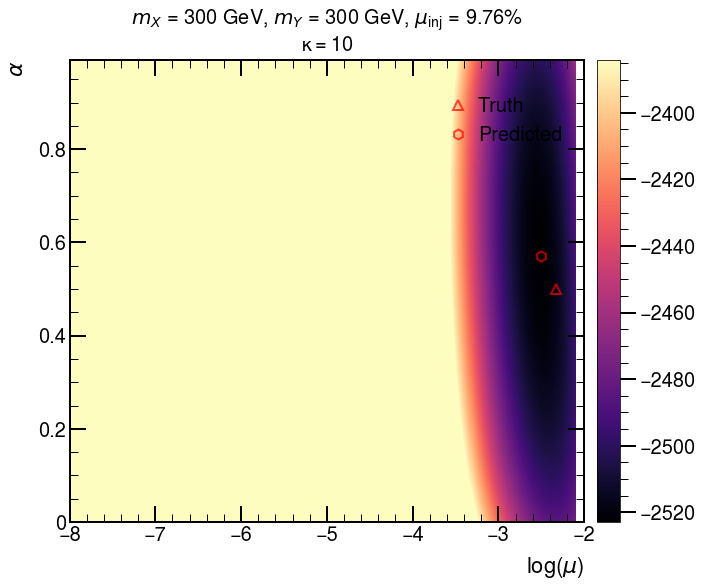

<Figure size 640x480 with 0 Axes>

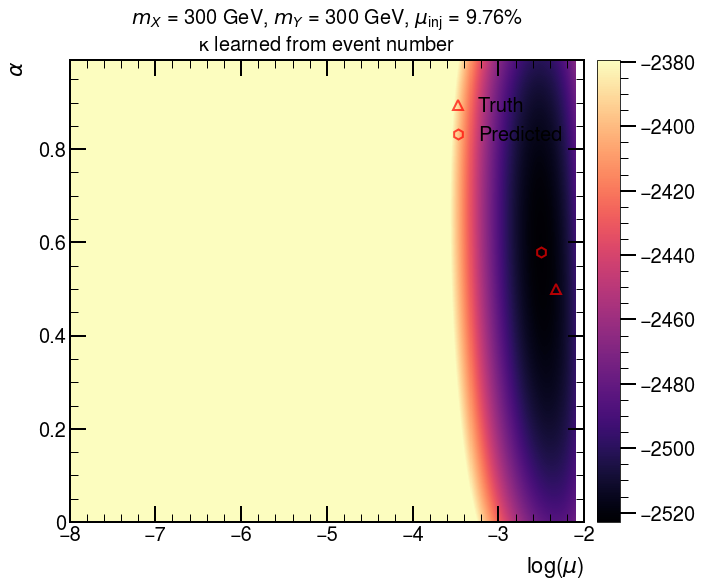

<Figure size 640x480 with 0 Axes>

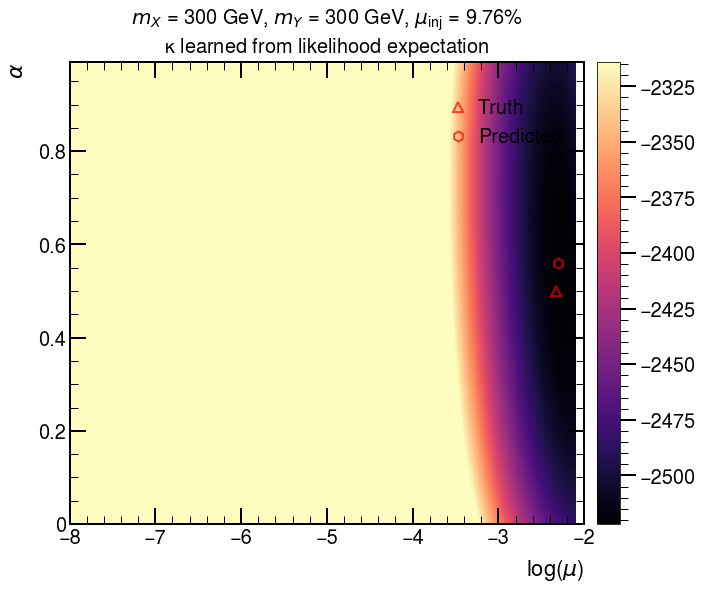

<Figure size 640x480 with 0 Axes>

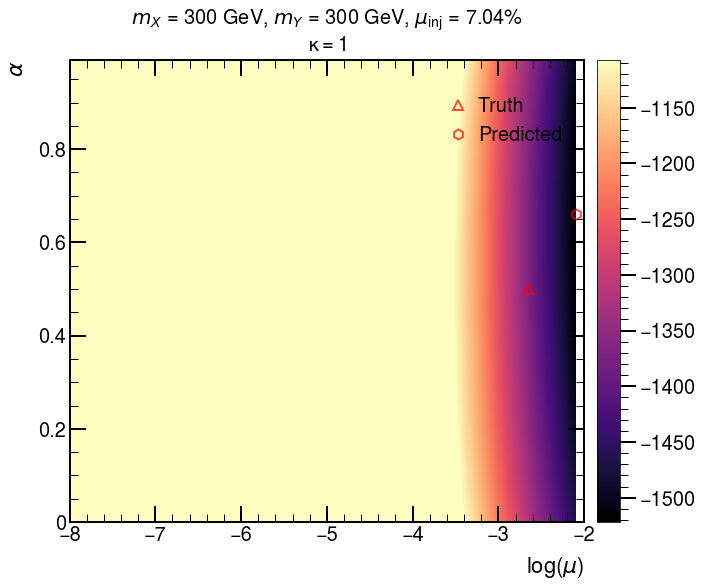

<Figure size 640x480 with 0 Axes>

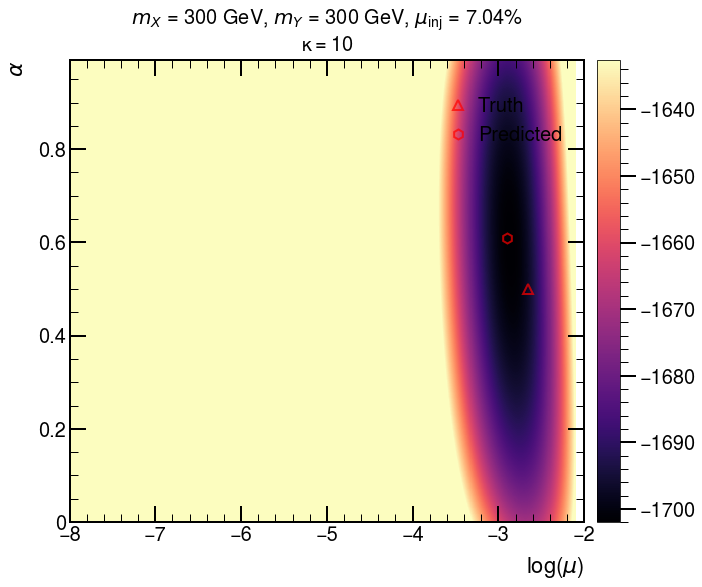

<Figure size 640x480 with 0 Axes>

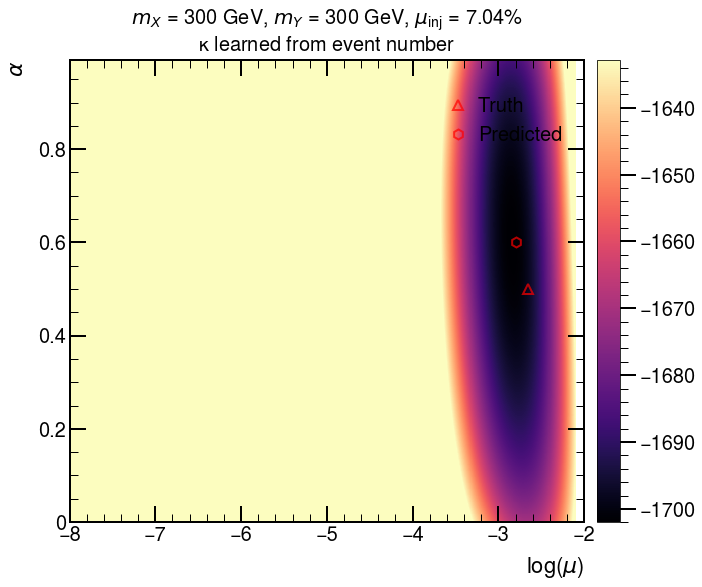

<Figure size 640x480 with 0 Axes>

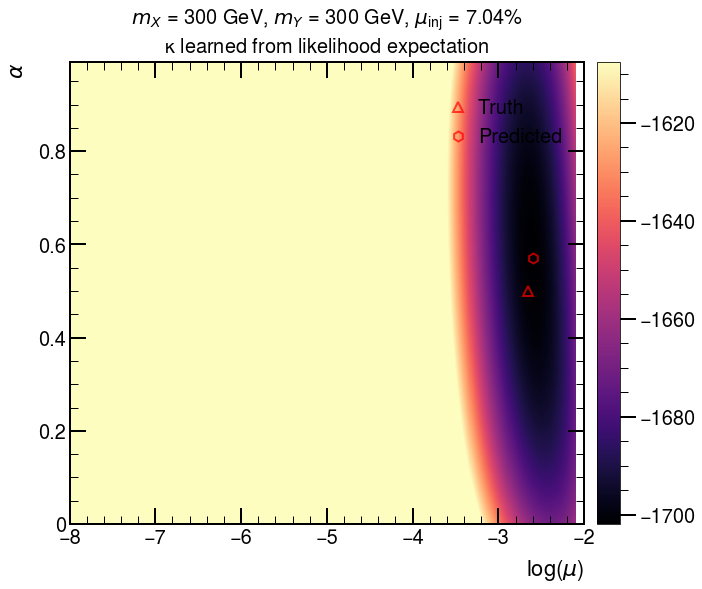

<Figure size 640x480 with 0 Axes>

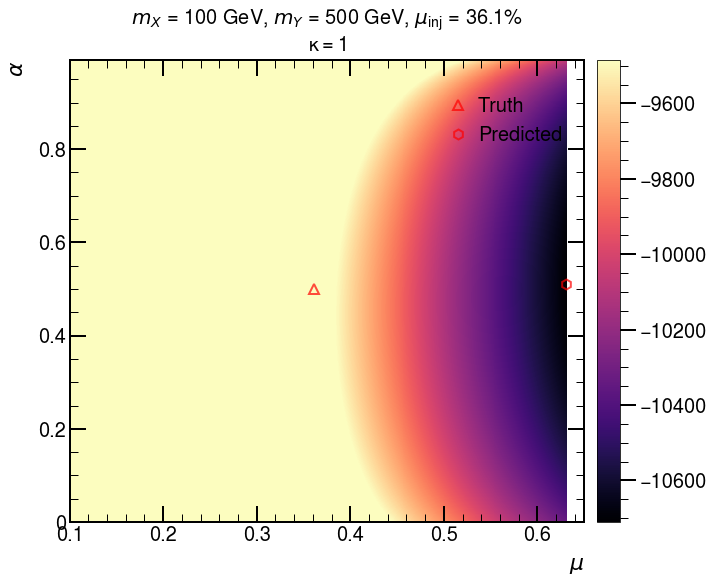

<Figure size 640x480 with 0 Axes>

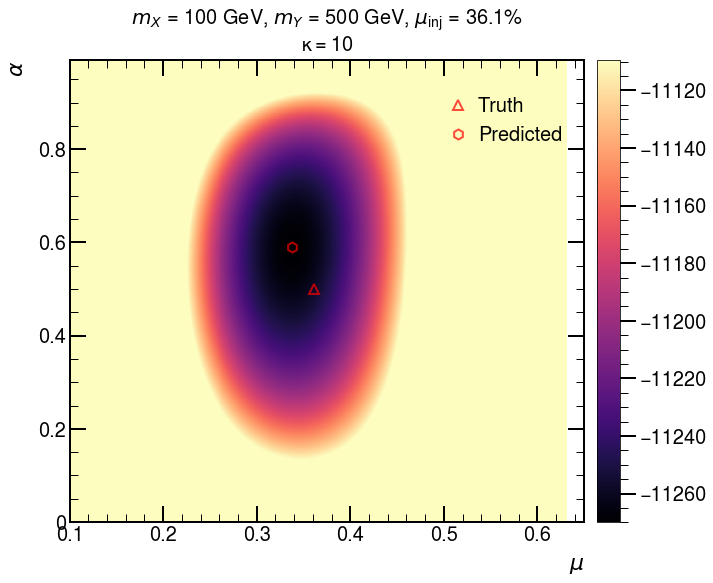

<Figure size 640x480 with 0 Axes>

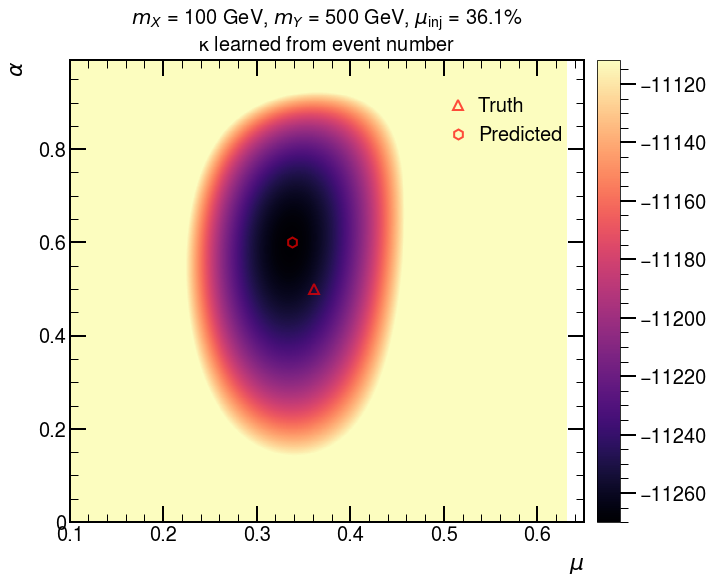

<Figure size 640x480 with 0 Axes>

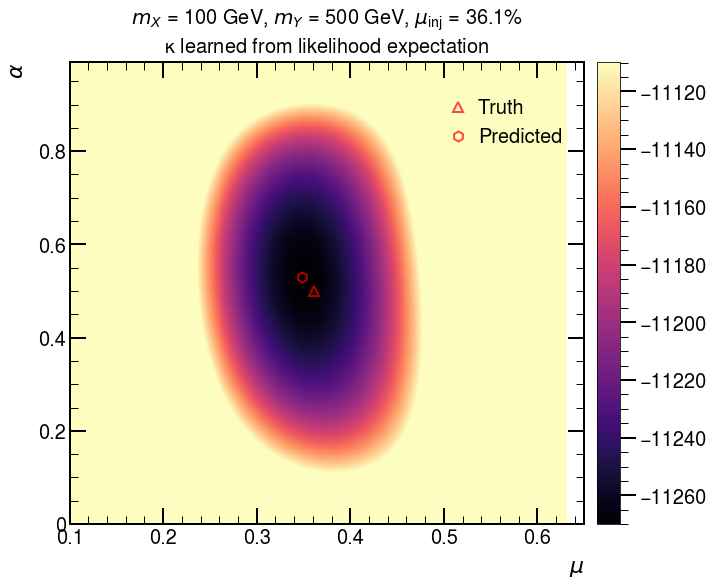

<Figure size 640x480 with 0 Axes>

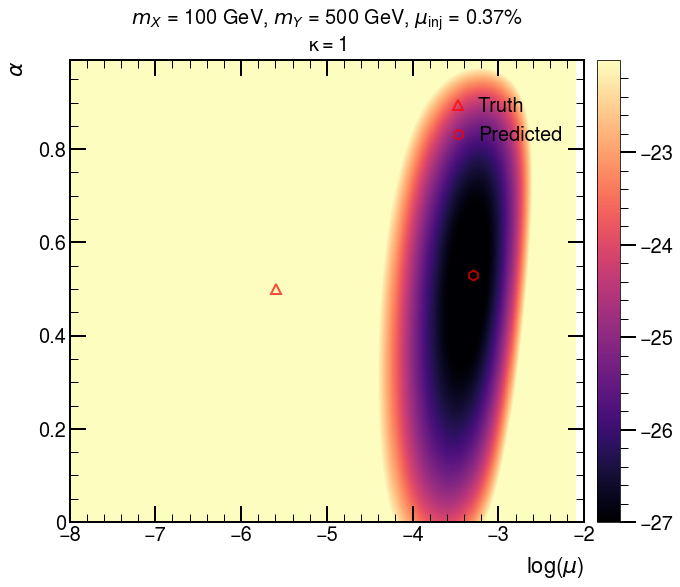

<Figure size 640x480 with 0 Axes>

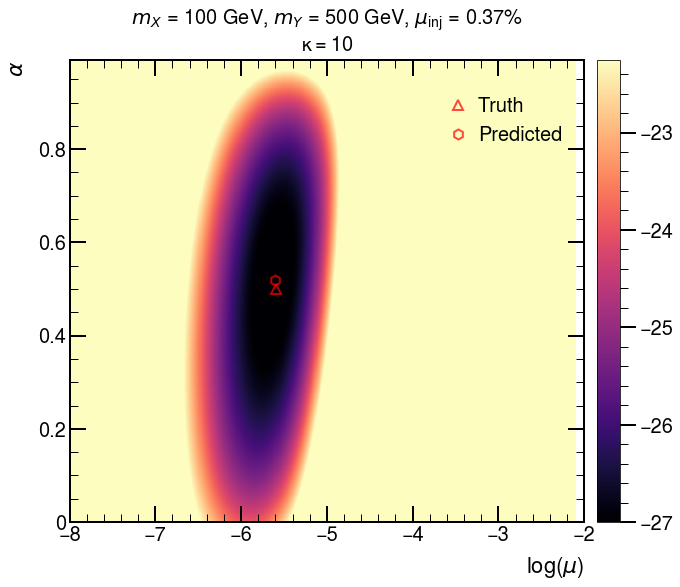

<Figure size 640x480 with 0 Axes>

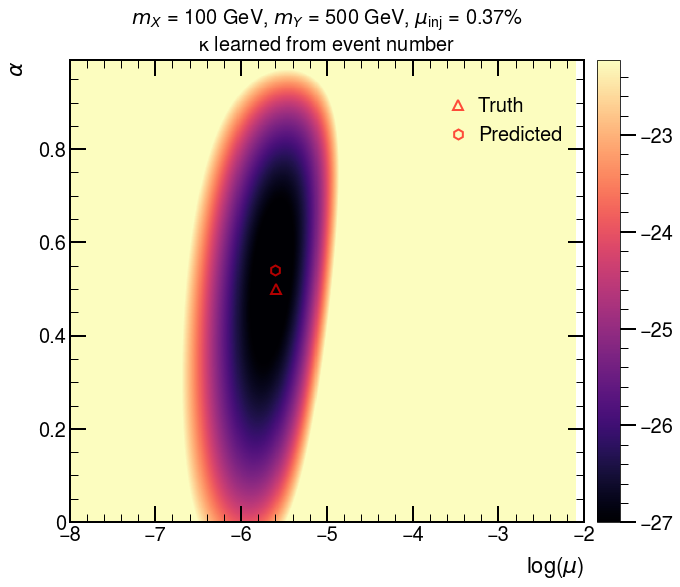

<Figure size 640x480 with 0 Axes>

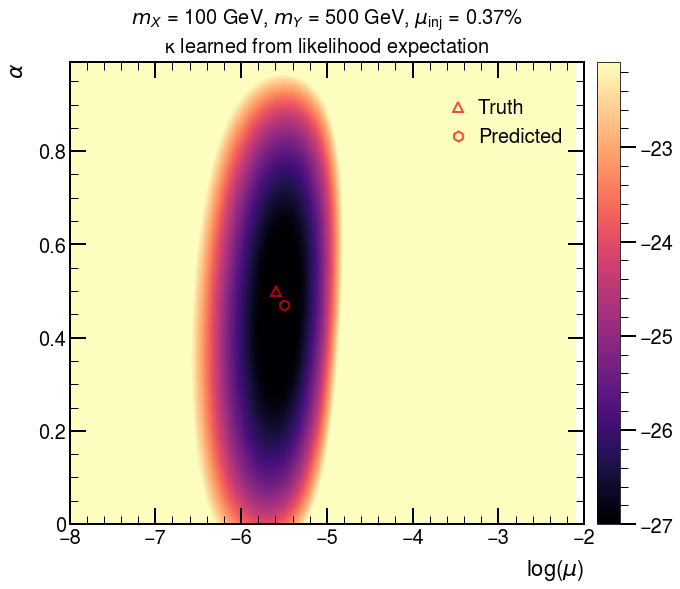

<Figure size 640x480 with 0 Axes>

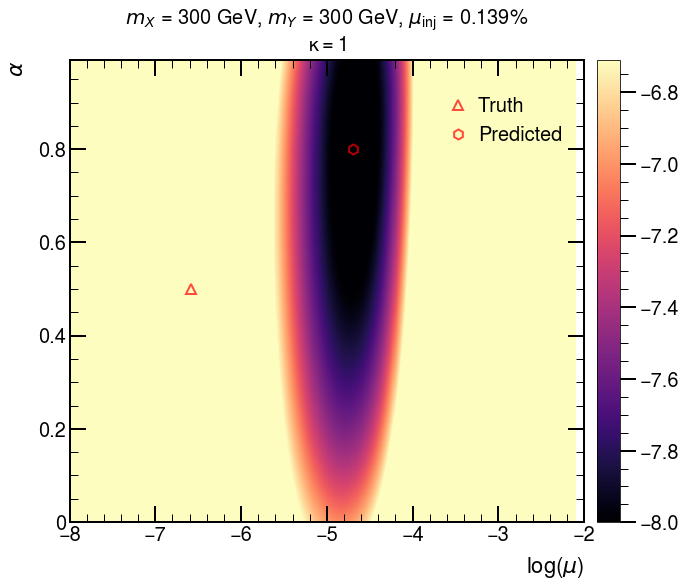

<Figure size 640x480 with 0 Axes>

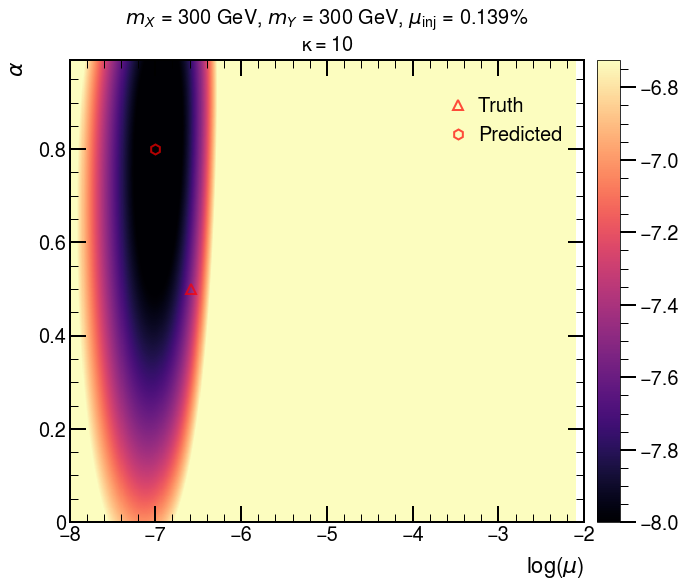

<Figure size 640x480 with 0 Axes>

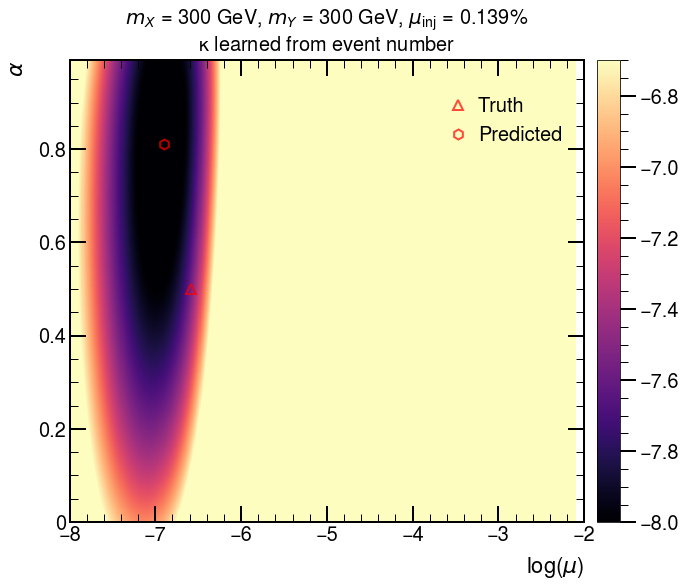

<Figure size 640x480 with 0 Axes>

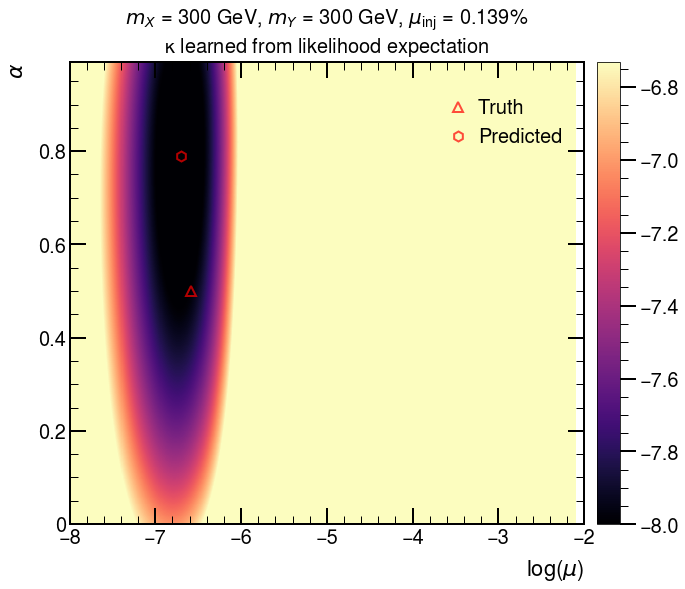

<Figure size 640x480 with 0 Axes>

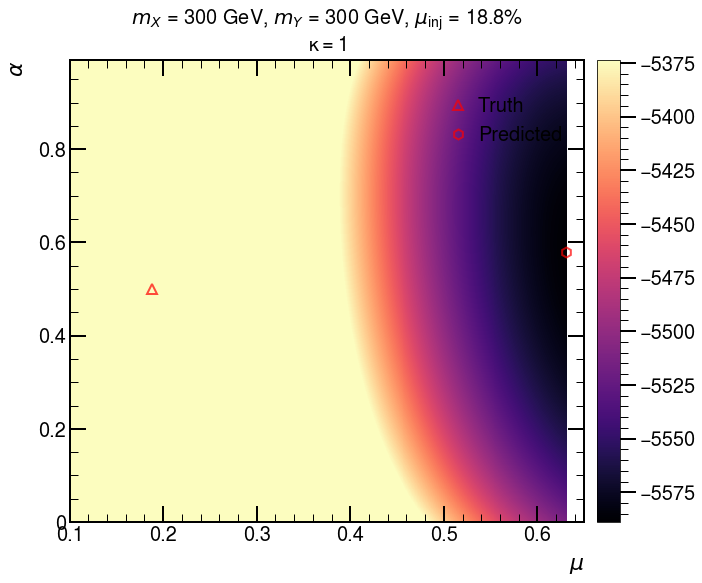

<Figure size 640x480 with 0 Axes>

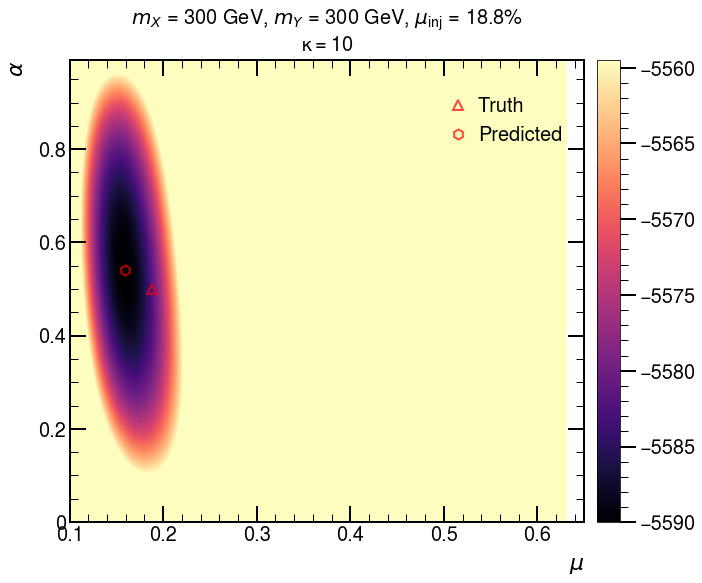

<Figure size 640x480 with 0 Axes>

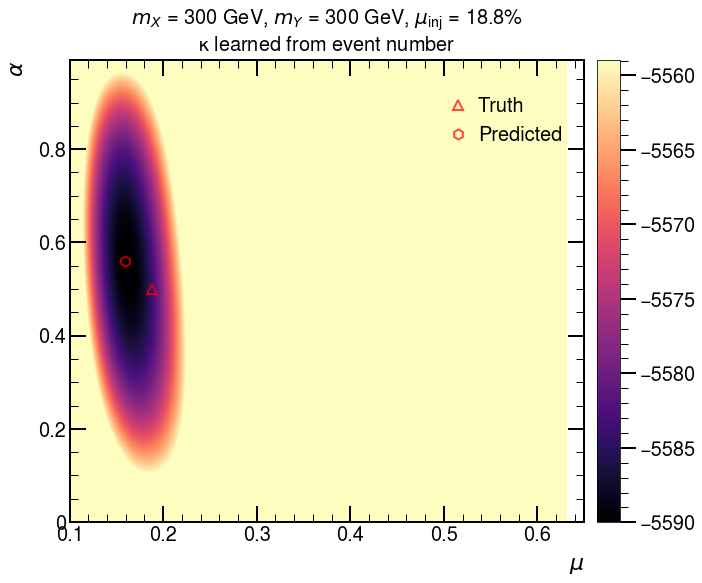

<Figure size 640x480 with 0 Axes>

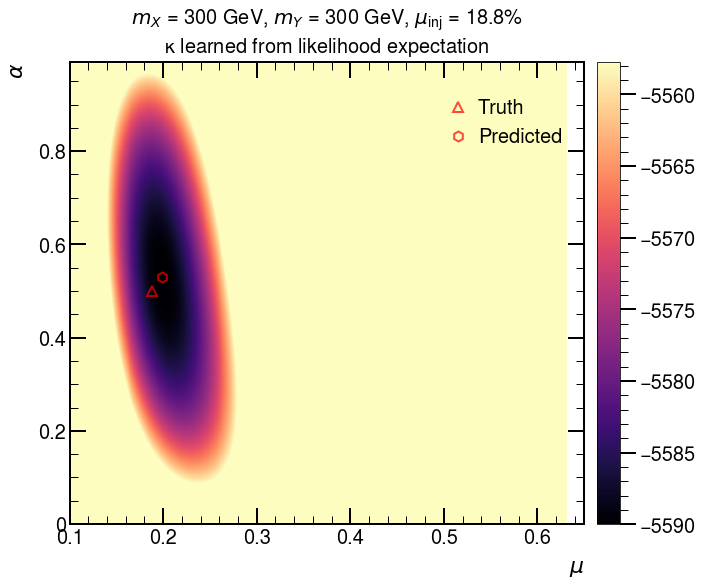

<Figure size 640x480 with 0 Axes>

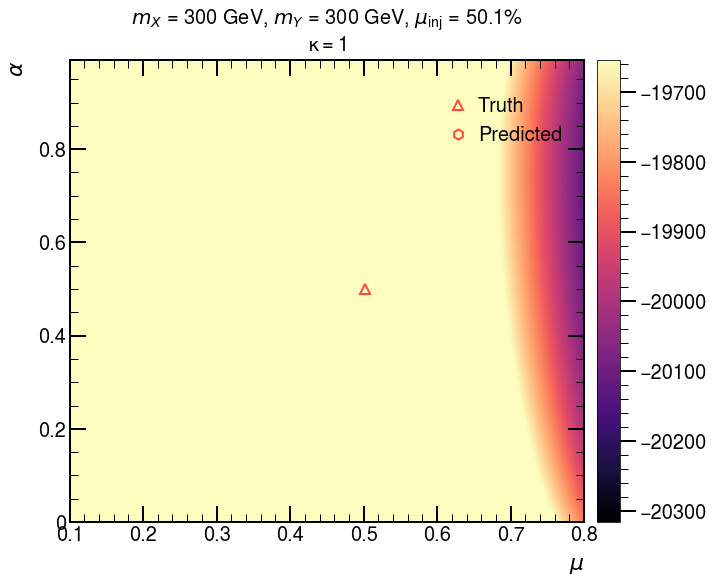

<Figure size 640x480 with 0 Axes>

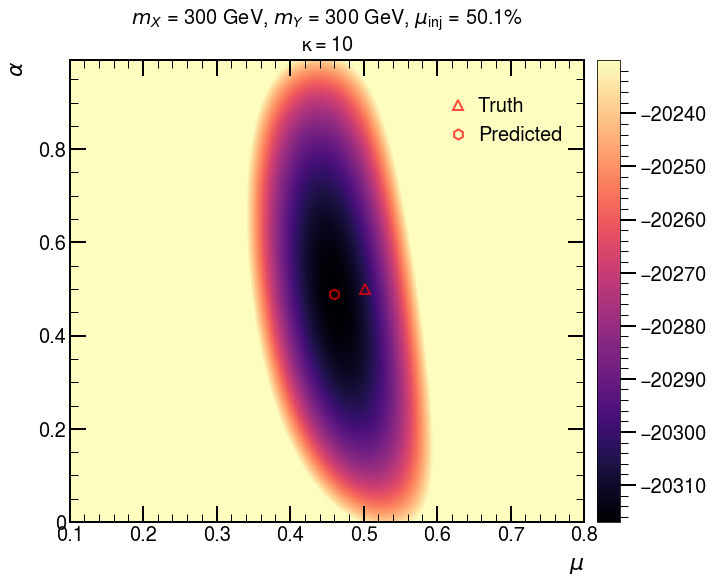

<Figure size 640x480 with 0 Axes>

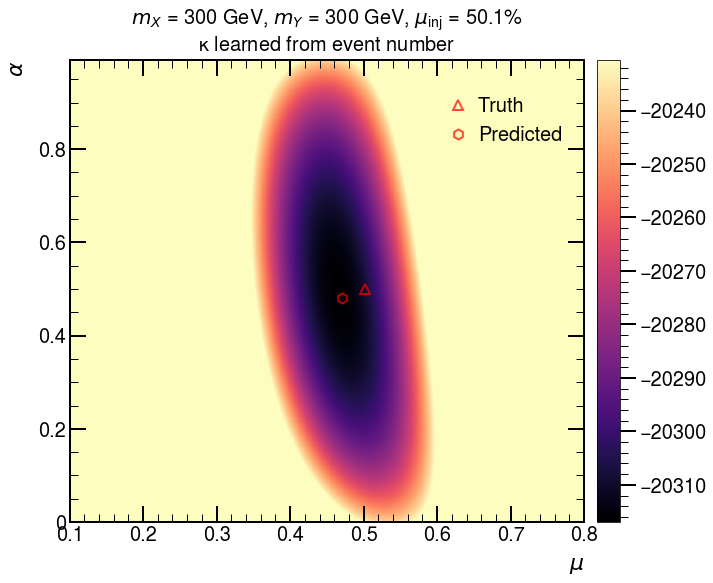

<Figure size 640x480 with 0 Axes>

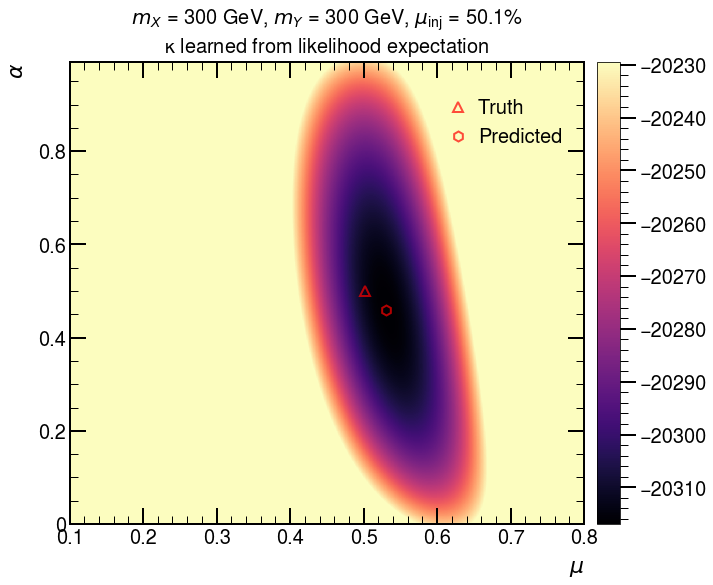

<Figure size 640x480 with 0 Axes>

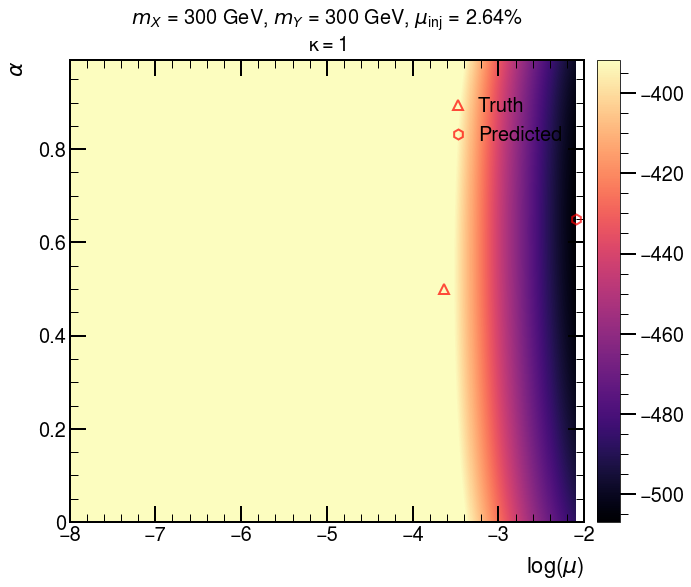

<Figure size 640x480 with 0 Axes>

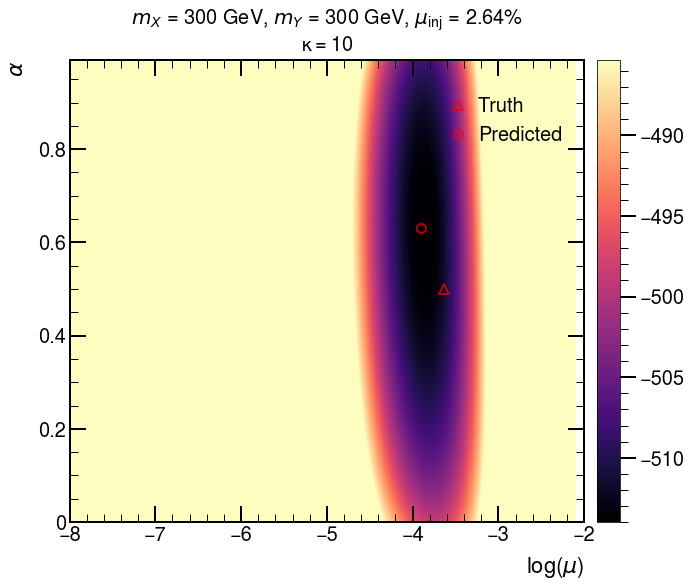

<Figure size 640x480 with 0 Axes>

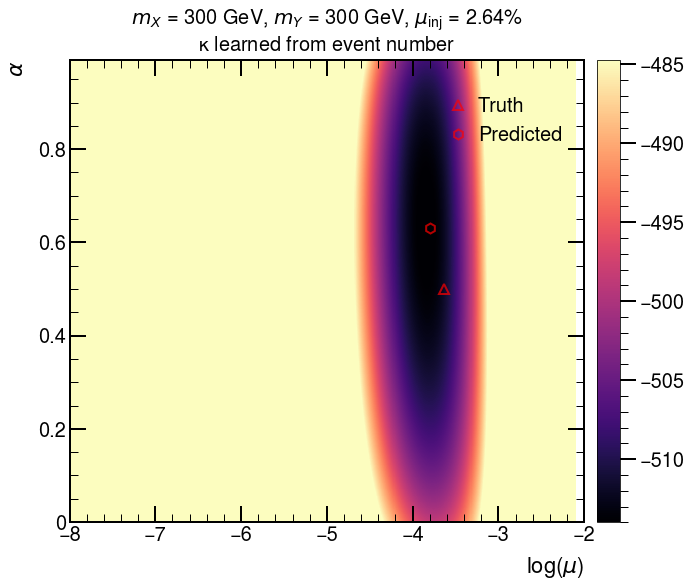

<Figure size 640x480 with 0 Axes>

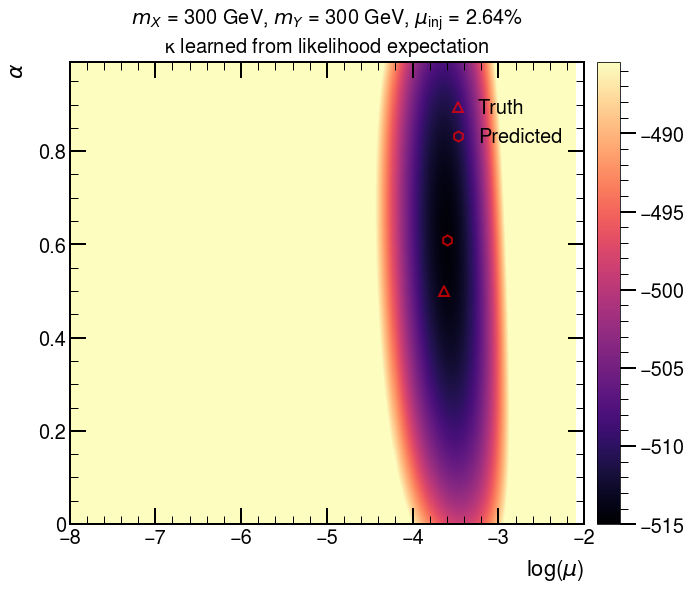

<Figure size 640x480 with 0 Axes>

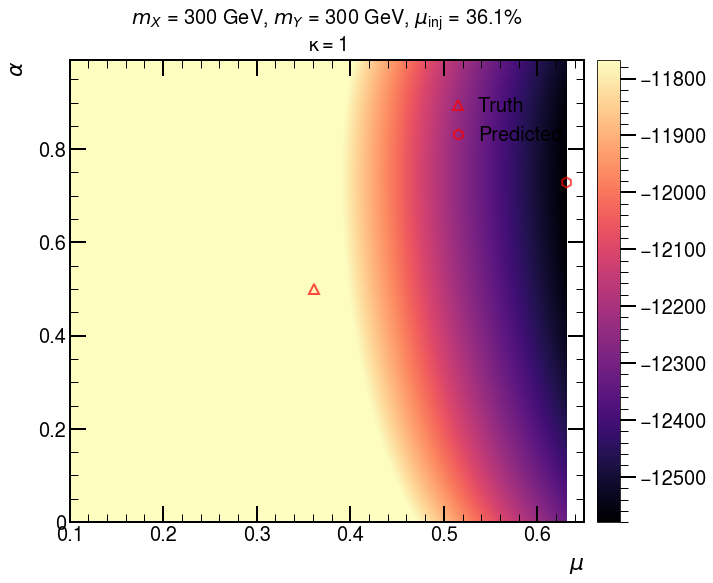

<Figure size 640x480 with 0 Axes>

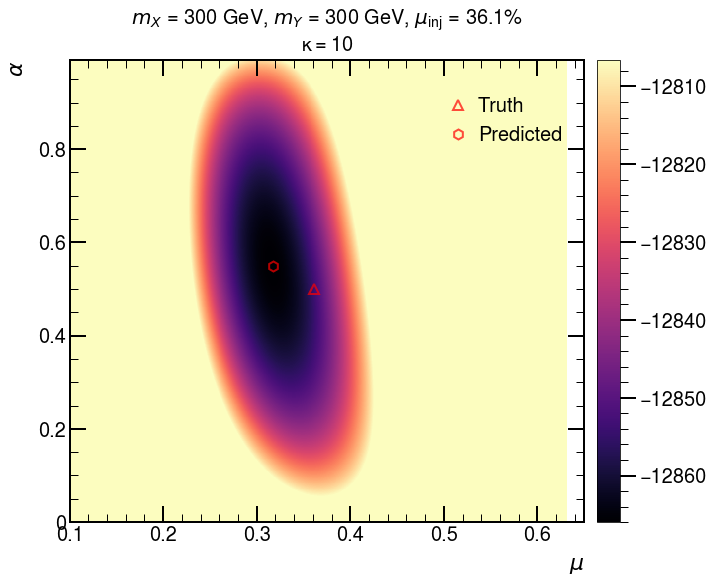

<Figure size 640x480 with 0 Axes>

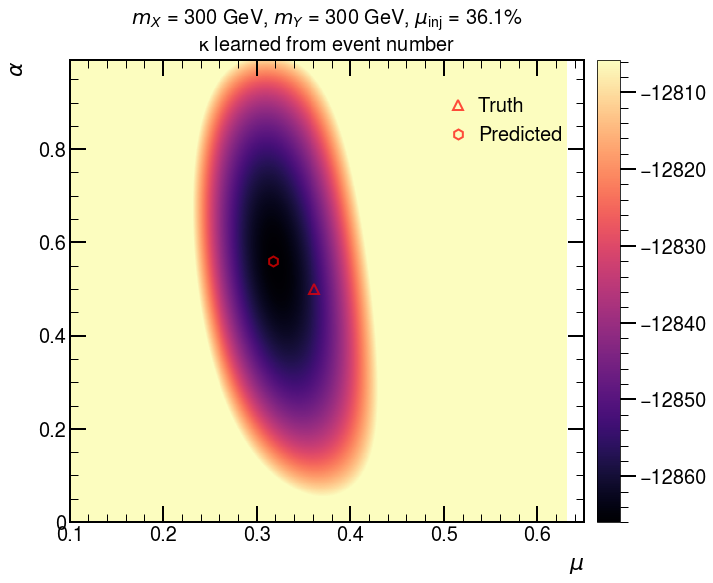

<Figure size 640x480 with 0 Axes>

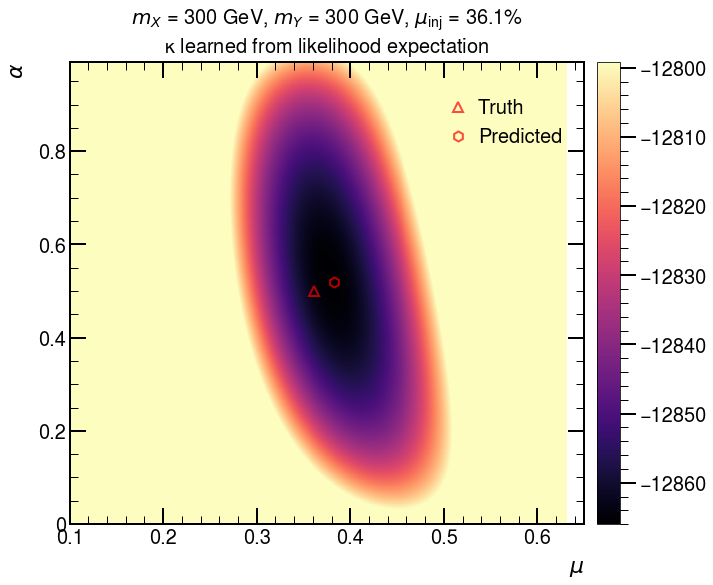

<Figure size 640x480 with 0 Axes>

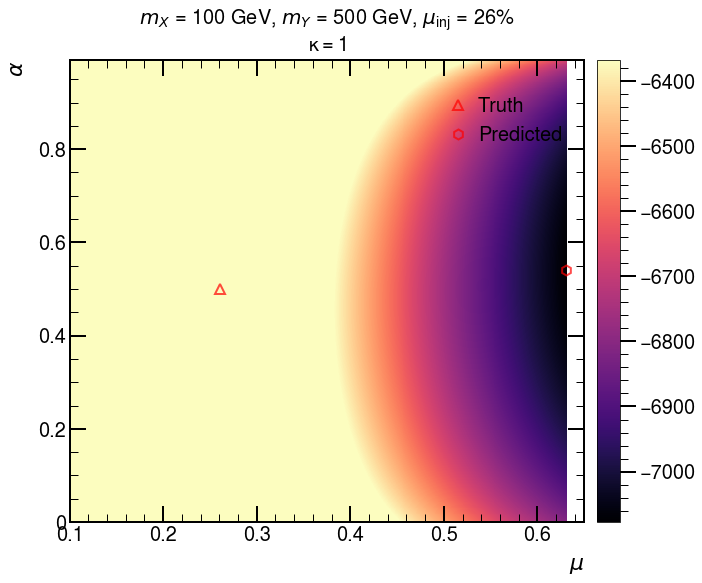

<Figure size 640x480 with 0 Axes>

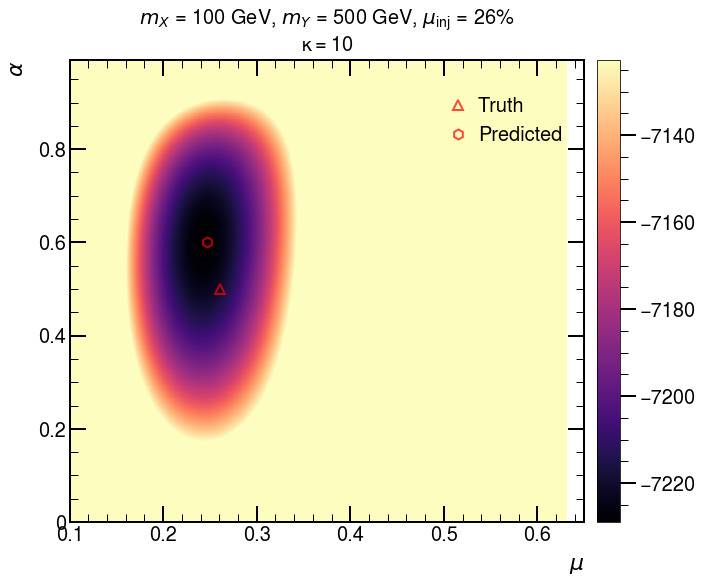

<Figure size 640x480 with 0 Axes>

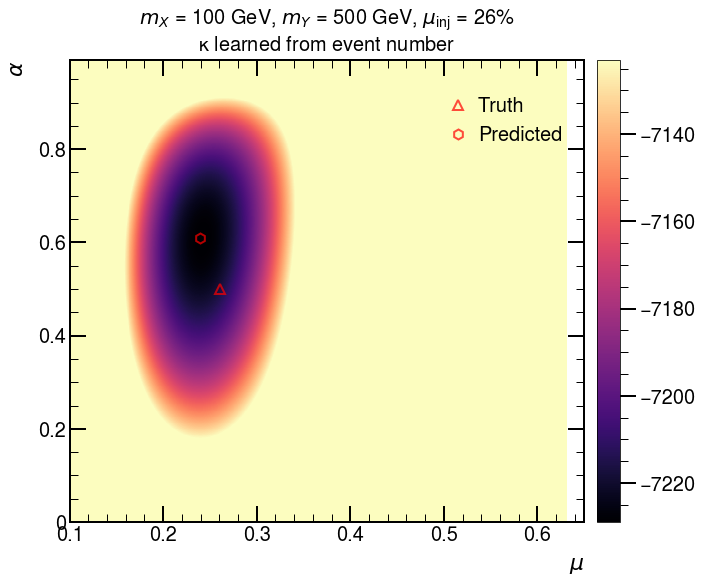

<Figure size 640x480 with 0 Axes>

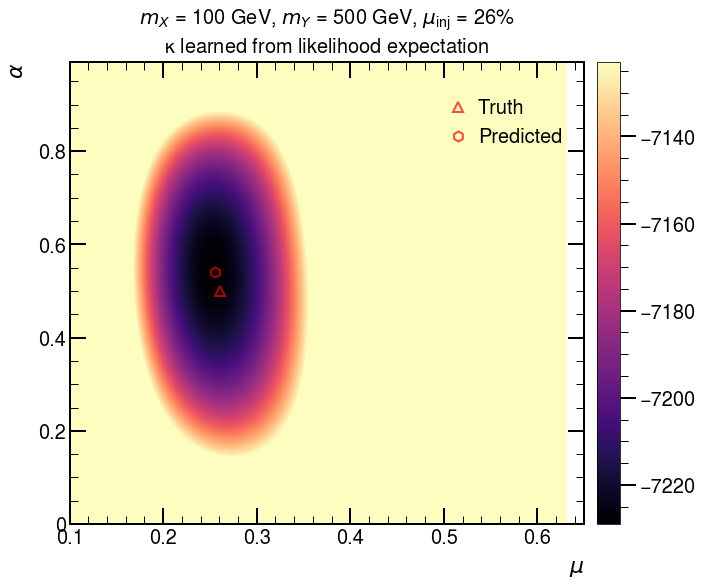

<Figure size 640x480 with 0 Axes>

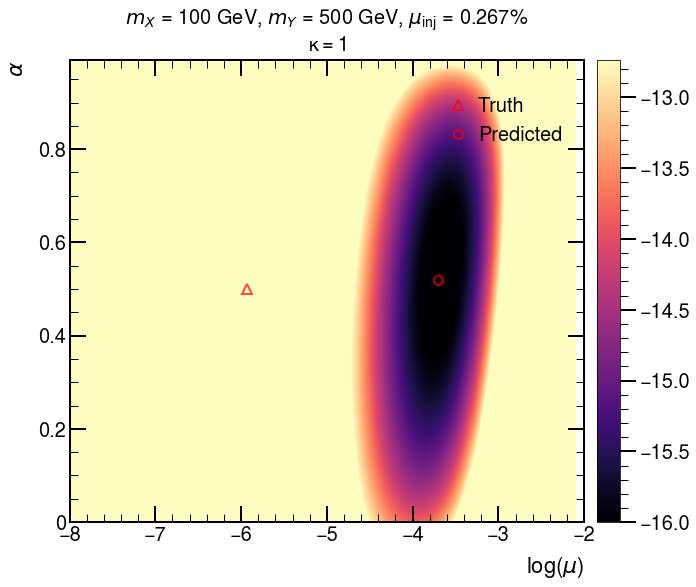

<Figure size 640x480 with 0 Axes>

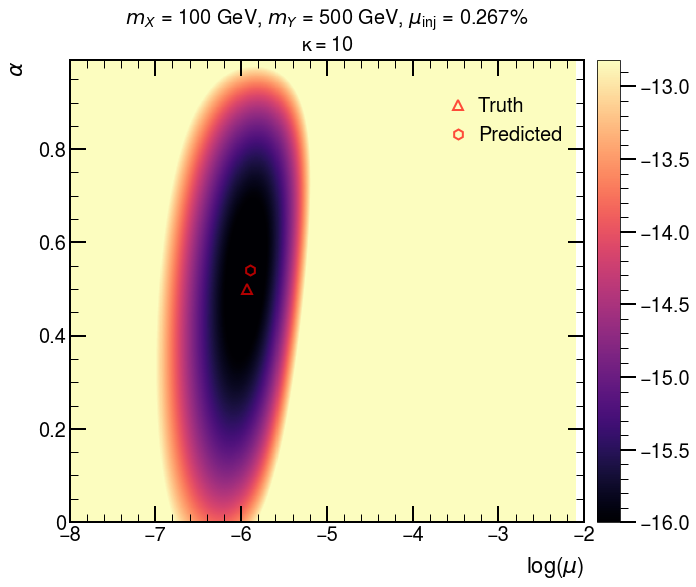

<Figure size 640x480 with 0 Axes>

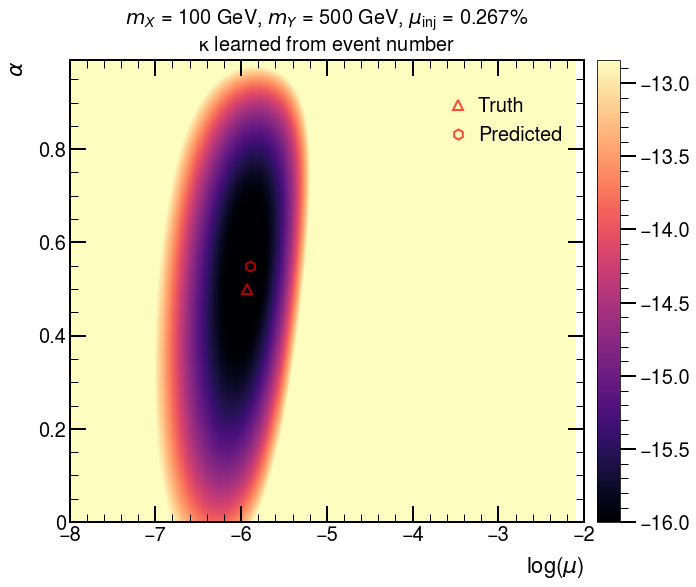

<Figure size 640x480 with 0 Axes>

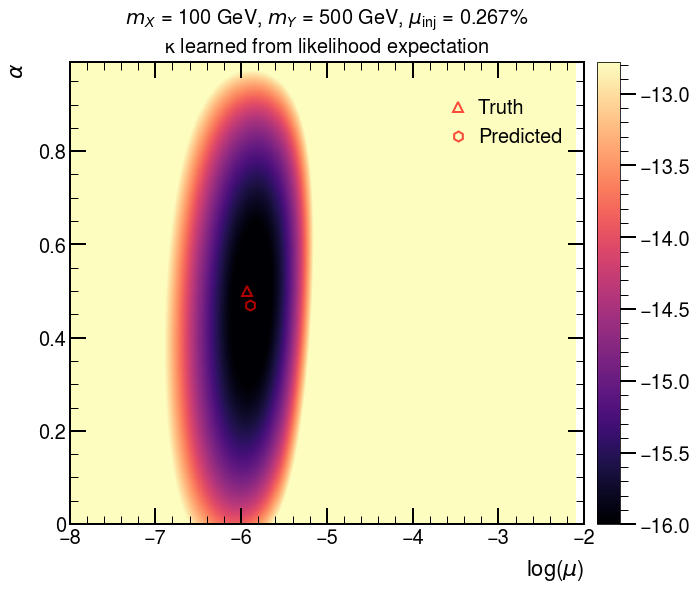

<Figure size 640x480 with 0 Axes>

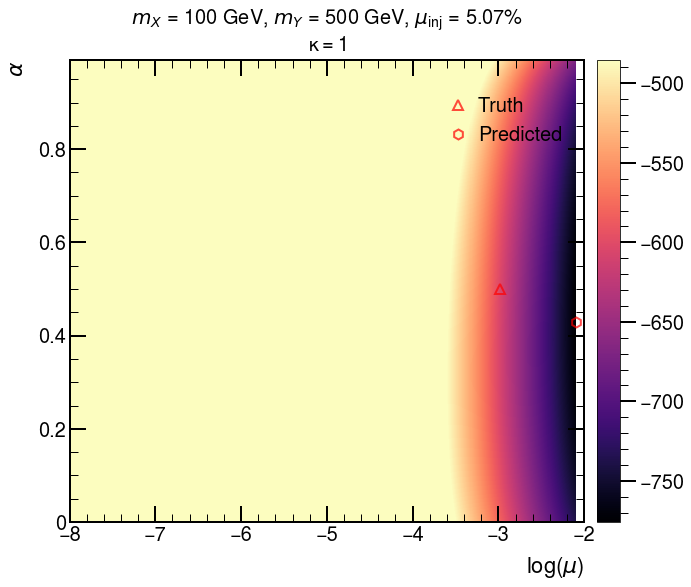

<Figure size 640x480 with 0 Axes>

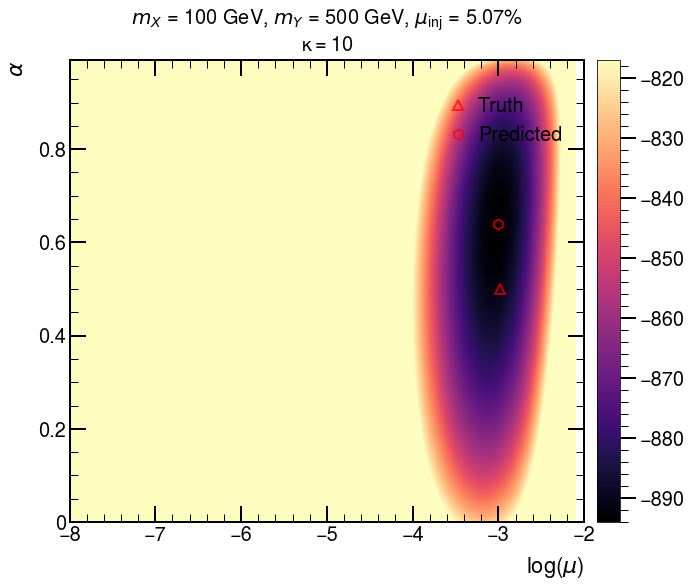

<Figure size 640x480 with 0 Axes>

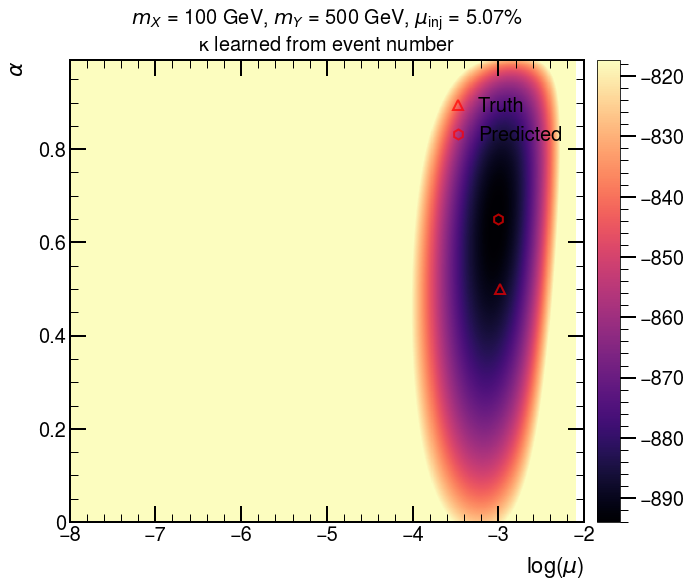

<Figure size 640x480 with 0 Axes>

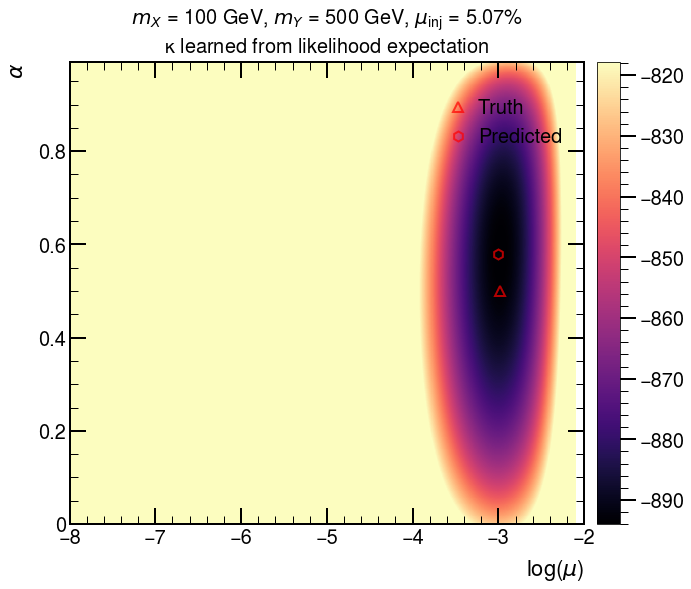

In [5]:
for filename in filenames:
    plot_loss_landscape(filename)

In [ ]:
data = {}
for filename in filenames:
    with open(filename, 'r') as file:
        data = json.load(file)
        pass

In [103]:
dfs = {}
for key, data_i in data.items():
    if key == 'truth':
        continue
    dfs[key] = pd.DataFrame(data_i)
    dfs[key] = dfs[key].sort_values('loss').reset_index(drop=True)

In [104]:
dfs.keys()

dict_keys(['no_kappa', 'uniform_kappa', 'inferred_kappa', 'sampled_kappa'])

In [108]:
dfs['sampled_kappa']

,mu,alpha,loss
0,0.49,0.51,-18249.974311
1,0.49,0.52,-18249.917795
2,0.49,0.50,-18249.841194
3,0.49,0.53,-18249.671484
4,0.49,0.49,-18249.518206
...,...,...,...
7995,0.89,0.95,-13524.302090
7996,0.89,0.96,-13517.517659
7997,0.89,0.97,-13509.101097
7998,0.89,0.98,-13497.854102


<Axes: title={'center': '$\\mathit{m_X}$ = 300 GeV, $\\mathit{m_Y}$ = 300 GeV, $\\mathit{\\mu}_{inj}$ = 0.27%\ntest'}, xlabel='$log(\\mathit{\\mu})$', ylabel='$\\mathit{\\alpha}$'>

<Figure size 640x480 with 0 Axes>

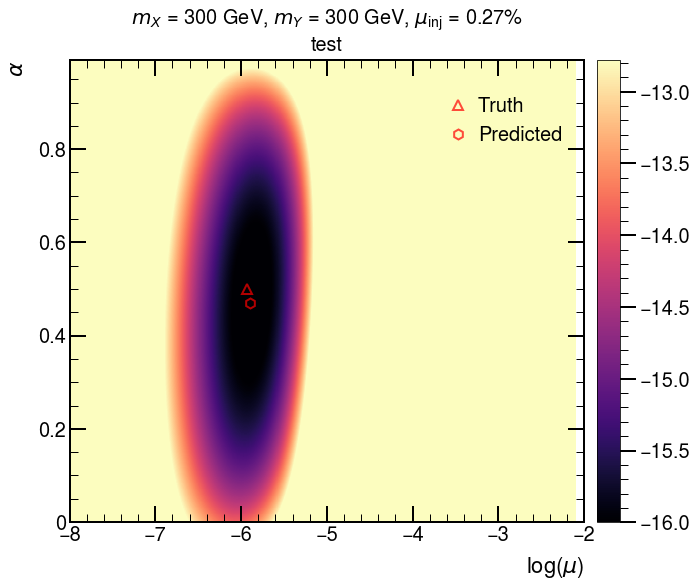

In [101]:
import os
import json
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from quickstats.plots import General2DPlot
styles = {
    'legend': {
        'loc': (0.7, 0.8)
    }
}
config = {
    'num_grid_points': 1000
}
df = dfs['sampled_kappa']
df['mu_log'] = np.log(df['mu'])
plotter = General2DPlot(df, styles=styles, config=config)
zmin = df['loss'].min()
zmax = df['loss'].quantile(0.05)
zmin = round(df['loss'].min())
zmax = df['loss'].quantile(0.24)
#plotter.styles['contour']['colors'] = ["#FF1F5B", "#00CD6C", "#009ADE", "#AF58BA", "#FF6C1E", "#F28522"]
plotter.styles['contour']['linewidths'] = 2
plotter.styles['clabel']['fontsize'] = 12

x_attrib = 'mu_log'
y_attrib = 'alpha'

min_idx = df['loss'].argmin()
marker_styles = {
    'predicted': {
        'linewidth': 0,
        'marker' : 'h',
        'markersize' : 10,
        'color' : 'None',
        'markeredgewidth': 2,
        'markeredgecolor' : 'r',
        'alpha': 0.7
    },
    'truth': {
        'linewidth': 0,
        'marker' : '^',
        'markersize' : 10,  'color' : 'None',
        'markeredgewidth': 2,
        'markeredgecolor' : 'r',
        'alpha': 0.7
    }
}
x_truth = np.log(0.0026688)
y_truth = 0.5
plotter.add_point(x_truth,
                  y_truth,
                  label='Truth',
                  styles=marker_styles['truth'])
plotter.add_point(df[x_attrib].loc[min_idx],
                  df[y_attrib].loc[min_idx],
                  label='Predicted',
                  styles=marker_styles['predicted'])

plotter.draw(x_attrib, y_attrib, 'loss', cmap='magma',
             xlabel=r'$log(\mathit{\mu})$', ylabel=r'$\mathit{\alpha}$',
             zmin=zmin, zmax=zmax, logz=False,
             xmin=-8, xmax=-2,
             draw_colormesh=True,
             #clabel_manual=[[-4.3, 0.38], [-4.5, 0.4], [-4.6, 0.42], [-4.8, 0.45], [-5.4, 0.52]]
             #clabel_manual=contour_manual,
             title=r'$\mathit{m_X}$ = 300 GeV, $\mathit{m_Y}$ = 300 GeV, $\mathit{\mu}_{inj}$ = 0.27%')
#plt.savefig('plots/logloss_landscape_mu_0p003_alpha_0p5_m1_300_m2_300_mu_alpha_scan_colormesh.pdf', bbox_inches='tight')

In [61]:
dfs['sampled_kappa']

,mu,alpha,loss
2547,0.004087,0.47,-27.376947
2546,0.004087,0.46,-27.376050
2548,0.004087,0.48,-27.375136
2545,0.004087,0.45,-27.372461
2445,0.003698,0.45,-27.372384
...,...,...,...
5938,0.122456,0.38,434.008718
5934,0.122456,0.34,434.020273
5937,0.122456,0.37,434.024781
5935,0.122456,0.35,434.030378


In [ ]:
import os
import numpy as np
import matplotlib.pyplot as plt

from quickstats.plots import General1DPlot, TwoPanel1DPlot
from quickstats.extensions import ExtensionDataFrame
from paws.components import ResultLoader

outdir = "outputs"

result_loader = ResultLoader('high_level', decay_modes=['qq', 'qqq'], variables="3,5,6")
# load back the gathered results
result_loader.load_parquet("outputs/summary/dedicated_supervised_high_level_qq_qqq.parquet")
result_loader.load_parquet("outputs/summary/ideal_weakly_high_level_qq_qqq.parquet")
result_loader.load_parquet("outputs/summary/semi_weakly_high_level_qq_qqq.parquet")

In [17]:
from paws.components import ResultLoader

outdir = "/pscratch/sd/c/chlcheng/projects/paws/outputs"

# for more details, checkout help(ResultLoader.__init__)
result_loader = ResultLoader(feature_level="high_level", decay_modes="qq,qqq",
                             variables="3,5,6", outdir=outdir)

In [18]:
df = result_loader.load('semi_weakly',
                        mass_points=[[300, 300], [100, 500]],
                        noise_list=[0, 10], version="v1_kappa_sampled")

[INFO] Reading model output from "/pscratch/sd/c/chlcheng/projects/paws/outputs/train_results/semi_weakly/high_level/qq_qqq/300_300/SR_var_3_5_6_noise_0_v1_kappa_sampled/mu_0p0009747402255566064_alpha_0p5/split_8/trial_3/test_results.json"
[INFO] Reading model output from "/pscratch/sd/c/chlcheng/projects/paws/outputs/train_results/semi_weakly/high_level/qq_qqq/300_300/SR_var_3_5_6_noise_0_v1_kappa_sampled/mu_0p0009747402255566064_alpha_0p5/split_8/trial_14/test_results.json"
[INFO] Reading model output from "/pscratch/sd/c/chlcheng/projects/paws/outputs/train_results/semi_weakly/high_level/qq_qqq/300_300/SR_var_3_5_6_noise_0_v1_kappa_sampled/mu_0p0009747402255566064_alpha_0p5/split_8/trial_0/test_results.json"
[INFO] Reading model output from "/pscratch/sd/c/chlcheng/projects/paws/outputs/train_results/semi_weakly/high_level/qq_qqq/300_300/SR_var_3_5_6_noise_0_v1_kappa_sampled/mu_0p0009747402255566064_alpha_0p5/split_8/trial_15/test_results.json"
[INFO] Reading model output from "/psc

In [19]:
result_loader.merge_trials(topk=10, score_reduce_method='mean', weight_reduce_method='median')
result_loader.decorate_results(['auc', 'log_loss',
                                ('sic_1e3', 'threshold_significance', {"fpr_thres": 1e-3})])

In [20]:
result_loader.save_parquet("/pscratch/sd/c/chlcheng/projects/paws/outputs/summary/semi_weakly_high_level_qq_qqq_fixed_detailed.parquet", detailed=True)
result_loader.save_parquet("/pscratch/sd/c/chlcheng/projects/paws/outputs/summary/semi_weakly_high_level_qq_qqq_fixed.parquet", detailed=False)

[INFO] Saved model results to /pscratch/sd/c/chlcheng/projects/paws/outputs/summary/semi_weakly_high_level_qq_qqq_fixed_detailed.parquet
[INFO] Saved model results to /pscratch/sd/c/chlcheng/projects/paws/outputs/summary/semi_weakly_high_level_qq_qqq_fixed.parquet
